In [ ]:
!pip install jdatetime -q

In [ ]:
from datetime import datetime
from jdatetime import datetime as jdatetime
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from datetime import datetime, timedelta
from dateutil.relativedelta import relativedelta
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

file_path = '/content/Train_drug demand_completed.csv'
Weather_path = '/content/WeatherFrom2019To2023.csv'
df=pd.read_csv(file_path)
weather_df=pd.read_csv(Weather_path)
weather_df['datetime'] = pd.to_datetime(weather_df['datetime'])
WEATHER_API_KEY = "a0c18bad2d2b4868ae44e8cd7727c8cf"
SCALER = MinMaxScaler()

In [ ]:
def Preprocessing_DF(df):
  df['تاریخ مصرف'] = pd.to_datetime(df['تاریخ مصرف'], format='%m/%d/%Y')
  columns_to_drop = ['تخفیفات', 'باز یا بسته بودن داروخانه', 'تعطیلی مدارس', 'تعطیلی هفتگی','کد مشتریان']
  df = df.drop(columns=columns_to_drop, axis=1)
  print("Columns after dropping:", df.columns)
  #simple preprocessings:
  condition = (df['نام بیمارستان'] == 1) & (df['تعداد مصرف'] > 400)
  df.loc[condition, 'تعداد مصرف'] = 100

  condition = (df['نام بیمارستان'] == 4) & (df['تعداد مصرف'] > 20)
  df.loc[condition, 'تعداد مصرف'] = 20

  condition = (df['نام بیمارستان'] == 5) & (df['تعداد مصرف'] > 70)
  df.loc[condition, 'تعداد مصرف'] = 70

  condition = (df['نام بیمارستان'] == 9) & (df['تعداد مصرف'] > 40)
  df.loc[condition, 'تعداد مصرف'] = 40

  condition = (df['نام بیمارستان'] == 10) & (df['تعداد مصرف'] > 100)
  df.loc[condition, 'تعداد مصرف'] = 100

  condition = (df['نام بیمارستان'] == 12) & (df['تعداد مصرف'] > 25)
  df.loc[condition, 'تعداد مصرف'] = 25

  duplicates = df[df.duplicated(['نام بیمارستان', 'تاریخ مصرف','روز هفته'], keep=False)]

  if duplicates.empty:
      print("No duplicates found.")
  else:
      print("Duplicates found. summing duplicates...")

  summed_duplicates = duplicates.groupby(['نام بیمارستان', 'تاریخ مصرف','روز هفته'])['تعداد مصرف'].sum().reset_index()
  df = pd.concat([df[~df.duplicated(['نام بیمارستان', 'تاریخ مصرف','روز هفته'], keep=False)], summed_duplicates], ignore_index=True)
  duplicates = df[df.duplicated(['نام بیمارستان', 'تاریخ مصرف'], keep=False)]

  if duplicates.empty:
      print("No duplicates found.")
  else:
      print("Duplicates found again:")
      print(duplicates)
  date_range = pd.date_range(start='2019-01-01', end='2022-12-31', freq='D')
  multi_index = pd.MultiIndex.from_product([range(1, 13), date_range], names=['نام بیمارستان', 'تاریخ مصرف'])
  df = df.set_index(['نام بیمارستان', 'تاریخ مصرف']).reindex(multi_index, fill_value=0).reset_index()
  df = df.sort_values(by=['تاریخ مصرف', 'نام بیمارستان'])
  return df

In [ ]:
df = Preprocessing_DF(df)

Columns after dropping: Index(['نام بیمارستان', 'روز هفته', 'تاریخ مصرف', 'تعداد مصرف'], dtype='object')
Duplicates found. summing duplicates...
No duplicates found.


In [ ]:
df['تاریخ مصرف'] = pd.to_datetime(df['تاریخ مصرف'])

start_date = datetime(2019, 1, 1)
end_date = datetime(2022, 12, 31)
new_rows = pd.DataFrame(columns=df.columns)

current_date = start_date
while current_date <= end_date:
    date_filter = (df['تاریخ مصرف'] == current_date)
    total_consumption = df[date_filter]['تعداد مصرف'].sum()
    new_row = pd.DataFrame([[13, current_date,None, total_consumption]], columns=df.columns)
    new_rows = pd.concat([new_rows, new_row], ignore_index=True)

    current_date += timedelta(days=1)

df = pd.concat([df, new_rows], ignore_index=True)

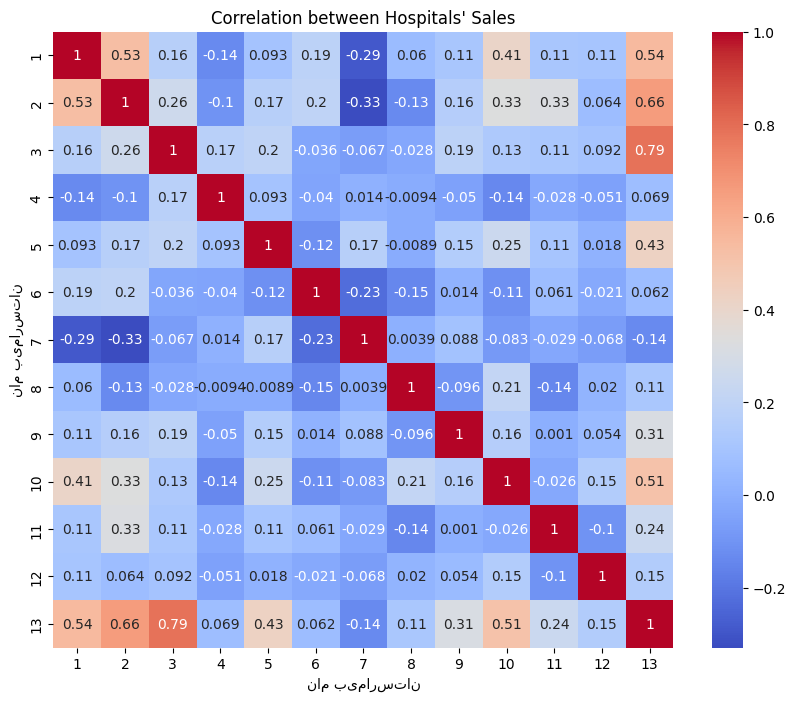

In [ ]:
# Correlation Between Hospitals:
pivot_df = pd.pivot_table(df, values='تعداد مصرف', index='تاریخ مصرف', columns='نام بیمارستان', aggfunc='sum', fill_value=0)
correlation_matrix = pivot_df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Correlation between Hospitals' Sales")
plt.show()

In [ ]:
# Which hospitals have higher (or lower than) 0.2 Correlation with others?
threshold = 0.2
related_hospitals = {}
print(f'Threshold:{threshold}')
for hospital in correlation_matrix.columns:
    positively_related = correlation_matrix[hospital][(correlation_matrix[hospital] > threshold) & (correlation_matrix[hospital] < 1)].index.tolist()
    negatively_related = correlation_matrix[hospital][(correlation_matrix[hospital] < -threshold)].index.tolist()
    related_hospitals[hospital] = {
        "positively_related": positively_related,
        "negatively_related": negatively_related
    }
for hospital, related in related_hospitals.items():
    positively_related = [str(h) for h in related['positively_related']]
    negatively_related = [str(h) for h in related['negatively_related']]

    print(f"{hospital} is positively related to: {', '.join(positively_related)}")
    print(f"{hospital} is negatively related to: {', '.join(negatively_related)}\n")


Threshold:0.2
1 is positively related to: 2, 10, 13
1 is negatively related to: 7

2 is positively related to: 1, 3, 10, 11, 13
2 is negatively related to: 7

3 is positively related to: 2, 13
3 is negatively related to: 

4 is positively related to: 
4 is negatively related to: 

5 is positively related to: 10, 13
5 is negatively related to: 

6 is positively related to: 
6 is negatively related to: 7

7 is positively related to: 
7 is negatively related to: 1, 2, 6

8 is positively related to: 10
8 is negatively related to: 

9 is positively related to: 13
9 is negatively related to: 

10 is positively related to: 1, 2, 5, 8, 13
10 is negatively related to: 

11 is positively related to: 2, 13
11 is negatively related to: 

12 is positively related to: 
12 is negatively related to: 

13 is positively related to: 1, 2, 3, 5, 9, 10, 11
13 is negatively related to: 



In [ ]:
# For each hospital, how many days have each been without sales?
zero_counts = pivot_df.eq(0).sum()
print("Count of zeroes:")
print(zero_counts)

Count of zeroes:
نام بیمارستان
1        1
2       64
3       73
4      575
5       34
6       51
7      793
8      262
9       59
10      15
11     257
12    1277
13       0
dtype: int64


In [ ]:
import requests

# Add some extra features:
from jdatetime import date
def check_school_holidays(row):
    persian_date = date.fromgregorian(day=row['تاریخ مصرف'].day, month=row['تاریخ مصرف'].month, year=row['تاریخ مصرف'].year)
    if (
        (4 <= persian_date.month <= 6) or
        (persian_date.month == 1 and 1 <= persian_date.day <= 14) or
        (row['روز هفته'] in [5, 6])
    ):
        return 1
    else:
        return 0
def check_corona_status(row):
    persian_date = date.fromgregorian(day=row['تاریخ مصرف'].day, month=row['تاریخ مصرف'].month, year=row['تاریخ مصرف'].year)
    if (date(1399, 2, 1) <= persian_date <= date(1399, 3, 31)) or (date(1400, 2, 1) <= persian_date <= date(1400, 5, 31)):
        return 2
    elif (date(1398, 12, 1) <= persian_date <= date(1400, 10, 1)):
        return 1
    else:
        return 0
def check_winter_season(row):
    persian_date = date.fromgregorian(day=row['تاریخ مصرف'].day, month=row['تاریخ مصرف'].month, year=row['تاریخ مصرف'].year)

    if persian_date.month in [4, 5]:
        return 0
    elif persian_date.month in [3, 6]:
        return 1
    elif persian_date.month in [2, 7, 8]:
        return 2
    elif persian_date.month in [1, 12, 9]:
        return 3
    elif persian_date.month in [10, 11]:
        return 4
    else:
        return -1  # Handle any unexpected cases
def merge_weather_data(row):
    date_to_match = row['تاریخ مصرف'].date()
    matching_row = weather_df[weather_df['datetime'].dt.date == date_to_match]

    if not matching_row.empty:
        return ','.join(map(str, matching_row.iloc[0][weather_df.columns].values))
    else:
        print(f"We don't have date = {date_to_match.strftime('%Y-%m-%d')} in weather_df.")
        global WEATHER_API_KEY
        url = "https://api.weatherbit.io/v2.0/history/daily"
        start_date = date_to_match.strftime('%Y-%m-%d')
        end_date = (date_to_match + timedelta(days=1)).strftime('%Y-%m-%d')
        params = {
            "lat": 34.7983,
            "lon": 48.5148,
            "start_date": start_date,
            "end_date": end_date,
            "key": WEATHER_API_KEY
        }
        response = requests.get(url, params=params)
        data = response.json()

        data_list = data.get('data', [])
        if not data_list:
            print(f"Error in downloading weather info in date = {date_to_match.strftime('%Y-%m-%d')}: {response}")
            raise ValueError(response)

        cache_df = pd.json_normalize(data_list)
        values_str = ','.join(map(str, cache_df.iloc[0][weather_df.columns].values))
        print(f"Weather data for {date_to_match.strftime('%Y-%m-%d')} updated with new information.")
        return values_str

def day_of_year_feature(row):
    persian_date = date.fromgregorian(day=row['تاریخ مصرف'].day, month=row['تاریخ مصرف'].month, year=row['تاریخ مصرف'].year)
    return (persian_date.toordinal() - date(persian_date.year, 1, 1).toordinal() + 1)

def day_of_Month_feature(row):
    persian_date = date.fromgregorian(day=row['تاریخ مصرف'].day, month=row['تاریخ مصرف'].month, year=row['تاریخ مصرف'].year)
    return (persian_date.day)


In [ ]:
df['روز هفته'] = (df['تاریخ مصرف'].dt.dayofweek + 2) % 7
df['تعطیلات مدارس'] = df.apply(check_school_holidays, axis=1)
df['کرونا'] = df.apply(check_corona_status, axis=1)
df['فصل سرما'] = df.apply(check_winter_season, axis=1)
df['روز سال'] = df.apply(day_of_year_feature, axis=1)
df['روز ماه'] = df.apply(day_of_Month_feature, axis=1)

In [ ]:
df[['datetime','max_temp', 'min_temp', 'temp', 'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']] = df.apply(merge_weather_data, axis=1).str.split(',', expand=True)
df = df.drop('datetime', axis=1)

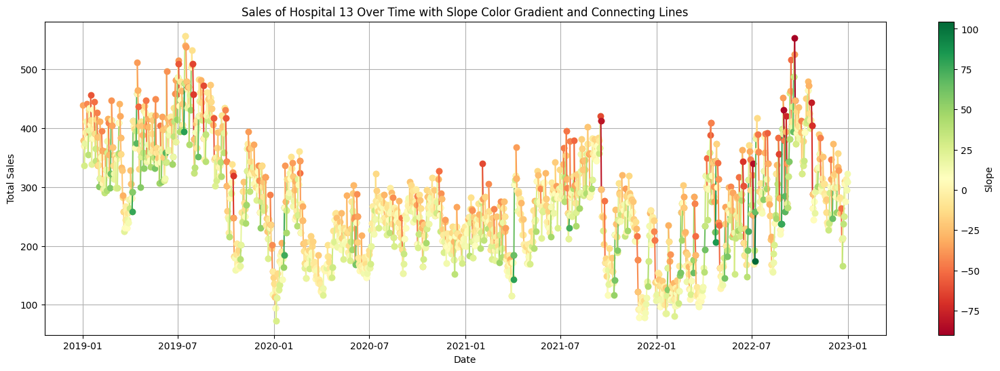

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
hospital_13_data = df[df['نام بیمارستان'] == 13]
hospital_13_data = hospital_13_data.sort_values(by='تاریخ مصرف')
slope = np.gradient(hospital_13_data['تعداد مصرف'])
plt.figure(figsize=(20, 6))
sc = plt.scatter(hospital_13_data['تاریخ مصرف'], hospital_13_data['تعداد مصرف'], c=slope, cmap='RdYlGn', marker='o', s=10)
plt.colorbar(sc, label='Slope')
for i in range(len(hospital_13_data) - 1):
    plt.plot(hospital_13_data['تاریخ مصرف'].iloc[i:i+2], hospital_13_data['تعداد مصرف'].iloc[i:i+2], color=sc.to_rgba(slope[i+1]), marker='o', linestyle='-')

plt.title('Sales of Hospital 13 Over Time with Slope Color Gradient and Connecting Lines')
plt.xlabel('Date')
plt.ylabel('Total Sales')
plt.grid(True)
plt.show()


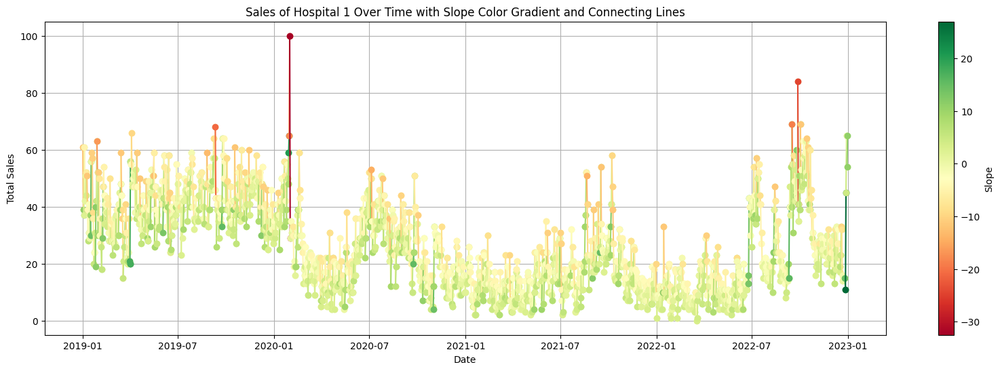

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
hospital_13_data = df[df['نام بیمارستان'] == 1]
hospital_13_data = hospital_13_data.sort_values(by='تاریخ مصرف')
slope = np.gradient(hospital_13_data['تعداد مصرف'])
plt.figure(figsize=(20, 6))
sc = plt.scatter(hospital_13_data['تاریخ مصرف'], hospital_13_data['تعداد مصرف'], c=slope, cmap='RdYlGn', marker='o', s=10)
plt.colorbar(sc, label='Slope')
for i in range(len(hospital_13_data) - 1):
    plt.plot(hospital_13_data['تاریخ مصرف'].iloc[i:i+2], hospital_13_data['تعداد مصرف'].iloc[i:i+2], color=sc.to_rgba(slope[i+1]), marker='o', linestyle='-')

plt.title('Sales of Hospital 1 Over Time with Slope Color Gradient and Connecting Lines')
plt.xlabel('Date')
plt.ylabel('Total Sales')
plt.grid(True)
plt.show()


In [ ]:
columns_to_scale = ['روز هفته','تعطیلات مدارس','کرونا','فصل سرما','روز سال','روز ماه','max_temp', 'min_temp', 'temp',
                    'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']

data_to_scale = df[columns_to_scale]

scaled_data = SCALER.fit_transform(data_to_scale)

df[columns_to_scale] = scaled_data

In [ ]:
df

,نام بیمارستان,تاریخ مصرف,روز هفته,تعداد مصرف,تعطیلات مدارس,کرونا,فصل سرما,روز سال,روز ماه,max_temp,min_temp,temp,rh,precip,wind_spd,solar_rad,snow
0,1,2019-01-01,0.500000,61.0,0.0,0.0,1.0,0.783562,0.333333,0.354167,0.333333,0.332558,0.623596,0.0,0.211268,0.250712,0.0
1,2,2019-01-01,0.500000,72.0,0.0,0.0,1.0,0.783562,0.333333,0.354167,0.333333,0.332558,0.623596,0.0,0.211268,0.250712,0.0
2,3,2019-01-01,0.500000,156.0,0.0,0.0,1.0,0.783562,0.333333,0.354167,0.333333,0.332558,0.623596,0.0,0.211268,0.250712,0.0
3,4,2019-01-01,0.500000,0.0,0.0,0.0,1.0,0.783562,0.333333,0.354167,0.333333,0.332558,0.623596,0.0,0.211268,0.250712,0.0
4,5,2019-01-01,0.500000,31.0,0.0,0.0,1.0,0.783562,0.333333,0.354167,0.333333,0.332558,0.623596,0.0,0.211268,0.250712,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18988,13,2022-12-27,0.500000,276.0,0.0,0.0,1.0,0.769863,0.166667,0.208333,0.241379,0.232558,0.866292,0.0,0.140845,0.307692,0.0
18989,13,2022-12-28,0.666667,313.0,0.0,0.0,1.0,0.772603,0.200000,0.229167,0.287356,0.248837,0.792135,0.0,0.169014,0.336182,0.0
18990,13,2022-12-29,0.833333,295.0,1.0,0.0,1.0,0.775342,0.233333,0.270833,0.218391,0.218605,0.758427,0.0,0.140845,0.336182,0.0
18991,13,2022-12-30,1.000000,309.0,1.0,0.0,1.0,0.778082,0.266667,0.291667,0.241379,0.241860,0.768539,0.0,0.140845,0.339031,0.0


In [ ]:
# Models are gonna learn from main_df, which is a copy of preprocessed df:
main_df = df.copy()

In [ ]:
main_df.columns

Index(['نام بیمارستان', 'تاریخ مصرف', 'روز هفته', 'تعداد مصرف',
       'تعطیلات مدارس', 'کرونا', 'فصل سرما', 'روز سال', 'روز ماه', 'max_temp',
       'min_temp', 'temp', 'rh', 'precip', 'wind_spd', 'solar_rad', 'snow'],
      dtype='object')

In [ ]:
def insertIntoMain_DF(Date,HospitalName,recursivePrecition):
  # Used for inserting new predictions into main_df.
  global main_df
  new_row = {'نام بیمارستان': HospitalName, 'تاریخ مصرف': Date, 'تعداد مصرف':recursivePrecition}
  main_df.loc[len(main_df)] = new_row
  main_df.loc[len(main_df) - 1,'روز هفته'] = (main_df.loc[len(main_df) - 1, 'تاریخ مصرف'].dayofweek + 2) % 7
  main_df.loc[len(main_df) - 1, 'تعطیلات مدارس'] = check_school_holidays(main_df.loc[len(main_df) - 1])
  main_df.loc[len(main_df) - 1, 'کرونا'] = check_corona_status(main_df.loc[len(main_df) - 1])
  main_df.loc[len(main_df) - 1, 'فصل سرما'] = check_winter_season(main_df.loc[len(main_df) - 1])
  main_df.loc[len(main_df) - 1, 'روز سال'] = day_of_year_feature(main_df.loc[len(main_df) - 1])
  main_df.loc[len(main_df) - 1, 'روز ماه'] = day_of_Month_feature(main_df.loc[len(main_df) - 1])

  try:
    main_df.loc[len(main_df) - 1,['datetime', 'max_temp', 'min_temp', 'temp', 'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']] = merge_weather_data(main_df.loc[len(main_df) - 1]).split(',')
  except:
    main_df.loc[len(main_df) - 1,['datetime', 'max_temp', 'min_temp', 'temp', 'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']] = merge_weather_data(main_df.loc[len(main_df) - 1]).str.split(',', expand=True)

  columns_to_scale = ['روز هفته','تعطیلات مدارس','کرونا','فصل سرما','روز سال','روز ماه','max_temp', 'min_temp', 'temp',
                    'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']

  test_data_to_scale = main_df[columns_to_scale]
  scaled_test_data = SCALER.transform(test_data_to_scale)
  main_df[columns_to_scale] = scaled_test_data


In [ ]:
def thisYearDF(labelDate, HospitalName, seqSize=30, dropDate = True, ForModel_1_4 = False):
    # Returns a Sequence of (seqSize) that are close to (labelDate) for (HospitalName).
    if labelDate <= pd.to_datetime('2018-12-31') + relativedelta(days=seqSize):
        print(f"GolyWarning: The provided labelDate for thisYearDF() is not suitable and its receiving 2018 data as NaN. ({labelDate})")
    labelDate = labelDate - relativedelta(days=1)
    custom_df = pd.DataFrame({
        'نام بیمارستان': [HospitalName] * seqSize,
        'روز هفته': np.nan,
        'تاریخ مصرف': pd.date_range(end=labelDate, periods=seqSize),
        'تعداد مصرف': np.nan,
        'تعطیلات مدارس': np.nan,
        'کرونا': np.nan,
        'فصل سرما': np.nan
    })
    custom_df = custom_df.merge(main_df[['نام بیمارستان','روز هفته', 'تاریخ مصرف', 'تعداد مصرف','تعطیلات مدارس','کرونا','فصل سرما']], on=['نام بیمارستان', 'تاریخ مصرف'], how='left')
    custom_df = custom_df.drop('تعداد مصرف_x', axis=1)
    custom_df = custom_df.drop('روز هفته_x', axis=1)
    custom_df = custom_df.drop('تعطیلات مدارس_x', axis=1)
    custom_df = custom_df.drop('کرونا_x', axis=1)
    custom_df = custom_df.drop('فصل سرما_x', axis=1)

    custom_df = custom_df.rename(columns={'تعطیلات مدارس_y': 'تعطیلات مدارس'})
    custom_df = custom_df.rename(columns={'کرونا_y': 'کرونا'})
    custom_df = custom_df.rename(columns={'فصل سرما_y': 'فصل سرما'})
    custom_df = custom_df.rename(columns={'تعداد مصرف_y': 'تعداد مصرف'})
    custom_df = custom_df.rename(columns={'روز هفته_y': 'روز هفته'})

    custom_df.sort_values(by='تاریخ مصرف', inplace=True)
    this_year_sequence = custom_df.tail(seqSize)

    this_year_sequence['روز هفته'] = (this_year_sequence['تاریخ مصرف'].dt.dayofweek + 2) % 7
    this_year_sequence['تعطیلات مدارس'] = this_year_sequence.apply(check_school_holidays, axis=1)
    this_year_sequence['کرونا'] = this_year_sequence.apply(check_corona_status, axis=1)
    this_year_sequence['فصل سرما'] = this_year_sequence.apply(check_winter_season, axis=1)
    this_year_sequence['روز سال'] = this_year_sequence.apply(day_of_year_feature, axis=1)
    this_year_sequence['روز ماه'] = this_year_sequence.apply(day_of_Month_feature, axis=1)

    this_year_sequence[['datetime','max_temp', 'min_temp', 'temp', 'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']] = this_year_sequence.apply(merge_weather_data, axis=1).str.split(',', expand=True)

    #SCALAR:
    columns_to_scale = ['روز هفته','تعطیلات مدارس','کرونا','فصل سرما','روز سال','روز ماه','max_temp', 'min_temp', 'temp',
                    'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']
    test_data_to_scale = this_year_sequence[columns_to_scale]
    scaled_test_data = SCALER.transform(test_data_to_scale)
    this_year_sequence[columns_to_scale] = scaled_test_data

    if dropDate: this_year_sequence = this_year_sequence.drop('تاریخ مصرف', axis=1)
    if dropDate: this_year_sequence = this_year_sequence.drop('نام بیمارستان', axis=1)
    if dropDate:
      desired_order = ['تعداد مصرف','روز هفته','تعطیلات مدارس','کرونا','فصل سرما','روز سال','روز ماه','max_temp', 'min_temp', 'temp',
                    'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']
    else: desired_order = ['نام بیمارستان','تاریخ مصرف','تعداد مصرف','روز هفته','تعطیلات مدارس','کرونا','فصل سرما','روز سال','روز ماه',
                           'max_temp', 'min_temp', 'temp','rh', 'precip', 'wind_spd', 'solar_rad', 'snow']
    #return this_year_sequence
    Final = this_year_sequence[desired_order]

    return Final


In [ ]:
test = thisYearDF(datetime(2023,1,15), 1, seqSize=30, dropDate = True, ForModel_1_4 = False)

In [ ]:
test #ThisYearDF should generate NaN for (تاریخ مصرف) for dates that are not in main_df without any problems.

,تعداد مصرف,روز هفته,تعطیلات مدارس,کرونا,فصل سرما,روز سال,روز ماه,max_temp,min_temp,temp,rh,precip,wind_spd,solar_rad,snow
0,17.0,1.000000,1.0,0.0,0.75,0.739726,0.800000,0.354167,0.402299,0.381395,0.893258,0.129091,0.098592,0.284900,0.000000
1,19.0,0.000000,0.0,0.0,0.75,0.742466,0.833333,0.375000,0.356322,0.358140,0.871910,0.000000,0.126761,0.293447,0.000000
2,23.0,0.166667,0.0,0.0,0.75,0.745205,0.866667,0.416667,0.379310,0.360465,0.850562,0.000000,0.140845,0.330484,0.000000
3,33.0,0.333333,0.0,0.0,0.75,0.747945,0.900000,0.375000,0.287356,0.316279,0.776404,0.000000,0.126761,0.333333,0.000000
4,32.0,0.500000,0.0,0.0,0.75,0.750685,0.933333,0.375000,0.218391,0.281395,0.788764,0.000000,0.140845,0.333333,0.000000
5,14.0,0.666667,0.0,0.0,0.75,0.753425,0.966667,0.333333,0.287356,0.269767,0.876404,0.000000,0.140845,0.304843,0.000000
6,16.0,0.833333,1.0,0.0,1.00,0.756164,0.000000,0.291667,0.264368,0.267442,0.931461,0.034545,0.140845,0.196581,0.085448
7,15.0,1.000000,1.0,0.0,1.00,0.758904,0.033333,0.333333,0.402299,0.351163,0.896629,0.072727,0.239437,0.190883,0.069776
8,15.0,0.000000,0.0,0.0,1.00,0.761644,0.066667,0.229167,0.402299,0.304651,1.000000,0.281818,0.422535,0.025641,0.795896
9,15.0,0.166667,0.0,0.0,1.00,0.764384,0.100000,0.291667,0.379310,0.304651,0.973034,0.070909,0.154930,0.239316,0.197015


In [ ]:
def lastYearDF(labelDate, HospitalName, seqSize=30):
    # Same function like thisYearDF, but for last year, without considering NaNs. When we use this function we make sure this data exists.
    last_year_df = main_df[(main_df['نام بیمارستان'] == HospitalName) & (main_df['تاریخ مصرف'] <= labelDate - pd.DateOffset(years=1))]
    last_year_df = last_year_df.sort_values(by='تاریخ مصرف').copy()
    last_year_sequence = last_year_df.tail(seqSize)
    last_year_sequence = last_year_sequence.drop('تاریخ مصرف', axis=1)
    last_year_sequence = last_year_sequence.drop('نام بیمارستان', axis=1)
    if len(last_year_sequence) != seqSize:
        print(f"GolyWarning: LastYear does not exists in main_df for labelDate={labelDate}, Hospital={HospitalName}.")
    desired_order = ['تعداد مصرف','روز هفته','تعطیلات مدارس','کرونا','فصل سرما','روز سال','روز ماه','max_temp', 'min_temp', 'temp',
                    'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']
    Final = last_year_sequence[desired_order]
    return Final

In [ ]:
def generateANumber(labelDate, HospitalName, daysAwayFromLabel):
    # Simply find the number of sales on day (labelDate - daysAwayFromLabel)
    hospital_df = main_df[main_df['نام بیمارستان'] == HospitalName]
    last_year_date = labelDate - relativedelta(days=daysAwayFromLabel)
    last_year_df = hospital_df[
        (hospital_df['تاریخ مصرف'].dt.day == last_year_date.day) &
        (hospital_df['تاریخ مصرف'].dt.month == last_year_date.month) &
        (hospital_df['تاریخ مصرف'].dt.year == last_year_date.year)
    ]
    if last_year_df.empty:
        print(f'GolyWarning: returning -1 for date = {last_year_date} from generateANumber')
        return -1

    last_year_label = last_year_df['تعداد مصرف'].sum()
    return last_year_label

In [ ]:
def lastYearLabel(labelDate, HospitalName):
    hospital_df = main_df[main_df['نام بیمارستان'] == HospitalName]

    last_year_date = labelDate - relativedelta(years=1)
    last_year_df = hospital_df[
        (hospital_df['تاریخ مصرف'].dt.day == last_year_date.day) &
        (hospital_df['تاریخ مصرف'].dt.month == last_year_date.month) &
        (hospital_df['تاریخ مصرف'].dt.year == last_year_date.year)
    ]
    if last_year_df.empty:
        return -1

    last_year_label = last_year_df['تعداد مصرف'].sum()
    return last_year_label

In [ ]:
def lastMonthLabel(labelDate, HospitalName):
    hospital_df = main_df[main_df['نام بیمارستان'] == HospitalName]

    last_year_date = labelDate - relativedelta(months=1)
    last_year_df = hospital_df[
        (hospital_df['تاریخ مصرف'].dt.day == last_year_date.day) &
        (hospital_df['تاریخ مصرف'].dt.month == last_year_date.month) &
        (hospital_df['تاریخ مصرف'].dt.year == last_year_date.year)
    ]
    if last_year_df.empty:
        return -1

    last_month_label = last_year_df['تعداد مصرف'].sum()
    return last_month_label

In [ ]:
def lastWeekLabel(labelDate, HospitalName):
    hospital_df = main_df[main_df['نام بیمارستان'] == HospitalName]

    last_year_date = labelDate - relativedelta(days=7)
    last_year_df = hospital_df[
        (hospital_df['تاریخ مصرف'].dt.day == last_year_date.day) &
        (hospital_df['تاریخ مصرف'].dt.month == last_year_date.month) &
        (hospital_df['تاریخ مصرف'].dt.year == last_year_date.year)
    ]
    if last_year_df.empty:
        return -1

    last_week_label = last_year_df['تعداد مصرف'].sum()
    return last_week_label

In [ ]:
def realLabel(labelDate, HospitalName):
    # Returns the sales of drug in (labelDate) for (HospitalName)
    hospital_df = main_df[main_df['نام بیمارستان'] == HospitalName]

    last_year_df = hospital_df[
        (hospital_df['تاریخ مصرف'].dt.day == labelDate.day) &
        (hospital_df['تاریخ مصرف'].dt.month == labelDate.month) &
        (hospital_df['تاریخ مصرف'].dt.year == labelDate.year)
    ]
    if last_year_df.empty:
        raise ValueError(f"realLabel is returning empty value. check ur code.")

    last_week_label = last_year_df['تعداد مصرف'].sum()
    return last_week_label

In [ ]:
def generateTrainDataForADate(labelDate,HospitalName,seqSize = 30):
  # Gererates a single row for train data. used in (generateDataset) function.
  First_sequence = thisYearDF(labelDate,HospitalName,seqSize)
  Sec_Sequence = lastYearDF(labelDate,HospitalName,seqSize)
  last_year_label = generateANumber(labelDate,HospitalName,365)
  last_month_label = generateANumber(labelDate,HospitalName,30)
  last_week_label = generateANumber(labelDate,HospitalName,7)
  return First_sequence, Sec_Sequence, last_year_label, last_month_label, last_week_label

In [ ]:
def generateTrainDataForADate_oneSeqOnly(labelDate,HospitalName,seqSize = 30,delta = 0):
  # Gererates a single row for train data (Only one sequence is generaged). used in (generateDataset_oneSeqOnly) function.
  First_sequence = thisYearDF(labelDate - timedelta(days=delta),HospitalName,seqSize)
  last_year_label = generateANumber(labelDate,HospitalName,delta)
  last_week_label = generateANumber(labelDate,HospitalName,delta+7)
  last_month_label = generateANumber(labelDate,HospitalName,delta+28)
  return First_sequence, last_year_label, last_week_label, last_month_label

In [ ]:
def generateTrainDataForADate_twoSeqFromLastYear(labelDate,HospitalName,seqSize = 30,delta = 0):
  First_sequence = thisYearDF(labelDate - timedelta(days=delta),HospitalName,seqSize)
  sec_sequence = thisYearDF(labelDate - timedelta(days= delta - seqSize - 1),HospitalName,seqSize).iloc[::-1]
  last_year_label = generateANumber(labelDate, HospitalName, delta)
  last_year_backward_Week_label = generateANumber(labelDate, HospitalName, delta+7)
  last_year_forward_Week_label = generateANumber(labelDate, HospitalName, delta-7)
  last_year_backward_Month_label = generateANumber(labelDate, HospitalName, delta+28)
  last_year_forward_Month_label = generateANumber(labelDate, HospitalName, delta-28)
  return First_sequence,sec_sequence,last_year_label,last_year_backward_Week_label,last_year_forward_Week_label,last_year_backward_Month_label,last_year_forward_Month_label


In [ ]:
def generateTrainDataForADate_WithoutDrugFeature(labelDate,HospitalName,seqSize = 30,delta = 0, ForModel_1_4=False):
  First_sequence = thisYearDF(labelDate - timedelta(days=delta) + timedelta(days=1),HospitalName,seqSize,ForModel_1_4=ForModel_1_4)
  First_sequence = First_sequence.drop('تعداد مصرف', axis=1)
  return First_sequence


In [ ]:
def generateDataset(firstLabelDate, lastLabelDate, hospitalName, seqSize=30):
    # Generates Train Dataset using 2 sequence of time-series data. will be used for Model_1. each row of generated dataset is a train-
    # -data for a label ( that is between (firstLabelDate) and (lastLabelDate) ).
    current_date = firstLabelDate
    all_input_1_np = []
    all_input_2_np = []
    all_LY_L = []
    all_LM_L = []
    all_LW_L = []


    while current_date <= lastLabelDate:
        LY_DF, TY_DF, LY_L, LM_L, LW_L = generateTrainDataForADate(current_date, hospitalName, seqSize)
        input_1_np = LY_DF.values.reshape(1, seqSize, 15)
        input_2_np = TY_DF.values.reshape(1, seqSize, 15)
        all_input_1_np.append(input_1_np)
        all_input_2_np.append(input_2_np)
        all_LY_L.append(LY_L)
        all_LM_L.append(LM_L)
        all_LW_L.append(LW_L)
        current_date += timedelta(days=1)

    merged_input_1_np = np.concatenate(all_input_1_np, axis=0)
    merged_input_2_np = np.concatenate(all_input_2_np, axis=0)
    merged_LY_L = np.array(all_LY_L)
    merged_LM_L = np.array(all_LM_L)
    merged_LW_L = np.array(all_LW_L)

    return merged_input_1_np, merged_input_2_np, merged_LY_L, merged_LM_L, merged_LW_L


In [ ]:
def generateDataset_oneSeqOnly(firstLabelDate, lastLabelDate, hospitalName, seqSize=30 , delta = 0):
    # Generates Train Dataset using 1 sequence of time-series data. will be used for Model_2. each row of generated dataset is a train-
    # -data for a label ( that is between (firstLabelDate) and (lastLabelDate) ).

    current_date = firstLabelDate
    all_input_1_np = []
    all_LY_L = []
    all_LM_L = []
    all_LW_L = []


    while current_date <= lastLabelDate:
        LY_DF, LY_L, LM_L, LW_L = generateTrainDataForADate_oneSeqOnly(current_date, hospitalName, seqSize, delta)
        input_1_np = LY_DF.values.reshape(1, seqSize, 5)
        all_input_1_np.append(input_1_np)
        all_LY_L.append(LY_L)
        all_LM_L.append(LM_L)
        all_LW_L.append(LW_L)
        current_date += timedelta(days=1)

    merged_input_1_np = np.concatenate(all_input_1_np, axis=0)
    merged_LY_L = np.array(all_LY_L)
    merged_LM_L = np.array(all_LM_L)
    merged_LW_L = np.array(all_LW_L)

    return merged_input_1_np, merged_LY_L, merged_LM_L, merged_LW_L


In [ ]:
def generateDataset_twoSeqFromLastYear(firstLabelDate, lastLabelDate, hospitalName, seqSize=30 , delta = 0):
    # Generates Train Dataset using 2 sequences of time-series data that are around last year's label. will be used for Model_3.
    # each row of generated dataset is a train data for a label ( that is between (firstLabelDate) and (lastLabelDate) ).
    current_date = firstLabelDate
    all_input_1_np = []
    all_input_2_np = []
    all_LY_L = []
    all_LW1_L = []
    all_LW2_L = []
    all_LM1_L = []
    all_LM2_L = []


    while current_date <= lastLabelDate:
        a, b, c, d, e, f, g = generateTrainDataForADate_twoSeqFromLastYear(current_date, hospitalName, seqSize, delta)
        input_1_np = a.values.reshape(1, seqSize, 5)
        input_2_np = b.values.reshape(1, seqSize, 5)
        all_input_1_np.append(input_1_np)
        all_input_2_np.append(input_2_np)
        all_LY_L.append(c)
        all_LW1_L.append(d)
        all_LW2_L.append(e)
        all_LM1_L.append(f)
        all_LM2_L.append(g)
        current_date += timedelta(days=1)

    merged_input_1_np = np.concatenate(all_input_1_np, axis=0)
    merged_input_2_np = np.concatenate(all_input_2_np, axis=0)
    merged_LY_L  = np.array(all_LY_L)
    merged_LW1_L = np.array(all_LW1_L)
    merged_LW2_L = np.array(all_LW2_L)
    merged_LM1_L = np.array(all_LM1_L)
    merged_LM2_L = np.array(all_LM2_L)

    nan = np.count_nonzero(np.isnan(merged_input_1_np)) + np.count_nonzero(np.isnan(merged_input_2_np))
    if  nan != 0:
      print(f'GolyWarning: Found {nan} NaN numbers in merged_input_1_np + merged_input_2_np')


    return merged_input_1_np, merged_input_2_np, merged_LY_L, merged_LW1_L, merged_LW2_L, merged_LM1_L, merged_LM2_L


In [ ]:
def generateDataset_WithoutDrugFeature(firstLabelDate, lastLabelDate, hospitalName, seqSize=30 , delta = 0):
    # Generates Train Dataset using 1 sequence of time-series data without DrugUsage Feature. will be used for Model_4.
    current_date = firstLabelDate
    all_input_1_np = []

    while current_date <= lastLabelDate:
        a = generateTrainDataForADate_WithoutDrugFeature(current_date, hospitalName, seqSize, delta, ForModel_1_4=True)
        input_1_np = a.values.reshape(1, seqSize, 14)
        all_input_1_np.append(input_1_np)
        current_date += timedelta(days=1)

    merged_input_1_np = np.concatenate(all_input_1_np, axis=0)


    nan = np.count_nonzero(np.isnan(merged_input_1_np))
    if  nan != 0:
      print(f'GolyWarning: Found {nan} NaN numbers in merged_input_1_np')

    return merged_input_1_np


In [ ]:
def generateLabels(firstLabelDate, lastLabelDate, hospitalName):
    # Generate Labels in range of (firstLabelDate) and (lastLabelDate)
    current_date = firstLabelDate
    all_labels = []
    while current_date <= lastLabelDate:
        RL = realLabel(current_date, hospitalName)
        all_labels.append(RL)
        current_date += timedelta(days=1)
    merged_all_labels = np.array(all_labels)
    return merged_all_labels

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, Dense, concatenate, Flatten, TimeDistributed ,Reshape,Dropout,Lambda
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import Callback, ModelCheckpoint
import tensorflow as tf

In [ ]:
class Split_validation_Callback(tf.keras.callbacks.Callback):
    def __init__(self, val_inputs, val_label, val_inputs_2, val_label_2, val_inputs_3, val_label_3, modelName):
        super(Split_validation_Callback, self).__init__()
        self.val_inputs = val_inputs
        self.val_label = val_label

        self.val_inputs_2 = val_inputs_2
        self.val_label_2 = val_label_2

        self.val_inputs_3 = val_inputs_3
        self.val_label_3 = val_label_3

        self.modelName = modelName + ".h5"

        self.val_loss_1 = []
        self.val_loss_2 = []
        self.val_loss_3 = []
        self.best_avg_loss = float('inf')
        self.best_epoch = 0

        self.checkpoint = ModelCheckpoint(
            self.modelName,
            save_best_only=True,
            save_weights_only=False,
            monitor='dummy_val_loss',
            mode='min',
            save_freq='epoch',
            verbose=0
        )

    def on_epoch_end(self, epoch, logs=None):
        res_eval_1 = self.model.evaluate(self.val_inputs, self.val_label, verbose=0)
        res_eval_2 = self.model.evaluate(self.val_inputs_2, self.val_label_2, verbose=0)
        res_eval_3 = self.model.evaluate(self.val_inputs_3, self.val_label_3, verbose=0)

        avg_loss = (res_eval_1 + res_eval_2*1.15 + res_eval_3*1.3) /3

        self.val_loss_1.append(res_eval_1)
        self.val_loss_2.append(res_eval_2)
        self.val_loss_3.append(res_eval_3)

        print(f"\nloss 1: {res_eval_1}")
        print(f"loss 2: {res_eval_2}")
        print(f"loss 3: {res_eval_3}")
        print(f"Average Loss (Loss2*1.15 and Loss3*1.30): {avg_loss}")

        if avg_loss < self.best_avg_loss:
            self.best_epoch = epoch
            self.best_avg_loss = avg_loss
            self.checkpoint.model = self.model
            self.checkpoint.on_epoch_end(epoch, logs={'dummy_val_loss': avg_loss})

    def on_train_end(self, logs=None):
      print(f"Saving model with Average loss= {self.best_avg_loss} on epoch = {self.best_epoch}")

In [ ]:
from keras.models import load_model

def TestModelAndPlot(testData,Labels,modelName):
  model = load_model(modelName+'.h5')
  try:
    predictions = model.predict([testData[0], testData[1], testData[2], testData[3], testData[4]])
  except:
    try:
      predictions = model.predict([testData[0], testData[1], testData[2], testData[3]])
    except:
      try:
        predictions = model.predict([testData[0], testData[1], testData[2], testData[3], testData[4], testData[5], testData[6]])
      except:
        predictions = model.predict([testData[0]])

  time_points = np.arange(len(Labels))
  plt.plot(time_points, Labels, label='Real Values', color='blue', linewidth=2)
  plt.plot(time_points, predictions, label='Predicted Values', color='red', linestyle='dashed', linewidth=2)
  plt.xlabel('Time Points')
  plt.ylabel('Values')
  plt.title('Real vs Predicted Values Over Time')
  plt.legend()
  plt.savefig('RealVsPredict_TimeSeries.png')  # Save the plot as an image
  plt.show()

In [ ]:
def step_decay(epoch):
    initial_lr = 0.001
    drop = 0.5
    epochs_drop = 100
    return initial_lr * (drop ** (epoch // epochs_drop))


In [ ]:
from keras.callbacks import LearningRateScheduler
import keras.backend as K

def Model_1(generated_DF, generated_labels ,numberOfHospitals ,ModelName = 'Test',trainRatio = 0.8, plotModel=True , Epochs = 30):

  ##### 1: Split data to train and test
  total_samples = generated_DF[0].shape[0]
  seq_size = generated_DF[0].shape[1]
  split_index = int(trainRatio * total_samples)
  #split_index = 880
  train_i1, test_i1 = generated_DF[0][:split_index], generated_DF[0][split_index:]
  train_i2, test_i2 = generated_DF[1][:split_index], generated_DF[1][split_index:]
  train_i3, test_i3 = generated_DF[2][:split_index], generated_DF[2][split_index:]
  train_i4, test_i4 = generated_DF[3][:split_index], generated_DF[3][split_index:]
  train_i5, test_i5 = generated_DF[4][:split_index], generated_DF[4][split_index:]
  train_label, test_label = generated_labels[:split_index], generated_labels[split_index:]
  # Verify the shapes
  print("Train shapes:")
  print(train_i1.shape, train_i2.shape, train_i3.shape, train_i4.shape, train_i5.shape,train_label.shape)
  print("\nTest shapes:")
  print(test_i1.shape, test_i2.shape, test_i3.shape, test_i4.shape, test_i5.shape,test_label.shape)

  split_index_1 = int(0.33 * test_i1.shape[0])
  split_index_2 = int(0.66 * test_i1.shape[0])

  val_i1_1, val_i1_2, val_i1_3 = test_i1[:split_index_1], test_i1[split_index_1:split_index_2], test_i1[split_index_2:]
  val_i2_1, val_i2_2, val_i2_3 = test_i2[:split_index_1], test_i2[split_index_1:split_index_2], test_i2[split_index_2:]
  val_i3_1, val_i3_2, val_i3_3 = test_i3[:split_index_1], test_i3[split_index_1:split_index_2], test_i3[split_index_2:]
  val_i4_1, val_i4_2, val_i4_3 = test_i4[:split_index_1], test_i4[split_index_1:split_index_2], test_i4[split_index_2:]
  val_i5_1, val_i5_2, val_i5_3 = test_i5[:split_index_1], test_i5[split_index_1:split_index_2], test_i5[split_index_2:]
  val_label_1, val_label_2, val_label_3 = test_label[:split_index_1], test_label[split_index_1:split_index_2], test_label[split_index_2:]
  # Verify the shapes
  print("\nValidation shapes:")
  print(val_i1_1.shape, val_i2_1.shape, val_i3_1.shape, val_i4_1.shape, val_i5_1.shape, val_label_1.shape)
  print(val_i1_2.shape, val_i2_2.shape, val_i3_2.shape, val_i4_2.shape, val_i5_2.shape, val_label_2.shape)
  print(val_i1_3.shape, val_i2_3.shape, val_i3_3.shape, val_i4_3.shape, val_i5_3.shape, val_label_3.shape)

  my_val_callback = Split_validation_Callback(
    val_inputs=[val_i1_1, val_i2_1, val_i3_1, val_i4_1, val_i5_1],
    val_label=val_label_1,
    val_inputs_2=[val_i1_2, val_i2_2, val_i3_2, val_i4_2, val_i5_2],
    val_label_2=val_label_2,
    val_inputs_3=[val_i1_3, val_i2_3, val_i3_3, val_i4_3, val_i5_3],
    val_label_3=val_label_3,
    modelName = ModelName
  )
  lr_scheduler = LearningRateScheduler(step_decay, verbose=1)

  ##### 2: Model Making:
  input_1 = Input(shape=(seq_size, 15))   # The last (seq_size) days
  input_2 = Input(shape=(seq_size, 15))   # The last (seq_size) days from last year
  input_3 = Input(shape=(1,))      # last year label
  input_4 = Input(shape=(1,))      # last month label
  input_5 = Input(shape=(1,))      # last week label
  lstm_branch_1 = LSTM(256, return_sequences=True)(input_1)
  lstm_branch_1 = Dropout(0.3)(lstm_branch_1)
  lstm_branch_2 = LSTM(256, return_sequences=True)(input_2)
  lstm_branch_2 = Dropout(0.1)(lstm_branch_2)
  lstm_branch_3 = LSTM(128)(lstm_branch_1)
  lstm_branch_3 = Dropout(0.1)(lstm_branch_3)
  lstm_branch_4 = LSTM(128)(lstm_branch_2)
  lstm_branch_4 = Dropout(0.1)(lstm_branch_4)

  dense_layer_1 = Dense(128, activation='relu')(lstm_branch_3)
  dense_layer_1 = Dropout(0.1)(dense_layer_1)
  dense_layer_2 = Dense(64, activation='relu')(lstm_branch_4)
  dense_layer_2 = Dropout(0.1)(dense_layer_2)

  dense_layer_3 = Dense(16, activation='relu')(Flatten()(input_3))
  dense_layer_3 = Dropout(0.1)(dense_layer_3)

  dense_layer_4 = Dense(16, activation='relu')(Flatten()(input_4))
  dense_layer_4 = Dropout(0.1)(dense_layer_4)

  dense_layer_5 = Dense(16, activation='relu')(Flatten()(input_5))
  dense_layer_5 = Dropout(0.1)(dense_layer_5)

  concatenated_features_1 = concatenate([dense_layer_3, dense_layer_4, dense_layer_5])
  concatenated_features_2 = concatenate([dense_layer_1, dense_layer_2])


  dense_layer_10 = Dense(32, activation='relu')(concatenated_features_1)

  dense_layer_9 = Dense(128, activation='relu')(concatenated_features_2)
  dense_layer_9 = Dropout(0.2)(dense_layer_9)
  dense_layer_6 = Dense(64, activation='relu')(dense_layer_9)

  dense_layer_6 = Dropout(0.2)(dense_layer_6)

  concatenated_features_3 = concatenate([dense_layer_10,dense_layer_6])
  # Add L2 regularization to Dense layers 7, 11, and 12
  dense_layer_7 = Dense(128, activation='relu')(concatenated_features_3)
  dense_layer_7 = Dropout(0.2)(dense_layer_7)
  dense_layer_11 = Dense(64, activation='relu')(dense_layer_7)
  dense_layer_11 = Dropout(0.2)(dense_layer_11)
  dense_layer_12 = Dense(32, activation='relu')(dense_layer_11)
  dense_layer_12 = Dropout(0.2)(dense_layer_12)
  output_layer = Dense(1, activation='linear')(dense_layer_12)
  model = Model(inputs=[input_1, input_2, input_3, input_4, input_5], outputs=output_layer)
  model.compile(optimizer='adam', loss='mse')
  if plotModel: plot_model(model, show_shapes=True, expand_nested=True)
  ##### 3: Fit Model.
  history = model.fit(
    [train_i1, train_i2, train_i3, train_i4, train_i5],
    train_label,
    epochs=Epochs,
    batch_size=128,
    verbose=1,
    callbacks=[my_val_callback,lr_scheduler]
  )

  model.save(f'{ModelName}_LastEpoch.h5')

  print(f'Testing model Using {ModelName}:')
  TestModelAndPlot([test_i1, test_i2, test_i3, test_i4, test_i5],test_label,ModelName)

  print(f'Testing model Using {ModelName}_LastEpoch:')
  TestModelAndPlot([test_i1, test_i2, test_i3, test_i4, test_i5],test_label,ModelName+'_LastEpoch')

  return model,history,my_val_callback

In [ ]:
def Model_2(generated_DF, generated_labels ,numberOfHospitals ,ModelName = 'Test',trainRatio = 0.8, plotModel=True , Epochs = 30):


  ##### 1: Split data to train and test
  total_samples = generated_DF[0].shape[0]
  seq_size = generated_DF[0].shape[1]
  split_index = int(trainRatio * total_samples)
  #split_index = 880
  train_i1, test_i1 = generated_DF[0][:split_index], generated_DF[0][split_index:]
  train_i2, test_i2 = generated_DF[1][:split_index], generated_DF[1][split_index:]
  train_i3, test_i3 = generated_DF[2][:split_index], generated_DF[2][split_index:]
  train_i4, test_i4 = generated_DF[3][:split_index], generated_DF[3][split_index:]
  train_label, test_label = generated_labels[:split_index], generated_labels[split_index:]
  # Verify the shapes
  print("Train shapes:")
  print(train_i1.shape, train_i2.shape, train_i3.shape, train_i4.shape,train_label.shape)
  print("\nTest shapes:")
  print(test_i1.shape, test_i2.shape, test_i3.shape, test_i4.shape,test_label.shape)

  split_index_1 = int(0.33 * test_i1.shape[0])
  split_index_2 = int(0.66 * test_i1.shape[0])

  val_i1_1, val_i1_2, val_i1_3 = test_i1[:split_index_1], test_i1[split_index_1:split_index_2], test_i1[split_index_2:]
  val_i2_1, val_i2_2, val_i2_3 = test_i2[:split_index_1], test_i2[split_index_1:split_index_2], test_i2[split_index_2:]
  val_i3_1, val_i3_2, val_i3_3 = test_i3[:split_index_1], test_i3[split_index_1:split_index_2], test_i3[split_index_2:]
  val_i4_1, val_i4_2, val_i4_3 = test_i4[:split_index_1], test_i4[split_index_1:split_index_2], test_i4[split_index_2:]
  val_label_1, val_label_2, val_label_3 = test_label[:split_index_1], test_label[split_index_1:split_index_2], test_label[split_index_2:]
  # Verify the shapes
  print("\nValidation shapes:")
  print(val_i1_1.shape, val_i2_1.shape, val_i3_1.shape, val_i4_1.shape, val_label_1.shape)
  print(val_i1_2.shape, val_i2_2.shape, val_i3_2.shape, val_i4_2.shape, val_label_2.shape)
  print(val_i1_3.shape, val_i2_3.shape, val_i3_3.shape, val_i4_3.shape, val_label_3.shape)

  my_val_callback = Split_validation_Callback(
    val_inputs=[val_i1_1, val_i2_1, val_i3_1, val_i4_1],
    val_label=val_label_1,
    val_inputs_2=[val_i1_2, val_i2_2, val_i3_2, val_i4_2],
    val_label_2=val_label_2,
    val_inputs_3=[val_i1_3, val_i2_3, val_i3_3, val_i4_3],
    val_label_3=val_label_3,
    modelName = ModelName
  )

  ##### 2: New Model Making:
  if numberOfHospitals==1:
    input_1 = Input(shape=(seq_size, 5))   # The last (seq_size) days
    input_3 = Input(shape=(1,))      # last year label
    input_4 = Input(shape=(1,))      # last month label
    input_5 = Input(shape=(1,))      # last week label
    lstm_branch_1 = LSTM(128, return_sequences=True)(input_1)
    lstm_branch_1 = Dropout(0.1)(lstm_branch_1)
    lstm_branch_3 = LSTM(64)(lstm_branch_1)
    lstm_branch_3 = Dropout(0.1)(lstm_branch_3)

  dense_layer_1 = Dense(128, activation='relu')(lstm_branch_3)
  dense_layer_1 = Dropout(0.1)(dense_layer_1)

  dense_layer_3 = Dense(16, activation='relu')(Flatten()(input_3))
  dense_layer_3 = Dropout(0.1)(dense_layer_3)

  dense_layer_4 = Dense(16, activation='relu')(Flatten()(input_4))
  dense_layer_4 = Dropout(0.1)(dense_layer_4)

  dense_layer_5 = Dense(16, activation='relu')(Flatten()(input_5))
  dense_layer_5 = Dropout(0.1)(dense_layer_5)

  concatenated_features_1 = concatenate([dense_layer_3, dense_layer_4, dense_layer_5])

  dense_layer_10 = Dense(32, activation='relu')(concatenated_features_1)

  dense_layer_9 = Dense(128, activation='relu')(dense_layer_1)
  dense_layer_9 = Dropout(0.1)(dense_layer_9)
  dense_layer_6 = Dense(64, activation='relu')(dense_layer_9)

  dense_layer_6 = Dropout(0.1)(dense_layer_6)

  if numberOfHospitals==1: concatenated_features_3 = concatenate([dense_layer_10,dense_layer_6])
  # Add L2 regularization to Dense layers 7, 11, and 12
  dense_layer_7 = Dense(128, activation='relu')(concatenated_features_3)
  dense_layer_7 = Dropout(0.1)(dense_layer_7)
  dense_layer_11 = Dense(64, activation='relu')(dense_layer_7)
  dense_layer_11 = Dropout(0.1)(dense_layer_11)
  dense_layer_12 = Dense(32, activation='relu')(dense_layer_11)
  dense_layer_12 = Dropout(0.1)(dense_layer_12)

  output_layer = Dense(1, activation='linear')(dense_layer_12)
  #rounded_output = Lambda(lambda x: tf.round(x))(output_layer)
  model = Model(inputs=[input_1, input_3, input_4, input_5], outputs=output_layer)
  model.compile(optimizer='adam', loss='mse')
  if plotModel: plot_model(model, show_shapes=True, expand_nested=True)
  ##### 3: Fit Model.
  history = model.fit(
    [train_i1, train_i2, train_i3, train_i4],
    train_label,
    epochs=Epochs,
    batch_size=128,
    verbose=1,
    callbacks=[my_val_callback]
  )

  TestModelAndPlot([test_i1, test_i2, test_i3, test_i4],test_label,ModelName)
  model.save(f'/content/{ModelName}_LastEpoch.h5')
  return model,history,my_val_callback

In [ ]:
from tensorflow.keras.layers import Input, Dense, Bidirectional, LSTM, Concatenate, Dropout

def Model_3(generated_DF, generated_labels ,numberOfHospitals ,ModelName = 'Test',trainRatio = 0.8, plotModel=True , Epochs = 30):
  ##### 1: Split data to train and test
  total_samples = generated_DF[0].shape[0]
  seq_size = generated_DF[0].shape[1]
  split_index = int(trainRatio * total_samples)
  #split_index = 880
  train_i1, test_i1 = generated_DF[0][:split_index], generated_DF[0][split_index:]
  train_i2, test_i2 = generated_DF[1][:split_index], generated_DF[1][split_index:]
  train_i3, test_i3 = generated_DF[2][:split_index], generated_DF[2][split_index:]
  train_i4, test_i4 = generated_DF[3][:split_index], generated_DF[3][split_index:]
  train_i5, test_i5 = generated_DF[4][:split_index], generated_DF[4][split_index:]
  train_i6, test_i6 = generated_DF[5][:split_index], generated_DF[5][split_index:]
  train_i7, test_i7 = generated_DF[6][:split_index], generated_DF[6][split_index:]
  train_label, test_label = generated_labels[:split_index], generated_labels[split_index:]
  # Verify the shapes
  print("Train shapes:")
  print(train_i1.shape, train_i2.shape, train_i3.shape, train_i4.shape, train_i5.shape, train_i6.shape, train_i7.shape, train_label.shape)
  print("\nTest shapes:")
  print(test_i1.shape, test_i2.shape, test_i3.shape, test_i4.shape, test_i5.shape, test_i6.shape, test_i7.shape, test_label.shape)

  split_index_1 = int(0.33 * test_i1.shape[0])
  split_index_2 = int(0.66 * test_i1.shape[0])

  val_i1_1, val_i1_2, val_i1_3 = test_i1[:split_index_1], test_i1[split_index_1:split_index_2], test_i1[split_index_2:]
  val_i2_1, val_i2_2, val_i2_3 = test_i2[:split_index_1], test_i2[split_index_1:split_index_2], test_i2[split_index_2:]
  val_i3_1, val_i3_2, val_i3_3 = test_i3[:split_index_1], test_i3[split_index_1:split_index_2], test_i3[split_index_2:]
  val_i4_1, val_i4_2, val_i4_3 = test_i4[:split_index_1], test_i4[split_index_1:split_index_2], test_i4[split_index_2:]
  val_i5_1, val_i5_2, val_i5_3 = test_i5[:split_index_1], test_i5[split_index_1:split_index_2], test_i5[split_index_2:]
  val_i6_1, val_i6_2, val_i6_3 = test_i6[:split_index_1], test_i6[split_index_1:split_index_2], test_i6[split_index_2:]
  val_i7_1, val_i7_2, val_i7_3 = test_i7[:split_index_1], test_i7[split_index_1:split_index_2], test_i7[split_index_2:]

  val_label_1, val_label_2, val_label_3 = test_label[:split_index_1], test_label[split_index_1:split_index_2], test_label[split_index_2:]
  # Verify the shapes
  print("\nValidation shapes:")
  print(val_i1_1.shape, val_i2_1.shape, val_i3_1.shape, val_i4_1.shape, val_i5_1.shape, val_i6_1.shape, val_i7_1.shape, val_label_1.shape)
  print(val_i1_2.shape, val_i2_2.shape, val_i3_2.shape, val_i4_2.shape, val_i5_2.shape, val_i6_2.shape, val_i7_2.shape, val_label_2.shape)
  print(val_i1_3.shape, val_i2_3.shape, val_i3_3.shape, val_i4_3.shape, val_i5_3.shape, val_i6_3.shape, val_i7_3.shape, val_label_3.shape)

  my_val_callback = Split_validation_Callback(
    val_inputs=[val_i1_1, val_i2_1, val_i3_1, val_i4_1, val_i5_1, val_i6_1, val_i7_1],
    val_label=val_label_1,
    val_inputs_2=[val_i1_2, val_i2_2, val_i3_2, val_i4_2, val_i5_2, val_i6_2, val_i7_2],
    val_label_2=val_label_2,
    val_inputs_3=[val_i1_3, val_i2_3, val_i3_3, val_i4_3, val_i5_3, val_i6_3, val_i7_3],
    val_label_3=val_label_3,
    modelName=ModelName
  )

  ##### 2: New Model Making:
  input_1 = Input(shape=(seq_size, 5))   # seq of (seq_size) days BEFORE label in last year
  input_2 = Input(shape=(seq_size, 5))   # seq of (seq_size) days AFTER label in last year
  input_3 = Input(shape=(1,))      # Real label of last year
  input_4 = Input(shape=(1,))      # last week of last year label
  input_5 = Input(shape=(1,))      # next week of last year label
  input_6 = Input(shape=(1,))      # last Month of last year label
  input_7 = Input(shape=(1,))      # next Month of last year label

  # BiLSTM layers after input 1 and input 2 (A)
  bilstm_1 = Bidirectional(LSTM(units=128))(input_1)
  bilstm_1 = Dropout(0.1)(bilstm_1)
  bilstm_2 = Bidirectional(LSTM(units=128))(input_2)
  bilstm_2 = Dropout(0.1)(bilstm_2)

  # Dense layers after input 4, 5, 6, and 7 (B)
  merged_input_4567 = Concatenate()([input_4, input_5, input_6, input_7])
  dense_merged_input_4567 = Dense(units=32, activation='relu')(merged_input_4567)
  dropout_merged_input_4567 = Dropout(rate=0.1)(dense_merged_input_4567)

  # Dense layer after input 3 (C)
  dense_3 = Dense(units=16, activation='relu')(input_3)
  dense_3 = Dropout(0.1)(dense_3)

  # Merge layers C and B (D)
  merged_cb = Concatenate()([dropout_merged_input_4567, dense_3])
  dense_merged_cb = Dense(units=32, activation='relu')(merged_cb)
  dropout_merged_cb = Dropout(rate=0.1)(dense_merged_cb)

  # Merge A and D, put some dense after it
  merged_ab = Concatenate()([bilstm_1, bilstm_2, dropout_merged_cb])
  dense_after_merge = Dense(units=64, activation='relu')(merged_ab)
  dropout_after_merge = Dropout(rate=0.1)(dense_after_merge)

  final_dense = Dense(units=32, activation='relu')(dropout_after_merge)
  dropout_final_dense = Dropout(rate=0.1)(final_dense)

  output_layer = Dense(1, activation='linear')(dropout_final_dense)
  model = Model(inputs=[input_1, input_2, input_3, input_4, input_5, input_6, input_7], outputs=output_layer)
  model.compile(optimizer='adam', loss='mse')
  if plotModel: plot_model(model, show_shapes=True, expand_nested=True)
  ##### 3: Fit Model.
  history = model.fit(
    [train_i1, train_i2, train_i3, train_i4, train_i5, train_i6, train_i7],
    train_label,
    epochs=Epochs,
    batch_size=128,
    verbose=1,
    callbacks=[my_val_callback]
  )
  model.save(f'/content/{ModelName}_LastEpoch.h5')

  print(f'Testing model Using {ModelName}:')
  TestModelAndPlot([test_i1, test_i2, test_i3, test_i4,test_i5,test_i6,test_i7],test_label,ModelName)

  print(f'Testing model Using {ModelName}_LastEpoch:')
  TestModelAndPlot([test_i1, test_i2, test_i3, test_i4,test_i5,test_i6,test_i7],test_label,ModelName+'_LastEpoch')

  return model,history,my_val_callback



In [ ]:
from tensorflow.keras.layers import Input, Dense, Bidirectional, LSTM, Concatenate, Dropout

def Model_4(generated_DF, generated_labels ,numberOfHospitals ,ModelName = 'Test',trainRatio = 0.8, plotModel=True , Epochs = 30):
  ##### 1: Split data to train and test
  total_samples = generated_DF.shape[0]
  seq_size = generated_DF.shape[1]
  split_index = int(trainRatio * total_samples)
  #split_index = 880
  train_i1, test_i1 = generated_DF[:split_index], generated_DF[split_index:]
  train_label, test_label = generated_labels[:split_index], generated_labels[split_index:]
  # Verify the shapes
  print("Train shapes:")
  print(train_i1.shape, train_label.shape)
  print("\nTest shapes:")
  print(test_i1.shape, test_label.shape)

  split_index_1 = int(0.33 * test_i1.shape[0])
  split_index_2 = int(0.66 * test_i1.shape[0])

  val_i1_1, val_i1_2, val_i1_3 = test_i1[:split_index_1], test_i1[split_index_1:split_index_2], test_i1[split_index_2:]

  val_label_1, val_label_2, val_label_3 = test_label[:split_index_1], test_label[split_index_1:split_index_2], test_label[split_index_2:]
  # Verify the shapes
  print("\nValidation shapes:")
  print(val_i1_1.shape, val_label_1.shape)
  print(val_i1_2.shape, val_label_2.shape)
  print(val_i1_3.shape, val_label_3.shape)

  my_val_callback = Split_validation_Callback(
    val_inputs=[val_i1_1],
    val_label=val_label_1,
    val_inputs_2=[val_i1_2],
    val_label_2=val_label_2,
    val_inputs_3=[val_i1_3],
    val_label_3=val_label_3,
    modelName=ModelName
  )

  ##### 2: New Model Making:
  input_1 = Input(shape=(seq_size, 14))   # seq of (seq_size) days BEFORE label in last year


  # BiLSTM layers after input 1 and input 2 (A)
  bilstm_1 = LSTM(units=256,return_sequences=True)(input_1)
  bilstm_1 = Dropout(0.3)(bilstm_1)
  bilstm_2 = LSTM(units=256)(bilstm_1)
  bilstm_2 = Dropout(0.2)(bilstm_2)
  dense_3 = Dense(units=128, activation='relu')(bilstm_2)
  dense_3 = Dropout(0.2)(dense_3)
  dense_4 = Dense(units=64, activation='relu')(dense_3)
  dense_4 = Dropout(0.2)(dense_4)
  dense_5 = Dense(units=32, activation='relu')(dense_4)
  dense_5 = Dropout(0.2)(dense_5)
  output_layer = Dense(1, activation='linear')(dense_5)

  model = Model(inputs=[input_1], outputs=output_layer)
  model.compile(optimizer='adam', loss='mse')
  if plotModel: plot_model(model, show_shapes=True, expand_nested=True)
  ##### 3: Fit Model.
  history = model.fit(
    [train_i1],
    train_label,
    epochs=Epochs,
    batch_size=128,
    verbose=1,
    callbacks=[my_val_callback]
  )
  model.save(f'{ModelName}_LastEpoch.h5')

  print(f'Testing model Using {ModelName}:')
  TestModelAndPlot([test_i1],test_label,ModelName)

  print(f'Testing model Using {ModelName}_LastEpoch:')
  TestModelAndPlot([test_i1],test_label,ModelName+'_LastEpoch')

  return model,history,my_val_callback



In [ ]:
def PlotUsingValidationData(h,cache):
  val_loss_1 = cache.val_loss_1
  val_loss_2 = cache.val_loss_2
  val_loss_3 = cache.val_loss_3
  # Original loss plot
  plt.plot(h.history['loss'])

  # New validation losses
  plt.plot(val_loss_1)
  plt.plot(val_loss_2)
  plt.plot(val_loss_3)

  plt.title('Model Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.legend(['Train', 'Validation', 'Val_loss_2', 'Val_loss_3'], loc='upper left')

  # Highlight minimum validation loss for each type
  min_val_loss_epoch = val_loss_1.index(min(val_loss_1))
  min_val_loss = min(val_loss_1)
  plt.scatter(min_val_loss_epoch, min_val_loss, color='red', label=f'Min Val Loss: {min_val_loss:.4f}')
  plt.text(min_val_loss_epoch, min_val_loss, f'{min_val_loss:.4f}', verticalalignment='bottom', horizontalalignment='right')

  min_val_loss_2_epoch = val_loss_2.index(min(val_loss_2))
  min_val_loss_2 = min(val_loss_2)
  plt.scatter(min_val_loss_2_epoch, min_val_loss_2, color='blue', label=f'Min Val Loss 2: {min_val_loss_2:.4f}')
  plt.text(min_val_loss_2_epoch, min_val_loss_2, f'{min_val_loss_2:.4f}', verticalalignment='bottom', horizontalalignment='right')

  min_val_loss_3_epoch = val_loss_3.index(min(val_loss_3))
  min_val_loss_3 = min(val_loss_3)
  plt.scatter(min_val_loss_3_epoch, min_val_loss_3, color='green', label=f'Min Val Loss 3: {min_val_loss_3:.4f}')
  plt.text(min_val_loss_3_epoch, min_val_loss_3, f'{min_val_loss_3:.4f}', verticalalignment='bottom', horizontalalignment='right')

  plt.legend()
  plt.show()

In [ ]:
def Predict_Model_1(model, labelDate, HospitalName, seqSize=30, debug_showPrints = False):
  # This function is used when we need to predict the NaNs that exists in thisYearDF ('a' in this function). this func will be called recursively.
  if debug_showPrints: print(f'Running Predict for Date = {labelDate}')
  # WE SHOULD HAVE LAST YEAR (a) IN main_df SO THAT THIS FUNCTION WORKS
  a = thisYearDF(labelDate,HospitalName,seqSize,False)
  b = lastYearDF(labelDate,HospitalName,seqSize)
  c = lastYearLabel(labelDate,HospitalName)
  d = lastMonthLabel(labelDate,HospitalName)
  e = lastWeekLabel(labelDate,HospitalName)
  #Check For NaN and -1:
  a = a.sort_values(by='تاریخ مصرف')
  for index, row in a.iterrows():
    if pd.isna(row['تعداد مصرف']):
        recursivePrecition = Predict_Model_1(model, row['تاریخ مصرف'], row['نام بیمارستان'])
        recursivePrecition = round(recursivePrecition)
        insertIntoMain_DF(row['تاریخ مصرف'],row['نام بیمارستان'],recursivePrecition)
        a.at[index, 'تعداد مصرف'] = recursivePrecition
  if c==-1: c=Predict_Model_1(model,(labelDate - relativedelta(years=1)), HospitalName, seqSize=seqSize)
  if d==-1: d=Predict_Model_1(model,(labelDate - relativedelta(months=1)), HospitalName, seqSize=seqSize)
  if e==-1: e=Predict_Model_1(model,(labelDate - relativedelta(days=7)) , HospitalName, seqSize=seqSize)
  # Predict After fixing NaN and -1 using Model:
  desired_order = ['تعداد مصرف','روز هفته','تعطیلات مدارس','کرونا','فصل سرما','روز سال','روز ماه','max_temp', 'min_temp', 'temp',
                    'rh', 'precip', 'wind_spd', 'solar_rad', 'snow']
  a = a.drop(['تاریخ مصرف', 'نام بیمارستان'], axis=1)[desired_order]
  b = b[desired_order]
  a_reshaped = a.values.reshape((1, seqSize, 15))
  b_reshaped = b.values.reshape((1, seqSize, 15))
  c_reshaped = np.array(c).reshape((1, 1))
  d_reshaped = np.array(d).reshape((1, 1))
  e_reshaped = np.array(e).reshape((1, 1))

  try:
    prediction = model.predict([a_reshaped, b_reshaped, c_reshaped, d_reshaped, e_reshaped],verbose=0)
  except Exception as e:
    print(a_reshaped.shape)
    print(b_reshaped.shape)
    print(c_reshaped)
    print(d_reshaped)
    print(e_reshaped)
    raise ValueError(f"Stopped Predicting for error: {e}")


  # insert in main_df if it does not exists:
  if not ((main_df['تاریخ مصرف'] == labelDate) & (main_df['نام بیمارستان'] == HospitalName)).any():
    print(f'inserting:{labelDate}', end=" - ")
    insertIntoMain_DF(labelDate,HospitalName,round(prediction[0][0]))
  # return Predicted Value:
  return prediction[0][0]

def CompareModel_WithAndWithoutOldData(start,end,model,seqSize):
  global main_df
  print('Predicting With Real Data...')
  predictions = []
  current_date = start
  while current_date <= end:
      prediction = Predict_Model_1(model, current_date, 1, seqSize=seqSize)
      predictions.append(prediction)
      current_date += timedelta(days=1)

  print('Removing last 2 months from main_df...')
  filtered_df = main_df[(main_df['نام بیمارستان'] == 1) & (main_df['تاریخ مصرف'] >= start) & (main_df['تاریخ مصرف'] <= end)]
  realdata = filtered_df['تعداد مصرف'].tolist()

  print('Predicting W/O Real Data... (Need to insert new data to main_df)')
  condition = ((main_df['نام بیمارستان'] != 1) | ((main_df['تاریخ مصرف'] < start) | (main_df['تاریخ مصرف'] > end)))
  main_df = main_df[condition]
  main_df = main_df.reset_index(drop=True)
  predictions_WO = []
  current_date = start
  while current_date <= end:
      prediction = Predict_Model_1(model, current_date, 1, seqSize=seqSize)
      predictions_WO.append(prediction)
      current_date += timedelta(days=1)

  print('Result:')
  #days = (end - start).days

  days = list(range(1, len(realdata)+1))

  plt.plot(days, realdata, label='Real Data', marker='o')
  plt.plot(days, predictions, label='Predictions With Real Data', marker='o')
  plt.plot(days, predictions_WO, label='Predictions W/O Real Data', marker='o')
  plt.xlabel('Days')
  plt.ylabel('Values')
  plt.title('Comparison of Real Data and Predictions')
  plt.legend()

  plt.show()

  main_df = df.copy()

In [ ]:
# Generate dataset For Model 1 (Don't Run this cell. it's an example of how to use it)
firstLabel = datetime(2020, 1, 7)
lastLabel = datetime(2022, 12, 31)
generated_DF=generateDataset(firstLabel,lastLabel,1,7)
generated_labels = generateLabels(firstLabel, lastLabel,1)

In [ ]:
# Generate dataset For Model 2 (Don't Run this cell. it's an example of how to use it)
firstLabel = datetime(2020, 1, 31)
lastLabel = datetime(2022, 12, 31)
generated_DF=generateDataset_oneSeqOnly(firstLabel,lastLabel,1,30,365)
generated_labels = generateLabels(firstLabel, lastLabel,1)

In [ ]:
# Generate dataset For Model 3 (Don't Run this cell. it's an example of how to use it)
firstLabel = datetime(2020, 1, 29)
lastLabel = datetime(2022, 12, 31)
generated_DF=generateDataset_twoSeqFromLastYear(firstLabel,lastLabel,1,7,365)
generated_labels = generateLabels(firstLabel, lastLabel,1)

In [ ]:
# Generate dataset For Model 4 (Don't Run this cell. it's an example of how to use it)
firstLabel = datetime(2020, 1, 7)
lastLabel = datetime(2022, 12, 31)
generated_DF=generateDataset_WithoutDrugFeature(firstLabel,lastLabel,1,7,0)
generated_labels = generateLabels(firstLabel, lastLabel,1)


In [ ]:
# Train Model for Model_1 (Don't Run this cell. it's an example of how to use it)
m,h,cb=Model_1(generated_DF,generated_labels ,1 ,ModelName = 'Model-1',trainRatio = 0.8, plotModel=True , Epochs = 200)
PlotUsingValidationData(h,cb)

In [ ]:
# Train Model for Model_2 (Don't Run this cell. it's an example of how to use it)
m,h,cb=Model_2(generated_DF,generated_labels ,1 ,ModelName = 'Model-2',trainRatio = 0.8, plotModel=True , Epochs = 200)
PlotUsingValidationData(h,cb)

In [ ]:
# Train Model for Model_3 (Don't Run this cell. it's an example of how to use it)
m,h,cb=Model_3(generated_DF,generated_labels ,1 ,ModelName = 'Model-3',trainRatio = 0.8, plotModel=True , Epochs = 200)
PlotUsingValidationData(h,cb)

In [ ]:
# Train Model for Model_4 (Don't Run this cell. it's an example of how to use it)
m,h,cb=Model_4(generated_DF,generated_labels ,1 ,ModelName = 'Model-4',trainRatio = 0.8, plotModel=True , Epochs = 200)
PlotUsingValidationData(h,cb)

In [ ]:
#################################### Saved Models ####################################

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=1
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 349.3044
loss 1: 81.18899536132812
loss 2: 510.17462158203125
loss 3: 509.6324768066406
Average Loss (Loss2*1.15 and Loss3*1.30): 443.4706766764323


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 21s 475ms/step - loss: 349.3044 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
5/7 [====================>.........] - ETA: 0s - loss: 175.5628
loss 1: 72.26216888427734
loss 2: 335.0250549316406
loss 3: 303.215087890625
Average Loss (Loss2*1.15 and Loss3*1.30): 283.9068654378255
7/7 [==============================] - 1s 84ms/step - loss: 167.7406 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 118.9007
loss 1: 88.0479736328125
loss 2: 431.84686279296875
loss 3: 394.309814453125
Average Loss (Loss2*1.15 and Loss3*1.30): 365.758208211263
7/7 [==============================] - 0s 55ms/step - loss: 134.8076 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/7 [====================>.........] - ETA: 0s - loss: 127.7054
loss 1: 76.32625579833984
loss 2: 321.96771240234375
loss 3

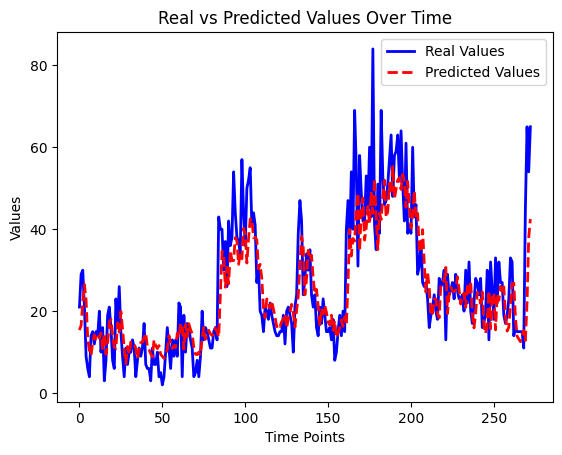

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital1_LastEpoch:
9/9 [==============================] - 1s 4ms/step


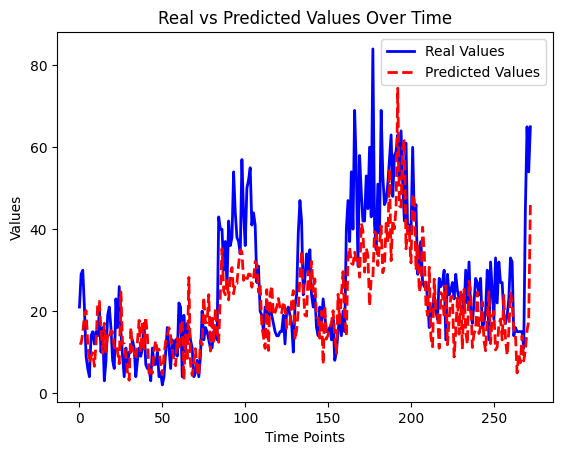

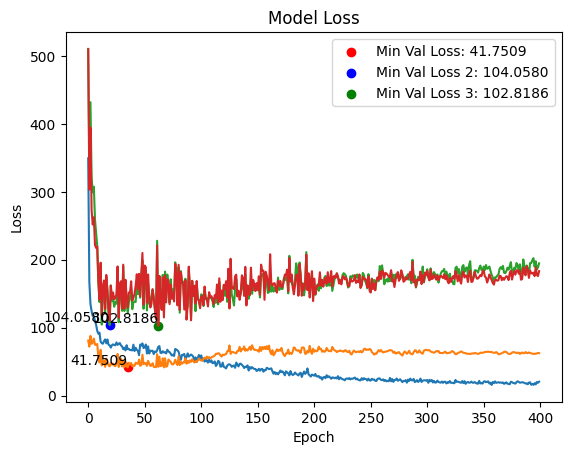

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=2
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 1333.7036
loss 1: 927.0247192382812
loss 2: 1480.623291015625
loss 3: 1177.1405029296875
Average Loss (Loss2*1.15 and Loss3*1.30): 1386.674719238281
7/7 [==============================] - 13s 507ms/step - loss: 1333.7036 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 631.7709
loss 1: 269.18798828125
loss 2: 644.109130859375
loss 3: 315.10382080078125
Average Loss (Loss2*1.15 and Loss3*1.30): 473.1828186035156
7/7 [==============================] - 1s 116ms/step - loss: 631.7709 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
6/7 [========================>.....] - ETA: 0s - loss: 428.8922
loss 1: 319.9842834472656
loss 2: 714.4063110351562
loss 3: 379.4428405761719
Average Loss (Loss2*1.15 and Loss3*1.30): 544.9424112955729
7/7 [==============================] - 0s 66ms/step - loss: 426.5366 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/7 [====================>.........] - ETA: 0s - loss: 322.0868
loss 1: 424.520751953125
loss 2: 842.3890380859375
loss 3: 503.22369384765625
Average Loss (Loss2*1.15 and Loss3*1.30): 682.4863159179687
7/7 [==============================] - 0s 53ms/step - loss: 331.3724 - lr: 0.00

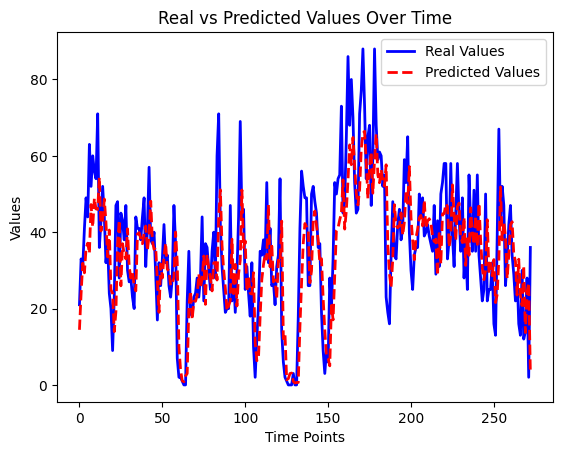

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital2_LastEpoch:
9/9 [==============================] - 2s 9ms/step


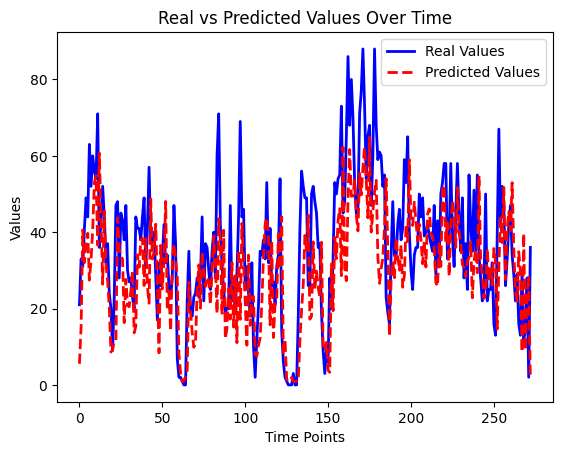

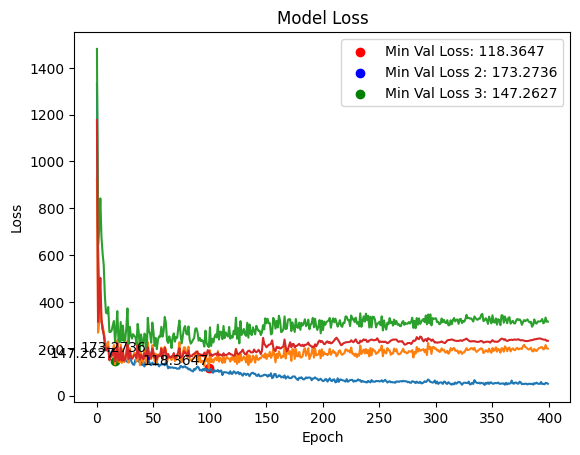

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=3
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
5/7 [====================>.........] - ETA: 0s - loss: 11032.5723  
loss 1: 8858.4521484375
loss 2: 14043.5087890625
loss 3: 17610.779296875
Average Loss (Loss2*1.15 and Loss3*1.30): 15967.500113932292


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 13s 358ms/step - loss: 10814.0518 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
4/7 [================>.............] - ETA: 0s - loss: 8680.1035 
loss 1: 5524.171875
loss 2: 8991.6650390625
loss 3: 10120.810546875
Average Loss (Loss2*1.15 and Loss3*1.30): 9673.880126953125
7/7 [==============================] - 1s 87ms/step - loss: 7798.3677 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 3990.1641
loss 1: 3441.660400390625
loss 2: 4902.58154296875
loss 3: 1672.24560546875
Average Loss (Loss2*1.15 and Loss3*1.30): 3751.18282063802
7/7 [==============================] - 1s 82ms/step - loss: 3785.5872 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
4/7 [================>.............] - ETA: 0s - loss: 3095.1887
loss 1: 3006.929931640625
loss 2: 4751.86865234375
loss 3: 22

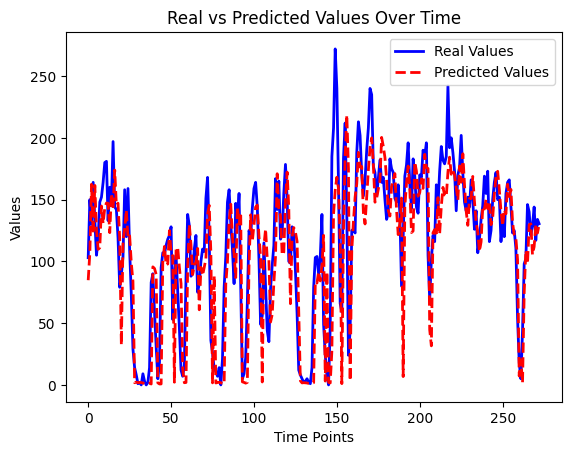

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital3_LastEpoch:
9/9 [==============================] - 2s 8ms/step


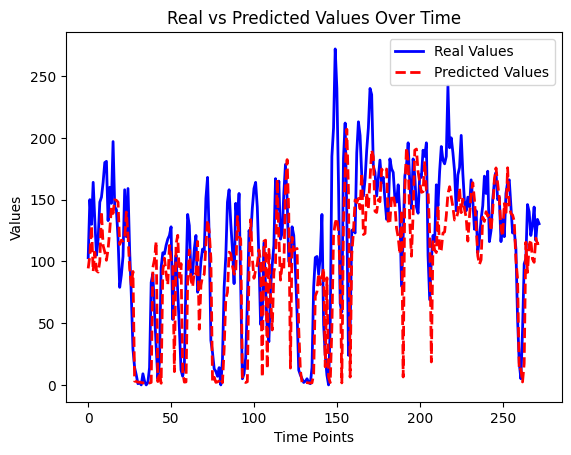

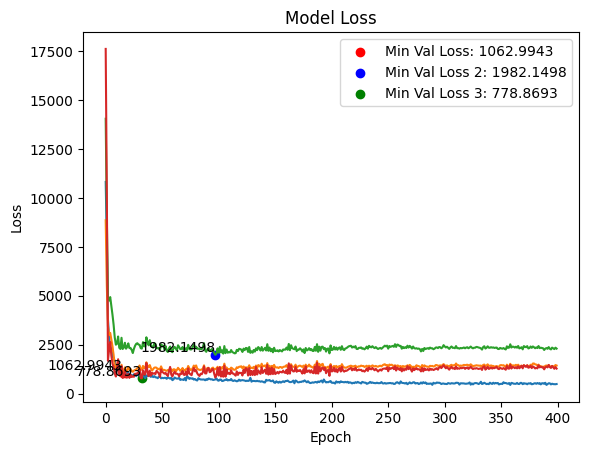

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=4
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
5/7 [====================>.........] - ETA: 0s - loss: 32.2408  
loss 1: 2.38268780708313
loss 2: 35.94911575317383
loss 3: 5.775676727294922
Average Loss (Loss2*1.15 and Loss3*1.30): 17.07751688957214
7/7 [==============================] - 13s 394ms/step - loss: 31.6957 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


4/7 [================>.............] - ETA: 0s - loss: 24.1722
loss 1: 3.4856879711151123
loss 2: 26.49497413635254
loss 3: 4.696089744567871
Average Loss (Loss2*1.15 and Loss3*1.30): 13.353274965286253
7/7 [==============================] - 1s 82ms/step - loss: 23.8685 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
4/7 [================>.............] - ETA: 0s - loss: 19.0714
loss 1: 2.426661968231201
loss 2: 24.616809844970703
loss 3: 4.888101100921631
Average Loss (Loss2*1.15 and Loss3*1.30): 12.363508240381876
7/7 [==============================] - 1s 85ms/step - loss: 19.4290 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/7 [====================>.........] - ETA: 0s - loss: 17.4578
loss 1: 2.450709342956543
loss 2: 23.65882110595703
loss 3: 4.692695617675781
Average Loss (Loss2*1.15 and Loss3*1.30): 11.919619305928547
7/7 [==============================] - 1s 82ms/step - loss: 17.2533 - lr: 0.00

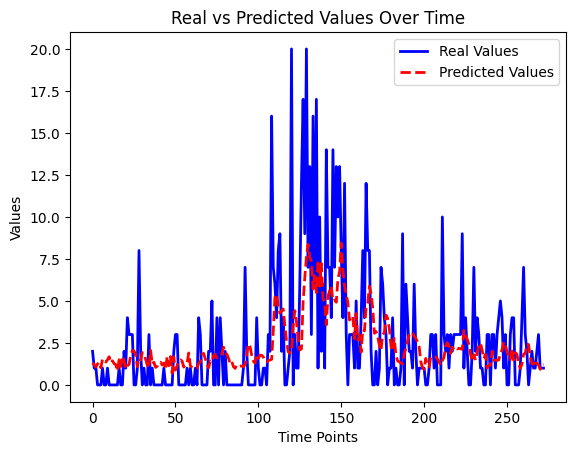

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital4_LastEpoch:
9/9 [==============================] - 1s 6ms/step


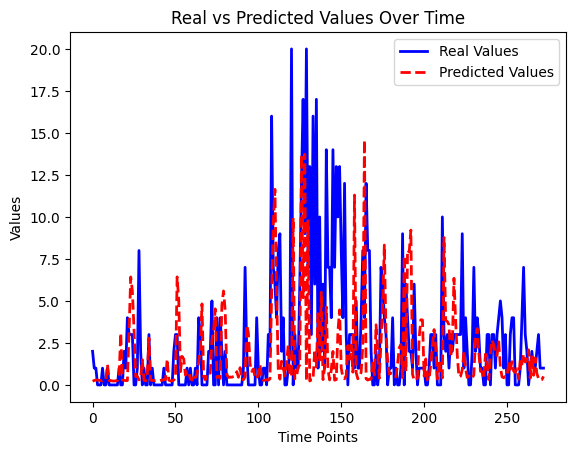

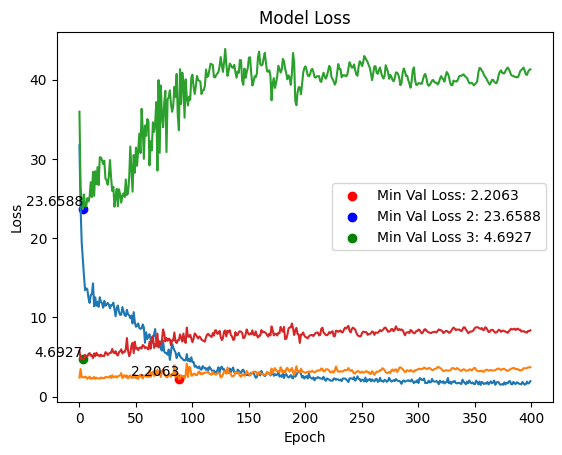

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=5
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
5/7 [====================>.........] - ETA: 0s - loss: 407.8337  
loss 1: 642.0068969726562
loss 2: 1588.5989990234375
loss 3: 612.7498168945312
Average Loss (Loss2*1.15 and Loss3*1.30): 1088.4901692708333


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 13s 374ms/step - loss: 391.7888 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
6/7 [========================>.....] - ETA: 0s - loss: 188.4379
loss 1: 242.99134826660156
loss 2: 526.0194091796875
loss 3: 431.419189453125
Average Loss (Loss2*1.15 and Loss3*1.30): 469.58620503743487
7/7 [==============================] - 1s 87ms/step - loss: 185.5528 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
4/7 [================>.............] - ETA: 0s - loss: 149.3263
loss 1: 389.2944030761719
loss 2: 891.5755004882812
loss 3: 443.9620361328125
Average Loss (Loss2*1.15 and Loss3*1.30): 663.9189585367839
7/7 [==============================] - 0s 58ms/step - loss: 154.1042 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
4/7 [================>.............] - ETA: 0s - loss: 151.1517
loss 1: 332.74859619140625
loss 2: 675.7880859375
loss 

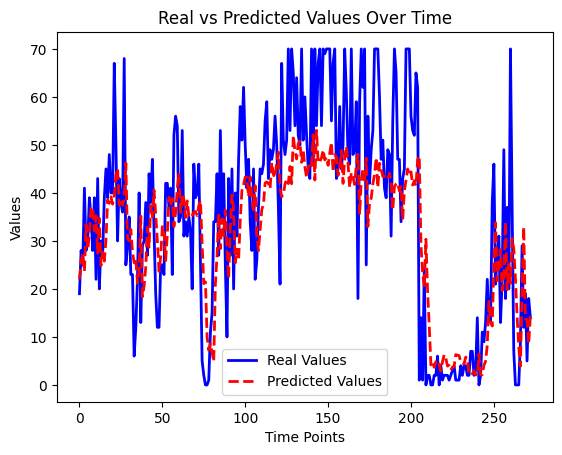

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital5_LastEpoch:
9/9 [==============================] - 2s 6ms/step


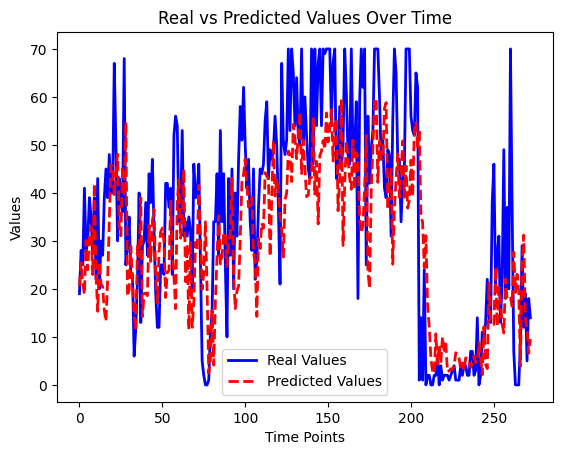

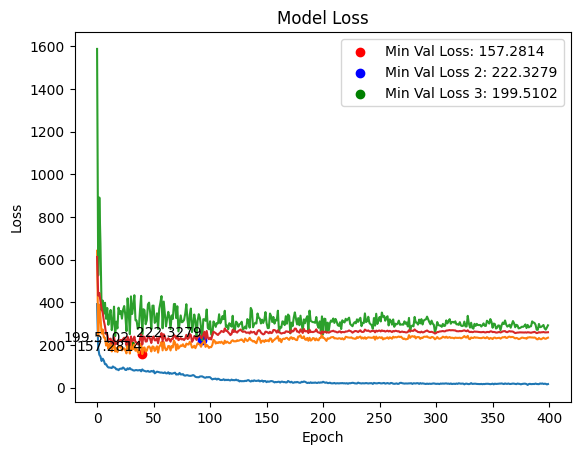

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=6
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
4/7 [================>.............] - ETA: 0s - loss: 83.2751  
loss 1: 19.635486602783203
loss 2: 32.43113708496094
loss 3: 18.255054473876953
Average Loss (Loss2*1.15 and Loss3*1.30): 26.887621688842774


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 13s 422ms/step - loss: 74.6275 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
5/7 [====================>.........] - ETA: 0s - loss: 41.3554
loss 1: 17.202821731567383
loss 2: 35.43118667602539
loss 3: 14.326410293579102
Average Loss (Loss2*1.15 and Loss3*1.30): 25.52433993021647
7/7 [==============================] - 1s 80ms/step - loss: 40.4843 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 36.8040
loss 1: 17.050466537475586
loss 2: 38.11853790283203
loss 3: 12.932093620300293
Average Loss (Loss2*1.15 and Loss3*1.30): 25.899502277374268
7/7 [==============================] - 0s 65ms/step - loss: 36.8040 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 34.6237
loss 1: 19.741796493530273
loss 2: 36.46275329589844
loss

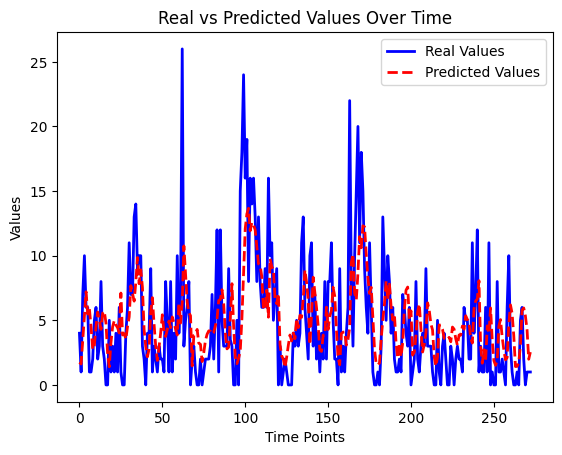

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital6_LastEpoch:
9/9 [==============================] - 2s 8ms/step


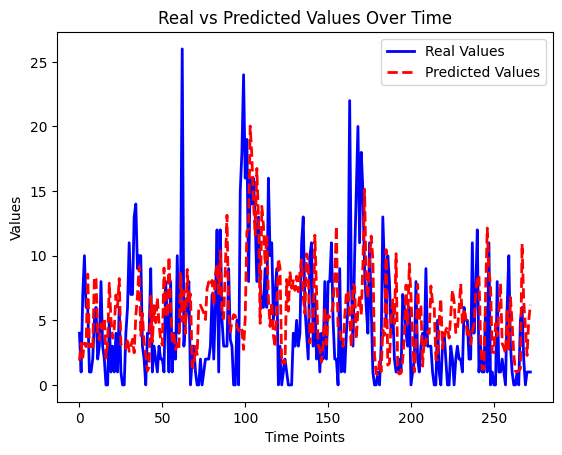

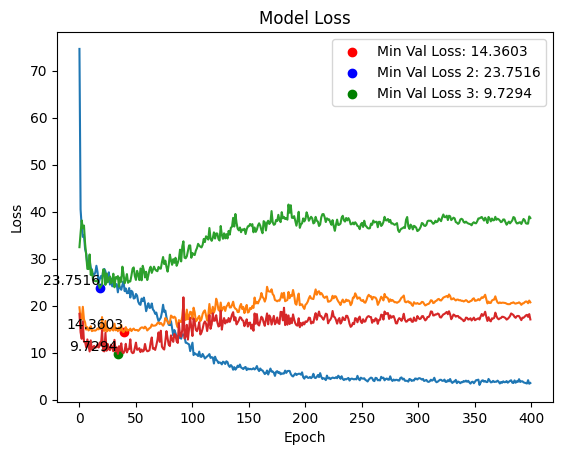

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=7
Train shapes:
(549, 7, 15) (549, 7, 15) (549,) (549,) (549,) (549,)

Test shapes:
(183, 7, 15) (183, 7, 15) (183,) (183,) (183,) (183,)

Validation shapes:
(60, 7, 15) (60, 7, 15) (60,) (60,) (60,) (60,)
(60, 7, 15) (60, 7, 15) (60,) (60,) (60,) (60,)
(63, 7, 15) (63, 7, 15) (63,) (63,) (63,) (63,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
4/5 [=======================>......] - ETA: 0s - loss: 62.6683 
loss 1: 69.2545394897461
loss 2: 16.159727096557617
loss 3: 4.03745698928833
Average Loss (Loss2*1.15 and Loss3*1.30): 31.02897324562073


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


5/5 [==============================] - 13s 576ms/step - loss: 61.0038 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
3/5 [=================>............] - ETA: 0s - loss: 32.9101
loss 1: 43.985252380371094
loss 2: 31.650859832763672
loss 3: 26.355302810668945
Average Loss (Loss2*1.15 and Loss3*1.30): 38.215211613972976
5/5 [==============================] - 1s 117ms/step - loss: 33.4425 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
4/5 [=======================>......] - ETA: 0s - loss: 22.3783
loss 1: 36.68794250488281
loss 2: 14.922761917114258
loss 3: 5.024869441986084
Average Loss (Loss2*1.15 and Loss3*1.30): 20.127149661382038
5/5 [==============================] - 1s 167ms/step - loss: 23.6187 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
3/5 [=================>............] - ETA: 0s - loss: 23.8355
loss 1: 32.602210998535156
loss 2: 15.942590713500977


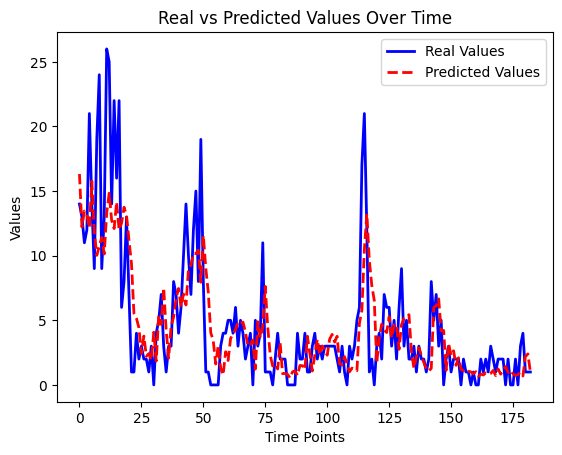

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital7_LastEpoch:
6/6 [==============================] - 1s 8ms/step


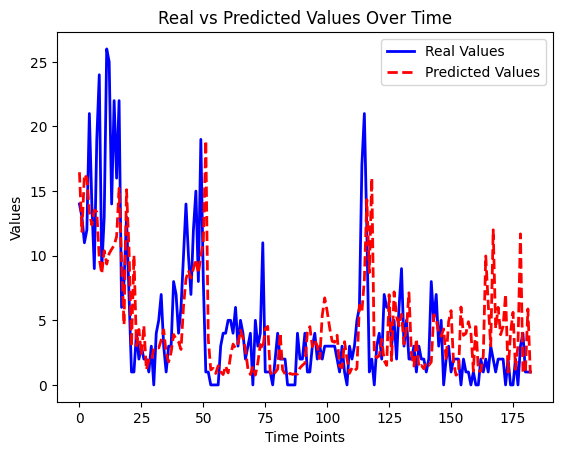

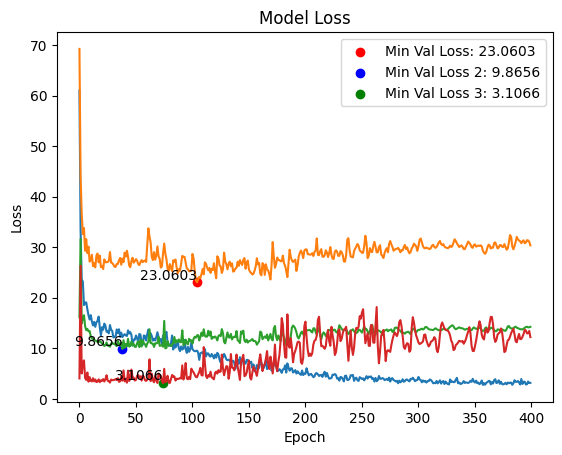

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=8
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 356.6078
loss 1: 53.00485610961914
loss 2: 48.299983978271484
loss 3: 40.579769134521484
Average Loss (Loss2*1.15 and Loss3*1.30): 53.76784585316975


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 12s 373ms/step - loss: 356.6078 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
4/7 [================>.............] - ETA: 0s - loss: 264.8689
loss 1: 44.490718841552734
loss 2: 89.93050384521484
loss 3: 73.59671783447266
Average Loss (Loss2*1.15 and Loss3*1.30): 81.1955104827881
7/7 [==============================] - 0s 59ms/step - loss: 215.6744 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
4/7 [================>.............] - ETA: 0s - loss: 156.9432
loss 1: 38.64622497558594
loss 2: 80.35203552246094
loss 3: 51.46608352661133
Average Loss (Loss2*1.15 and Loss3*1.30): 65.98565813700357
7/7 [==============================] - 0s 63ms/step - loss: 162.5896 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 136.0833
loss 1: 38.6636848449707
loss 2: 57.254817962646484
loss

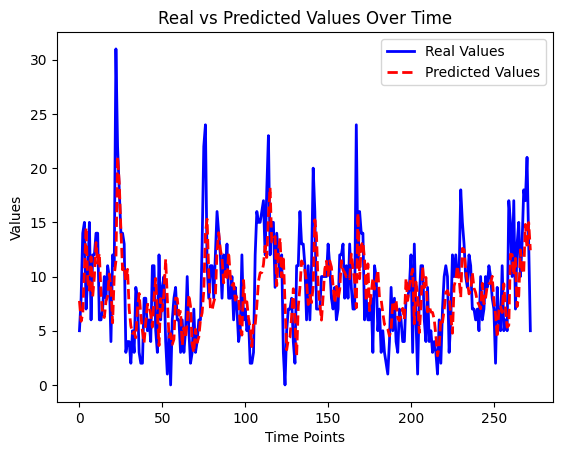

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital8_LastEpoch:
9/9 [==============================] - 1s 8ms/step


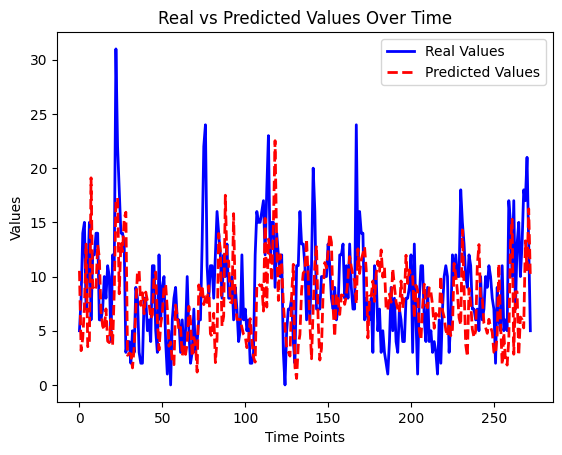

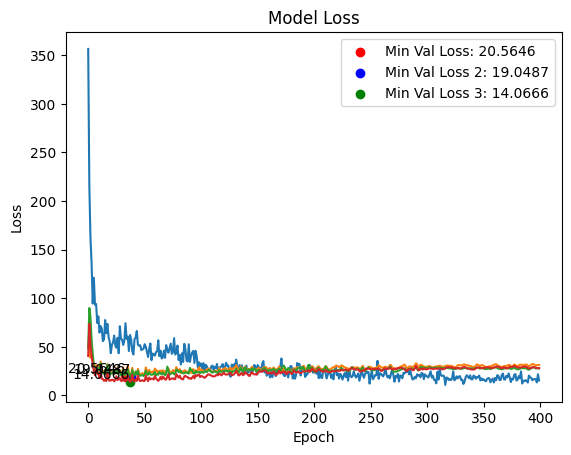

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=9
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 177.1675
loss 1: 255.70225524902344
loss 2: 145.23110961914062
loss 3: 237.09303283691406
Average Loss (Loss2*1.15 and Loss3*1.30): 243.64632466634112


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 12s 388ms/step - loss: 177.1675 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
5/7 [====================>.........] - ETA: 0s - loss: 75.4909
loss 1: 113.26628875732422
loss 2: 59.89653778076172
loss 3: 103.22760009765625
Average Loss (Loss2*1.15 and Loss3*1.30): 105.44772911071777
7/7 [==============================] - 1s 87ms/step - loss: 77.1462 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 56.5387
loss 1: 173.07009887695312
loss 2: 91.67483520507812
loss 3: 152.33619689941406
Average Loss (Loss2*1.15 and Loss3*1.30): 158.8444051106771
7/7 [==============================] - 0s 67ms/step - loss: 56.5387 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/7 [====================>.........] - ETA: 0s - loss: 56.4016
loss 1: 136.32701110839844
loss 2: 69.97354888916016
los

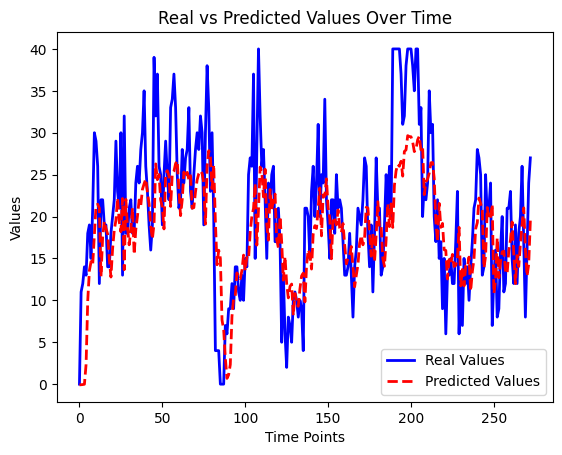

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital9_LastEpoch:
9/9 [==============================] - 1s 6ms/step


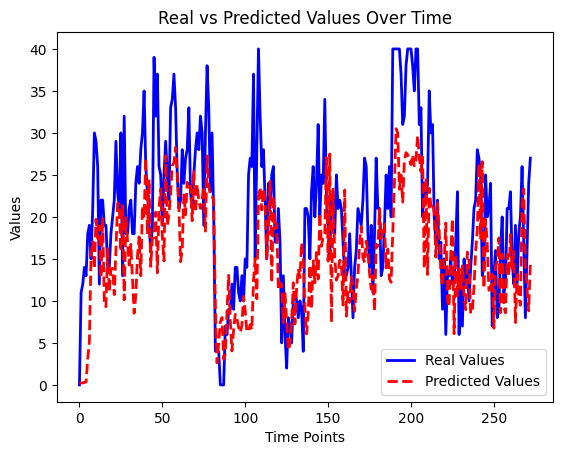

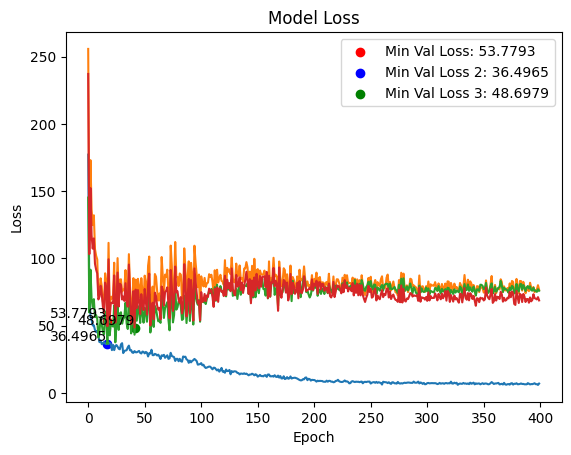

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=10
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 440.6696
loss 1: 938.1199951171875
loss 2: 996.4928588867188
loss 3: 917.6161499023438
Average Loss (Loss2*1.15 and Loss3*1.30): 1092.3292592366536


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 14s 406ms/step - loss: 440.6696 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
7/7 [==============================] - ETA: 0s - loss: 216.1965
loss 1: 360.2599792480469
loss 2: 293.83258056640625
loss 3: 379.4563903808594
Average Loss (Loss2*1.15 and Loss3*1.30): 397.15358479817706
7/7 [==============================] - 1s 135ms/step - loss: 216.1965 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 169.1839
loss 1: 484.62579345703125
loss 2: 450.2438049316406
loss 3: 512.7687377929688
Average Loss (Loss2*1.15 and Loss3*1.30): 556.3351760864258
7/7 [==============================] - 1s 97ms/step - loss: 169.1839 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
6/7 [========================>.....] - ETA: 0s - loss: 160.9437
loss 1: 434.0229187011719
loss 2: 428.15478515625
lo

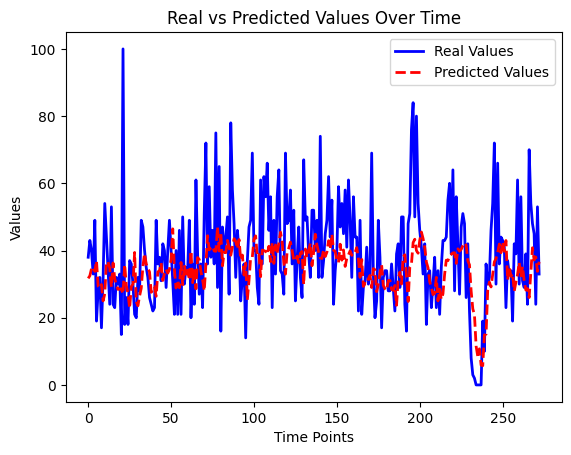

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital10_LastEpoch:
9/9 [==============================] - 1s 8ms/step


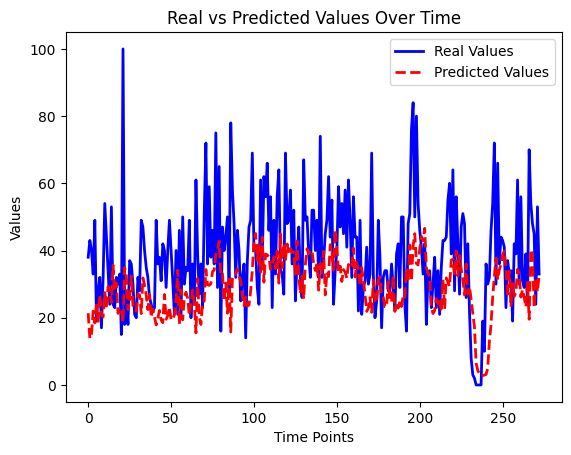

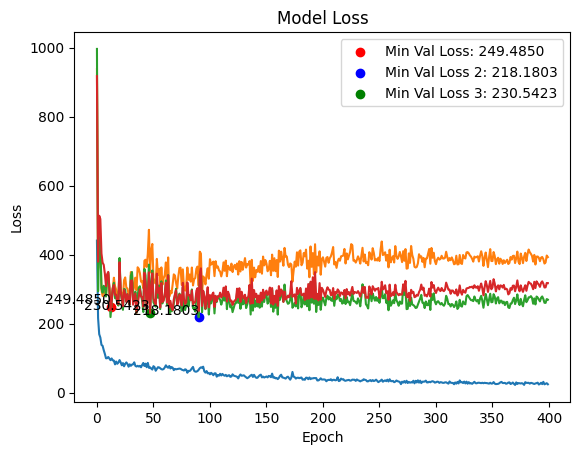

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=11
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 46.6894
loss 1: 30.825206756591797
loss 2: 15.472692489624023
loss 3: 28.528701782226562
Average Loss (Loss2*1.15 and Loss3*1.30): 28.56870514551798


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 14s 400ms/step - loss: 46.6894 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
7/7 [==============================] - ETA: 0s - loss: 28.9154
loss 1: 30.91238021850586
loss 2: 12.848337173461914
loss 3: 28.395912170410156
Average Loss (Loss2*1.15 and Loss3*1.30): 27.534217929840093
7/7 [==============================] - 1s 99ms/step - loss: 28.9154 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 25.8445
loss 1: 32.324703216552734
loss 2: 12.582545280456543
loss 3: 24.02045249938965
Average Loss (Loss2*1.15 and Loss3*1.30): 26.00707284609477
7/7 [==============================] - 1s 98ms/step - loss: 25.8445 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 24.2784
loss 1: 29.672992706298828
loss 2: 11.751422882080078
los

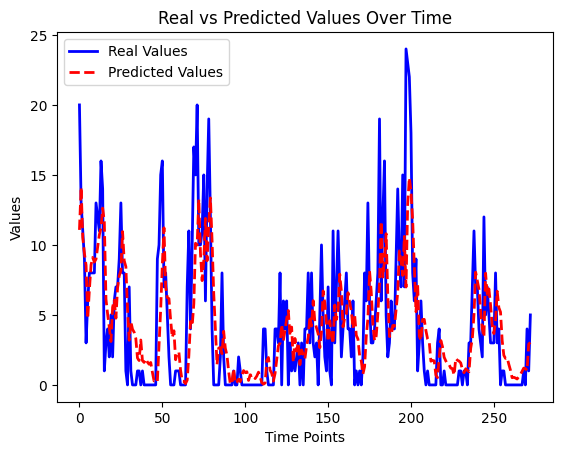

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital11_LastEpoch:
9/9 [==============================] - 2s 9ms/step


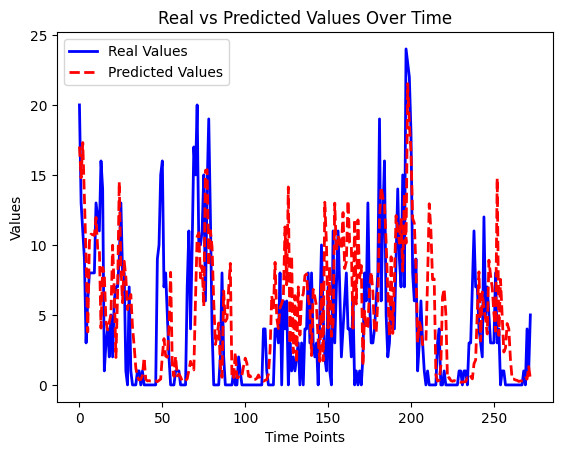

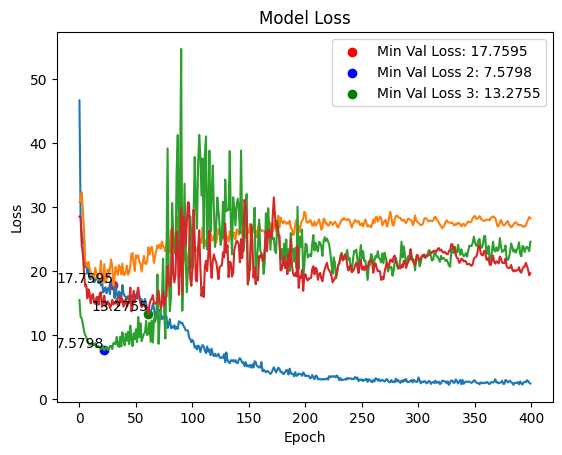

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=12
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 2.7422
loss 1: 0.01665198616683483
loss 2: 16.667966842651367
loss 3: 46.483890533447266
Average Loss (Loss2*1.15 and Loss3*1.30): 26.537957182899117


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 13s 395ms/step - loss: 2.7422 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
7/7 [==============================] - ETA: 0s - loss: 2.4672
loss 1: 0.02676483988761902
loss 2: 14.863042831420898
loss 3: 37.59912109375
Average Loss (Loss2*1.15 and Loss3*1.30): 21.999373839298887
7/7 [==============================] - 1s 95ms/step - loss: 2.4672 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
4/7 [================>.............] - ETA: 0s - loss: 2.4613
loss 1: 0.0030781091190874577
loss 2: 13.099267959594727
loss 3: 31.93731689453125
Average Loss (Loss2*1.15 and Loss3*1.30): 18.861916075181217
7/7 [==============================] - 1s 100ms/step - loss: 2.2763 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 2.0918
loss 1: 0.0001294653775403276
loss 2: 11.148726463317871
los

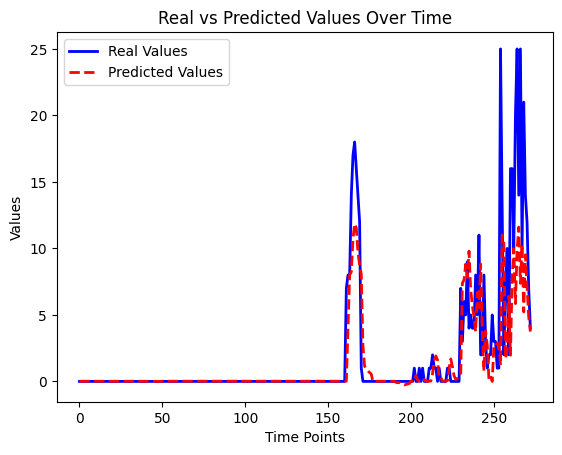

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital12_LastEpoch:
9/9 [==============================] - 1s 7ms/step


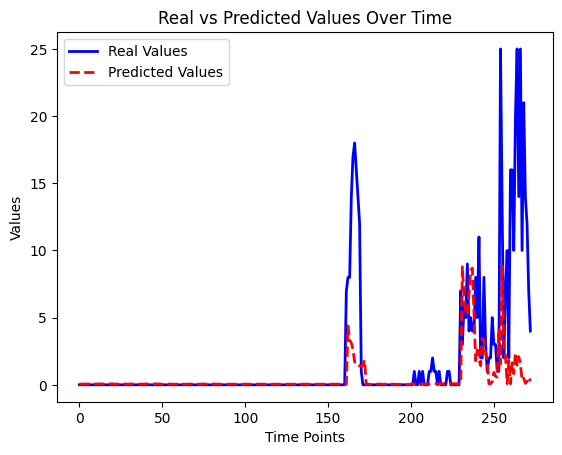

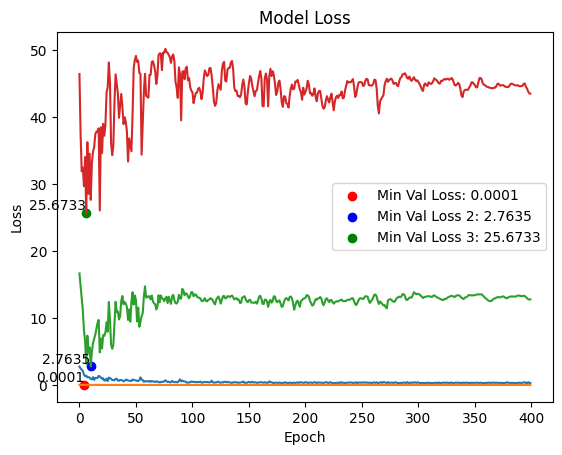

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=7 FOR HOSPITAL=13
Train shapes:
(817, 7, 15) (817, 7, 15) (817,) (817,) (817,) (817,)

Test shapes:
(273, 7, 15) (273, 7, 15) (273,) (273,) (273,) (273,)

Validation shapes:
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(90, 7, 15) (90, 7, 15) (90,) (90,) (90,) (90,)
(93, 7, 15) (93, 7, 15) (93,) (93,) (93,) (93,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 39692.5117
loss 1: 30723.564453125
loss 2: 48886.03515625
loss 3: 37833.203125
Average Loss (Loss2*1.15 and Loss3*1.30): 45375.222981770836


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 14s 421ms/step - loss: 39692.5117 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
7/7 [==============================] - ETA: 0s - loss: 13208.2324
loss 1: 9383.0693359375
loss 2: 10716.1650390625
loss 3: 4389.9521484375
Average Loss (Loss2*1.15 and Loss3*1.30): 9137.865641276041
7/7 [==============================] - 1s 101ms/step - loss: 13208.2324 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 12809.5078
loss 1: 10285.8974609375
loss 2: 12464.046875
loss 3: 5172.52734375
Average Loss (Loss2*1.15 and Loss3*1.30): 10447.945638020834
7/7 [==============================] - 0s 74ms/step - loss: 12809.5078 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
4/7 [================>.............] - ETA: 0s - loss: 8385.5508
loss 1: 15627.89453125
loss 2: 22116.53515625
loss 3: 1228

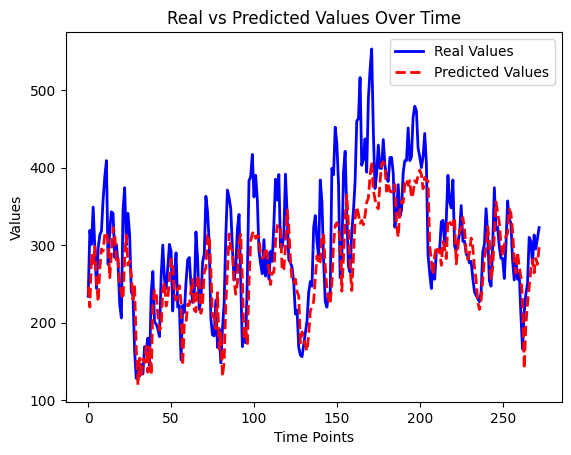

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq7_Hospital13_LastEpoch:
9/9 [==============================] - 2s 6ms/step


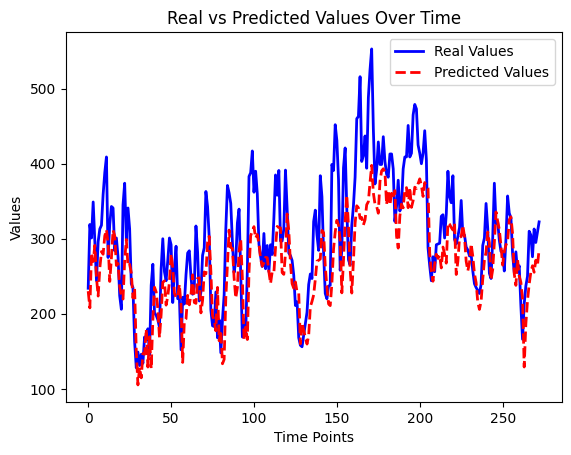

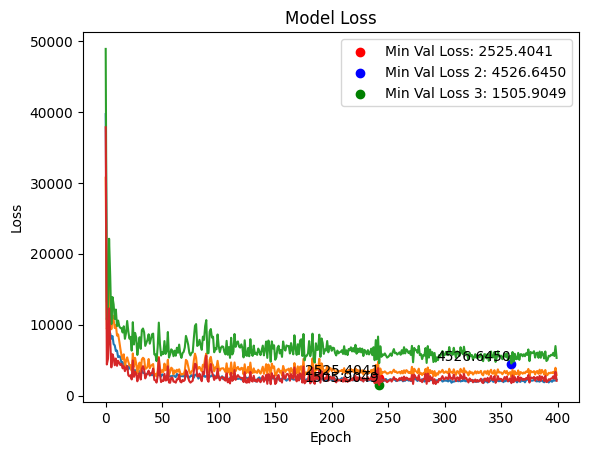

In [ ]:
# Train Model for Model_1 using seq = 7
seq = 7
for i in range (1,14):
  print('↔ ' * 60)
  print(f'TRAINING MODEL WITH SEQ={seq} FOR HOSPITAL={i}')
  hospital = i
  firstLabel = datetime(2020, 1, seq)
  if hospital == 7: firstLabel = datetime(2020, 12, 23+seq)
  lastLabel = datetime(2022, 12, 31)
  generated_DF=generateDataset(firstLabel,lastLabel,hospital,seq)
  generated_labels = generateLabels(firstLabel, lastLabel,hospital)
  m,h,cb=Model_1(generated_DF,generated_labels ,1 ,ModelName = f'/content/drive/MyDrive/Hamedan Models/Model 1/M1_seq{seq}_Hospital{hospital}',trainRatio = 0.75, plotModel=True , Epochs = 400)
  print()
  PlotUsingValidationData(h,cb)
  del generated_DF,generated_labels,m,h,cb

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=1
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
5/7 [====================>.........] - ETA: 0s - loss: 449.5742
loss 1: 220.32266235351562
loss 2: 927.0200805664062
loss 3: 971.0870361328125
Average Loss (Loss2*1.15 and Loss3*1.30): 849.6029673258463
7/7 [==============================] - 18s 337ms/step - loss: 429.4025 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


5/7 [====================>.........] - ETA: 0s - loss: 221.5965
loss 1: 116.53791046142578
loss 2: 351.69403076171875
loss 3: 352.2337341308594
Average Loss (Loss2*1.15 and Loss3*1.30): 326.29663340250653
7/7 [==============================] - 1s 98ms/step - loss: 210.0154 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 163.0041
loss 1: 114.49205780029297
loss 2: 519.3696899414062
loss 3: 522.4581298828125
Average Loss (Loss2*1.15 and Loss3*1.30): 463.6542566935221
7/7 [==============================] - 1s 81ms/step - loss: 153.1981 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/7 [====================>.........] - ETA: 0s - loss: 128.9956
loss 1: 124.38508605957031
loss 2: 526.4286499023438
loss 3: 520.469970703125
Average Loss (Loss2*1.15 and Loss3*1.30): 468.7963317871093
7/7 [==============================] - 0s 70ms/step - loss: 130.1434 - lr:

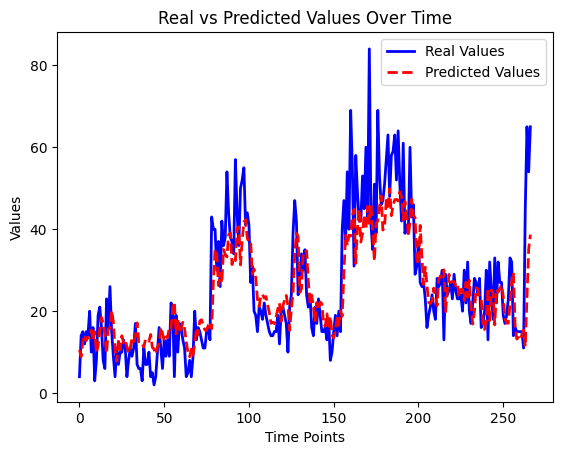

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital1_LastEpoch:
9/9 [==============================] - 1s 8ms/step


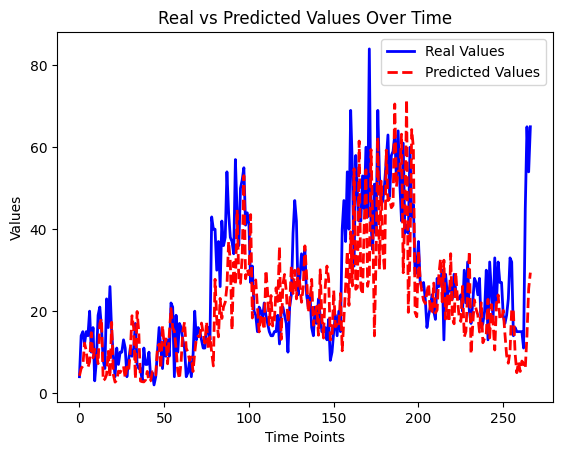

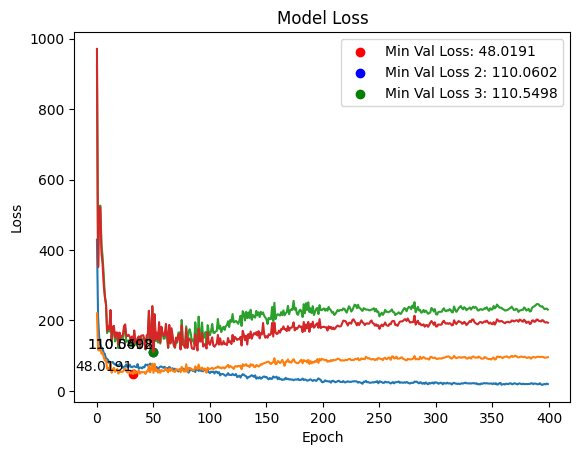

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=2
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 951.9660 
loss 1: 690.219482421875
loss 2: 1309.8883056640625
loss 3: 794.2855224609375
Average Loss (Loss2*1.15 and Loss3*1.30): 1076.3874043782553
7/7 [==============================] - 14s 340ms/step - loss: 951.9660 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 373.6989
loss 1: 307.8764953613281
loss 2: 781.073486328125
loss 3: 295.2130126953125
Average Loss (Loss2*1.15 and Loss3*1.30): 529.9626403808594
7/7 [==============================] - 1s 123ms/step - loss: 373.6989 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 340.9119
loss 1: 497.6597900390625
loss 2: 1045.6669921875
loss 3: 526.4501953125
Average Loss (Loss2*1.15 and Loss3*1.30): 794.8540283203125
7/7 [==============================] - 0s 72ms/step - loss: 329.3548 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/7 [====================>.........] - ETA: 0s - loss: 295.3525
loss 1: 470.8403625488281
loss 2: 1003.2416381835938
loss 3: 497.5519104003906
Average Loss (Loss2*1.15 and Loss3*1.30): 757.1285766601562
7/7 [==============================] - 0s 70ms/step - loss: 315.0252 - lr: 0.0010


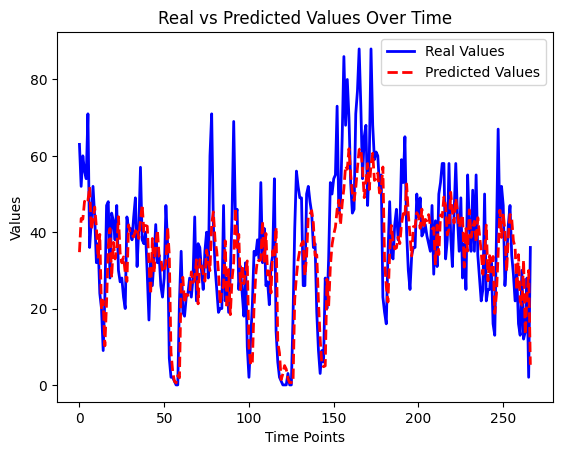

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital2_LastEpoch:
9/9 [==============================] - 1s 8ms/step


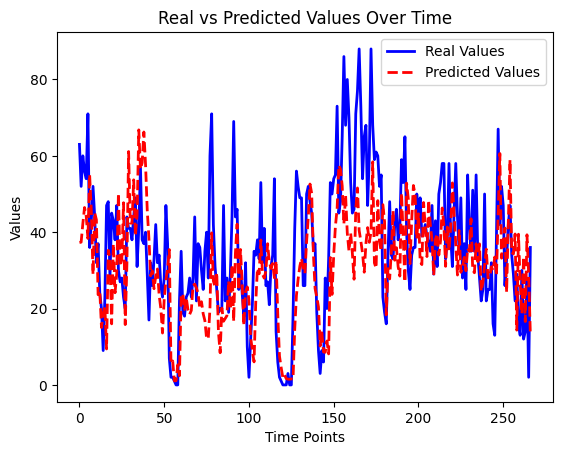

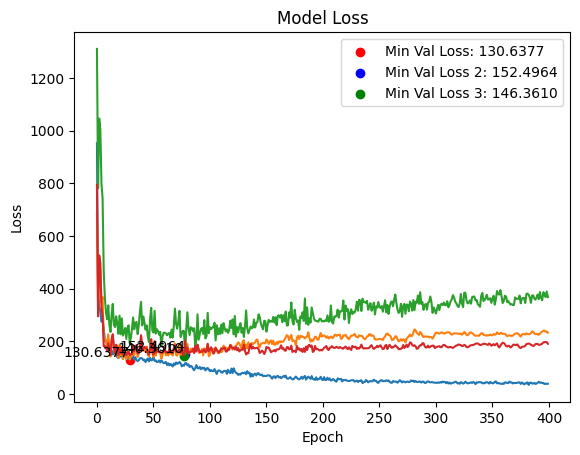

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=3
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 10758.0303
loss 1: 7349.00439453125
loss 2: 13032.921875
loss 3: 16597.154296875
Average Loss (Loss2*1.15 and Loss3*1.30): 14637.721712239581
7/7 [==============================] - 14s 323ms/step - loss: 10758.0303 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


6/7 [========================>.....] - ETA: 0s - loss: 6768.6636
loss 1: 3620.16259765625
loss 2: 6885.357421875
loss 3: 7091.9404296875
Average Loss (Loss2*1.15 and Loss3*1.30): 6919.282063802083
7/7 [==============================] - 1s 97ms/step - loss: 6650.4463 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 3217.2922
loss 1: 3695.356201171875
loss 2: 5025.91455078125
loss 3: 1777.2857666015625
Average Loss (Loss2*1.15 and Loss3*1.30): 3928.543143717448
7/7 [==============================] - 1s 108ms/step - loss: 3177.3914 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/7 [====================>.........] - ETA: 0s - loss: 3149.2915
loss 1: 2938.339599609375
loss 2: 5243.42138671875
loss 3: 3551.955322265625
Average Loss (Loss2*1.15 and Loss3*1.30): 4528.605371093749
7/7 [==============================] - 0s 75ms/step - loss: 3070.8330 - lr: 0.0

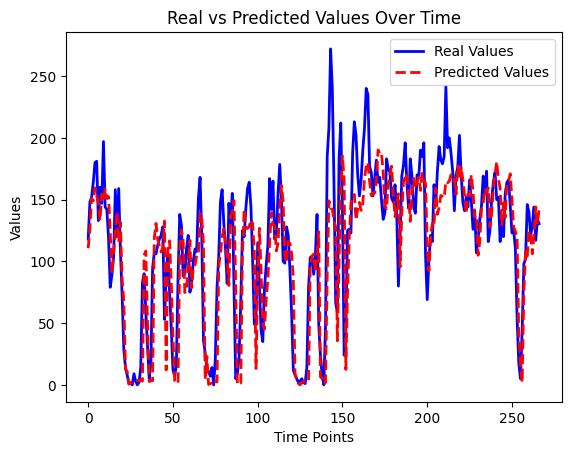

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital3_LastEpoch:
9/9 [==============================] - 1s 9ms/step


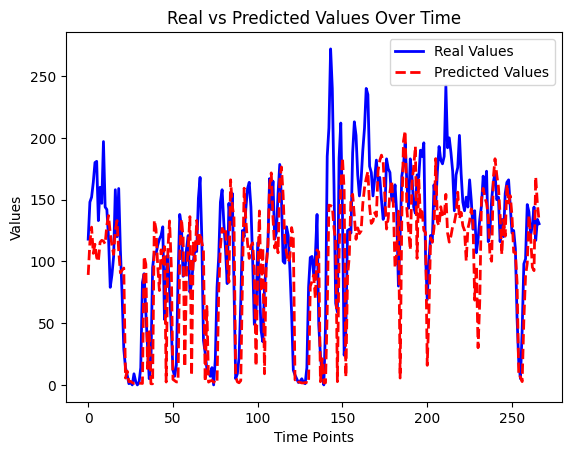

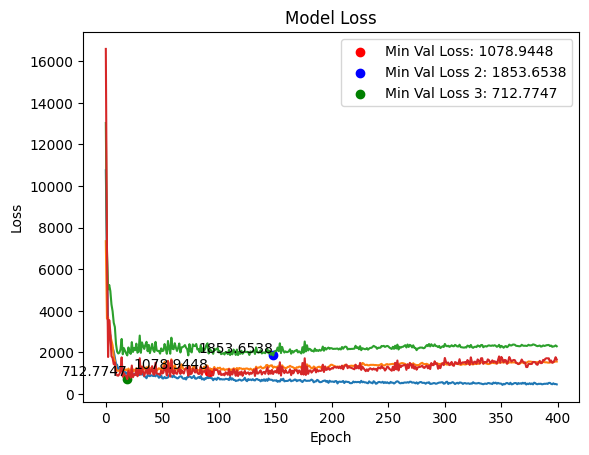

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=4
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 29.7633
loss 1: 3.470266103744507
loss 2: 32.20929718017578
loss 3: 4.554853916168213
Average Loss (Loss2*1.15 and Loss3*1.30): 15.47742265065511
7/7 [==============================] - 14s 348ms/step - loss: 29.7633 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 21.0285
loss 1: 3.8432137966156006
loss 2: 26.760656356811523
loss 3: 4.631524562835693
Average Loss (Loss2*1.15 and Loss3*1.30): 13.54631684621175
7/7 [==============================] - 1s 102ms/step - loss: 21.0285 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 18.6553
loss 1: 3.6868174076080322
loss 2: 24.775634765625
loss 3: 5.133393287658691
Average Loss (Loss2*1.15 and Loss3*1.30): 12.950736220677692
7/7 [==============================] - 1s 98ms/step - loss: 18.6161 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 18.1439
loss 1: 2.7710416316986084
loss 2: 24.110340118408203
loss 3: 4.934587001800537
Average Loss (Loss2*1.15 and Loss3*1.30): 12.304298623402913
7/7 [==============================] - 1s 92ms/step - loss: 18.1439 - lr: 0.0

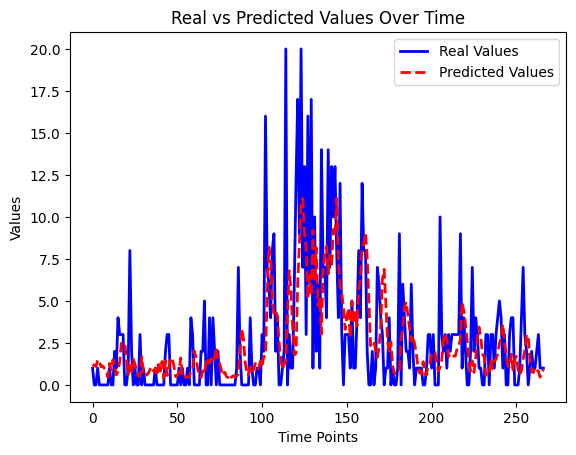

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital4_LastEpoch:
9/9 [==============================] - 1s 9ms/step


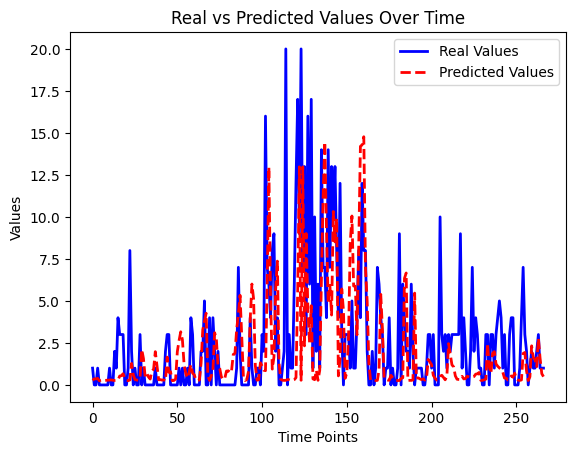

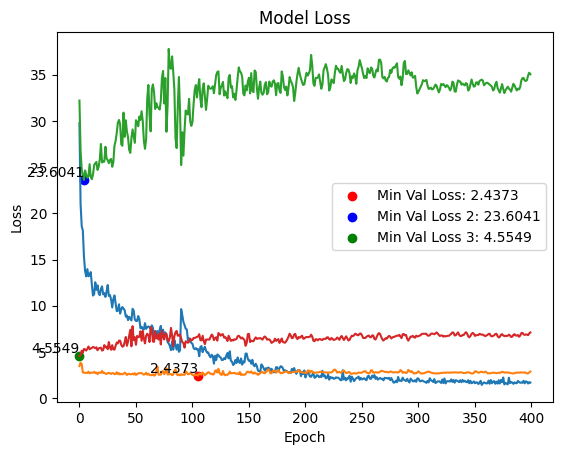

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=5
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 453.9067
loss 1: 791.451904296875
loss 2: 1960.336669921875
loss 3: 682.2828369140625
Average Loss (Loss2*1.15 and Loss3*1.30): 1310.9355875651042
7/7 [==============================] - 14s 446ms/step - loss: 453.9067 - lr: 0.0010


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
7/7 [==============================] - ETA: 0s - loss: 236.7523
loss 1: 277.79638671875
loss 2: 640.8200073242188
loss 3: 400.6729431152344
Average Loss (Loss2*1.15 and Loss3*1.30): 511.87140706380205
7/7 [==============================] - 1s 130ms/step - loss: 236.7523 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 179.6507
loss 1: 341.0639343261719
loss 2: 774.5369262695312
loss 3: 400.95843505859375
Average Loss (Loss2*1.15 and Loss3*1.30): 584.3424550374349
7/7 [==============================] - 0s 67ms/step - loss: 179.3069 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 148.3624
loss 1: 398.7241516113281
loss 2: 895.1517944335938
loss 3: 420.5239562988281
Average Loss (Loss2*1.15 and Loss3*1.30): 658.2766194661458
7

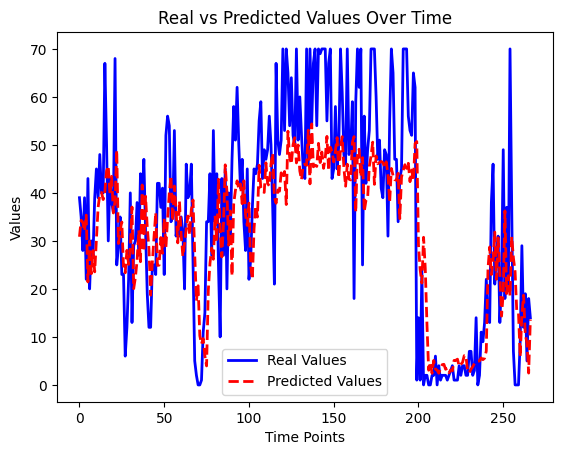

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital5_LastEpoch:
9/9 [==============================] - 2s 8ms/step


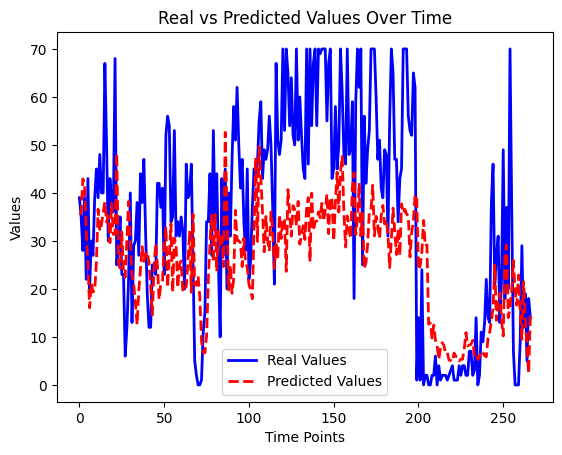

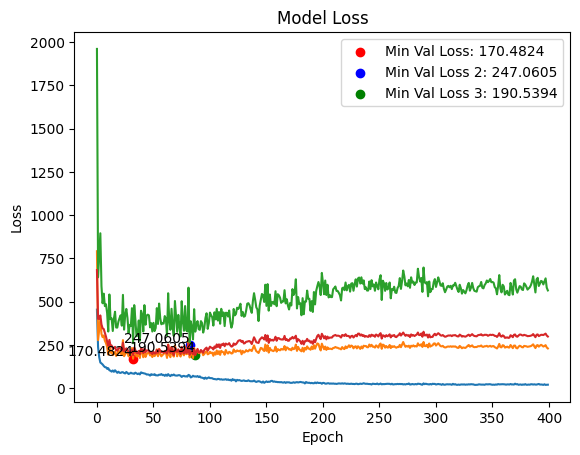

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=6
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
5/7 [====================>.........] - ETA: 0s - loss: 81.4084
loss 1: 18.374284744262695
loss 2: 36.60304260253906
loss 3: 15.132208824157715
Average Loss (Loss2*1.15 and Loss3*1.30): 26.713218402862548
7/7 [==============================] - 11s 319ms/step - loss: 73.7807 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
1/7 [===>..........................] - ETA: 0s - loss: 33.2134

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 40.4722
loss 1: 20.958253860473633
loss 2: 34.1699104309082
loss 3: 18.61667823791504
Average Loss (Loss2*1.15 and Loss3*1.30): 28.151777521769205
7/7 [==============================] - 0s 75ms/step - loss: 40.4722 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
6/7 [========================>.....] - ETA: 0s - loss: 37.0635
loss 1: 18.500635147094727
loss 2: 36.47549057006836
loss 3: 15.014793395996094
Average Loss (Loss2*1.15 and Loss3*1.30): 26.655560239156085
7/7 [==============================] - 1s 98ms/step - loss: 37.1246 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
6/7 [========================>.....] - ETA: 0s - loss: 37.8305
loss 1: 20.239042282104492
loss 2: 34.10749435424805
loss 3: 16.64498519897461
Average Loss (Loss2*1.15 and Loss3*1.30): 27.033713849385578
7/7 [==============================] - 1s 96ms/step - loss: 37.5148 - lr: 0.0

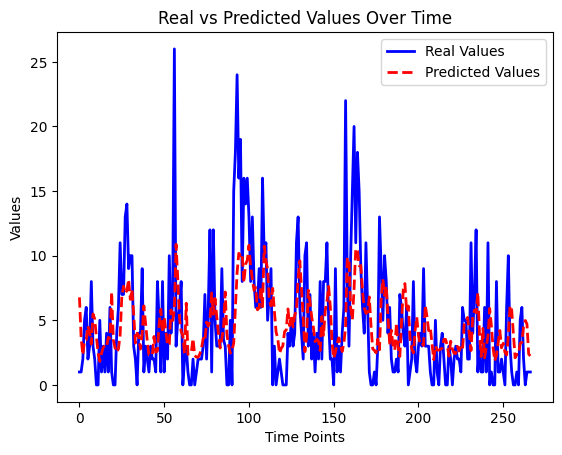

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital6_LastEpoch:
9/9 [==============================] - 2s 9ms/step


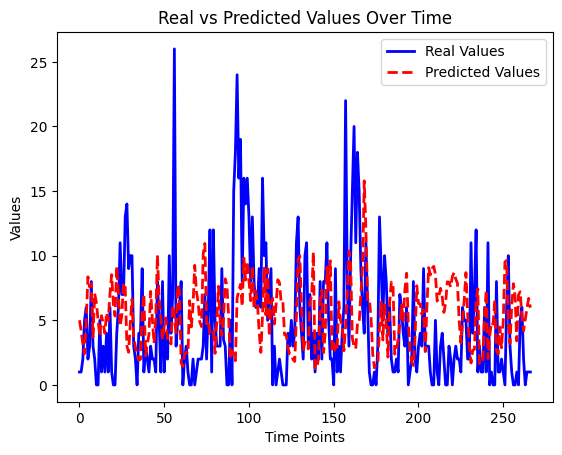

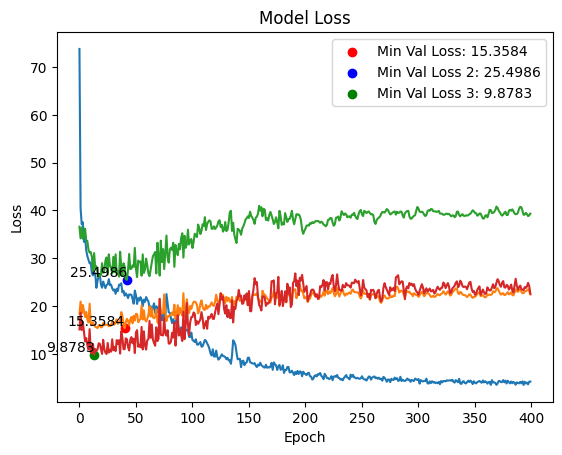

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=7
Train shapes:
(531, 30, 15) (531, 30, 15) (531,) (531,) (531,) (531,)

Test shapes:
(177, 30, 15) (177, 30, 15) (177,) (177,) (177,) (177,)

Validation shapes:
(58, 30, 15) (58, 30, 15) (58,) (58,) (58,) (58,)
(58, 30, 15) (58, 30, 15) (58,) (58,) (58,) (58,)
(61, 30, 15) (61, 30, 15) (61,) (61,) (61,) (61,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
5/5 [==============================] - ETA: 0s - loss: 65.8444
loss 1: 72.35601806640625
loss 2: 14.927237510681152
loss 3: 4.083770275115967
Average Loss (Loss2*1.15 and Loss3*1.30): 31.610414187113445
5/5 [==============================] - 14s 488ms/step - loss: 65.8444 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


5/5 [==============================] - ETA: 0s - loss: 38.3603
loss 1: 44.06623077392578
loss 2: 28.535051345825195
loss 3: 24.40552520751953
Average Loss (Loss2*1.15 and Loss3*1.30): 36.20290753046672
5/5 [==============================] - 0s 98ms/step - loss: 38.3603 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
3/5 [=================>............] - ETA: 0s - loss: 31.2796
loss 1: 37.875099182128906
loss 2: 14.965455055236816
loss 3: 3.7771739959716797
Average Loss (Loss2*1.15 and Loss3*1.30): 19.99856623013814
5/5 [==============================] - 1s 132ms/step - loss: 28.1980 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
5/5 [==============================] - ETA: 0s - loss: 20.5492
loss 1: 44.288475036621094
loss 2: 18.373409271240234
loss 3: 5.995561599731445
Average Loss (Loss2*1.15 and Loss3*1.30): 24.404041926066082
5/5 [==============================] - 0s 98ms/step - loss: 20.5492 - lr: 0

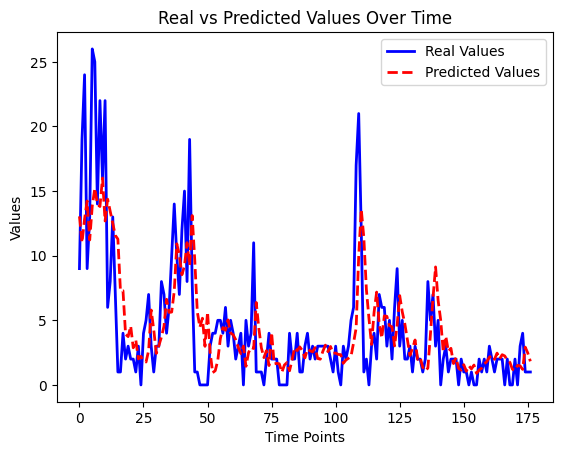

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital7_LastEpoch:
6/6 [==============================] - 2s 8ms/step


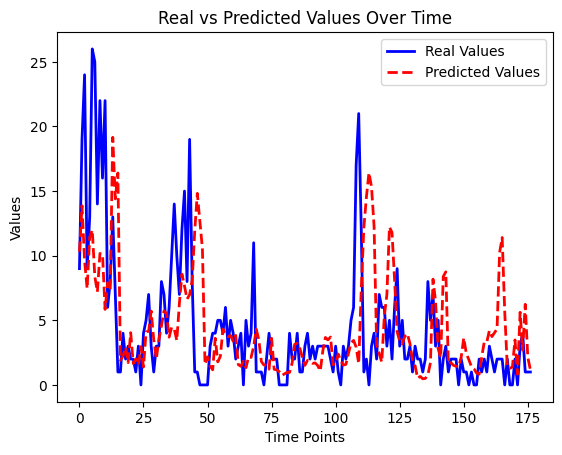

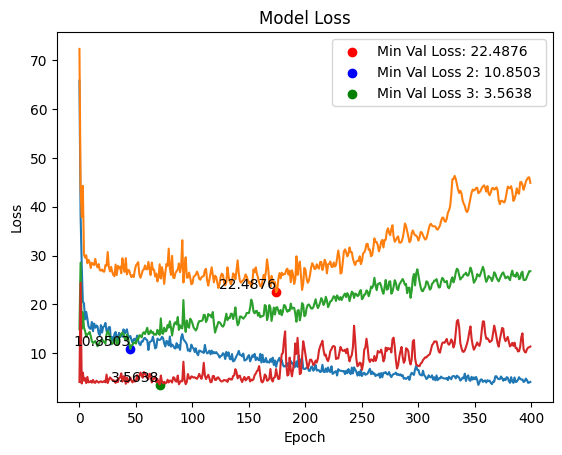

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=8
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 349.4045
loss 1: 39.23256301879883
loss 2: 34.504825592041016
loss 3: 29.79998207092285
Average Loss (Loss2*1.15 and Loss3*1.30): 39.21769638061523
7/7 [==============================] - 12s 323ms/step - loss: 349.4045 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 225.0390
loss 1: 48.213565826416016
loss 2: 54.77657699584961
loss 3: 44.42551803588867
Average Loss (Loss2*1.15 and Loss3*1.30): 56.31993427276611
7/7 [==============================] - 1s 85ms/step - loss: 225.0390 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 173.6404
loss 1: 39.20628356933594
loss 2: 30.421751022338867
loss 3: 28.503650665283203
Average Loss (Loss2*1.15 and Loss3*1.30): 37.0820143699646
7/7 [==============================] - 1s 142ms/step - loss: 173.6404 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 110.7086
loss 1: 36.23919677734375
loss 2: 26.363245010375977
loss 3: 25.151968002319336
Average Loss (Loss2*1.15 and Loss3*1.30): 33.08482898076375
7/7 [==============================] - 1s 156ms/step - loss: 110.7086 - l

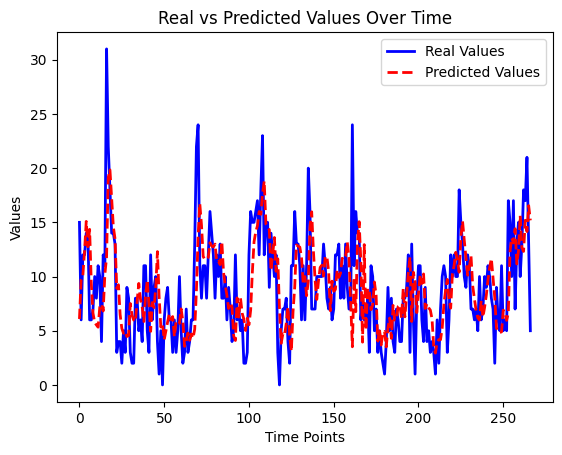

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital8_LastEpoch:
9/9 [==============================] - 1s 9ms/step


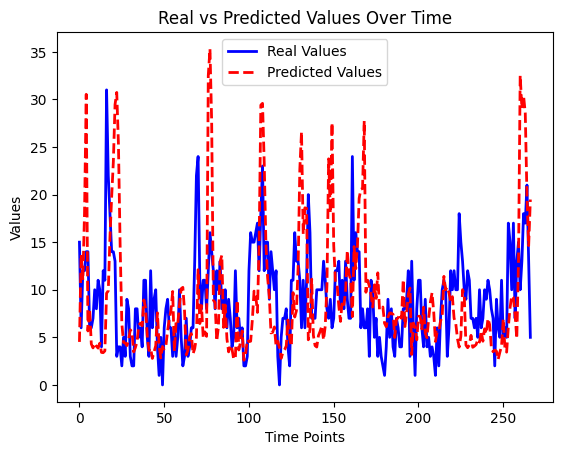

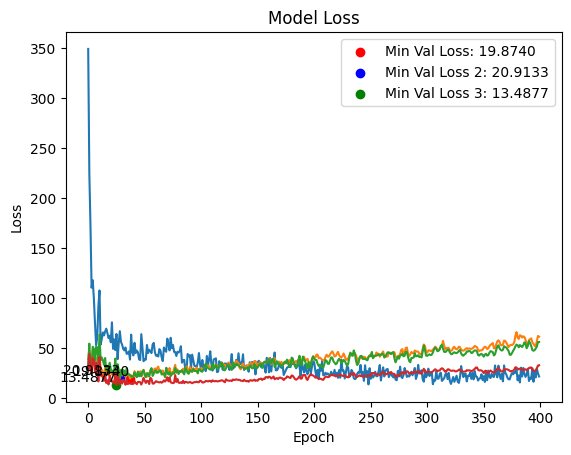

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=9
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 186.6358
loss 1: 265.6877136230469
loss 2: 161.3516387939453
loss 3: 247.53604125976562
Average Loss (Loss2*1.15 and Loss3*1.30): 257.6796506245931
7/7 [==============================] - 13s 337ms/step - loss: 186.6358 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 70.9524
loss 1: 107.10393524169922
loss 2: 55.81449890136719
loss 3: 95.03656005859375
Average Loss (Loss2*1.15 and Loss3*1.30): 98.27937901814778
7/7 [==============================] - 1s 113ms/step - loss: 70.9524 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
5/7 [====================>.........] - ETA: 0s - loss: 69.5480
loss 1: 174.98960876464844
loss 2: 97.7702407836914
loss 3: 153.00502014160156
Average Loss (Loss2*1.15 and Loss3*1.30): 162.1106372833252
7/7 [==============================] - 1s 77ms/step - loss: 69.5309 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
6/7 [========================>.....] - ETA: 0s - loss: 59.9871
loss 1: 153.5704803466797
loss 2: 84.19009399414062
loss 3: 131.1470184326172
Average Loss (Loss2*1.15 and Loss3*1.30): 140.29340413411458
7/7 [==============================] - 0s 72ms/step - loss: 59.0300 - lr: 0.001

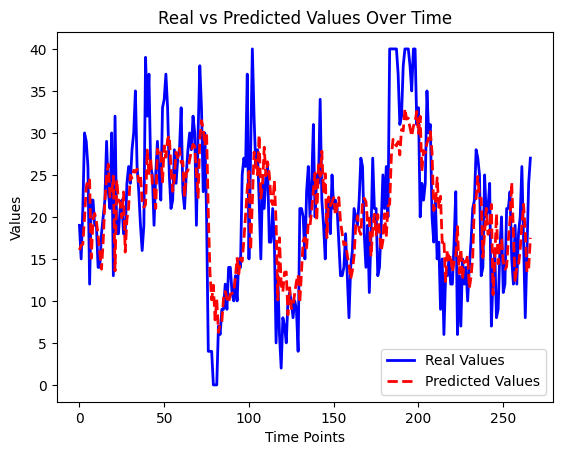

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital9_LastEpoch:
9/9 [==============================] - 1s 10ms/step


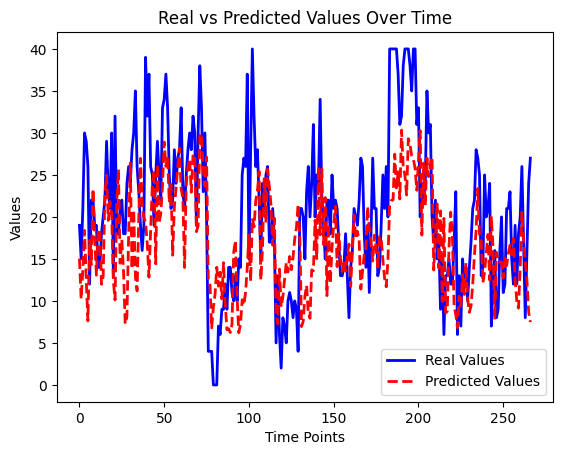

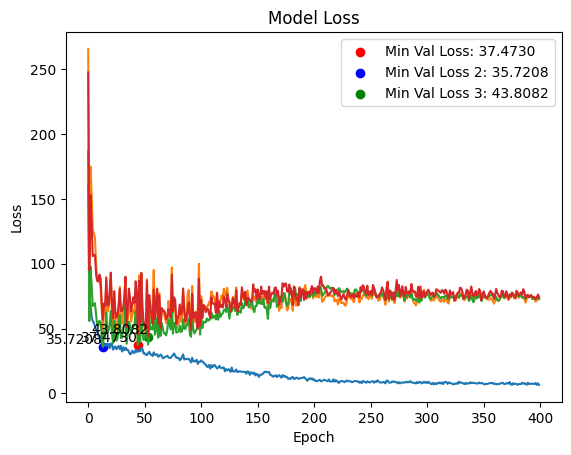

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=10
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 390.1545
loss 1: 826.0035400390625
loss 2: 819.7694702148438
loss 3: 791.9734497070312
Average Loss (Loss2*1.15 and Loss3*1.30): 932.7679718017579
7/7 [==============================] - 13s 457ms/step - loss: 390.1545 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 182.8354
loss 1: 369.6666564941406
loss 2: 284.5530700683594
loss 3: 393.740478515625
Average Loss (Loss2*1.15 and Loss3*1.30): 402.92176971435543
7/7 [==============================] - 1s 155ms/step - loss: 182.8354 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 155.4624
loss 1: 510.4533386230469
loss 2: 458.91534423828125
loss 3: 546.83154296875
Average Loss (Loss2*1.15 and Loss3*1.30): 583.0289967854818
7/7 [==============================] - 1s 126ms/step - loss: 155.4624 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 132.6360
loss 1: 350.4516296386719
loss 2: 324.030517578125
loss 3: 452.70843505859375
Average Loss (Loss2*1.15 and Loss3*1.30): 437.2025634765625
7/7 [==============================] - 1s 122ms/step - loss: 132.6360 - lr: 0

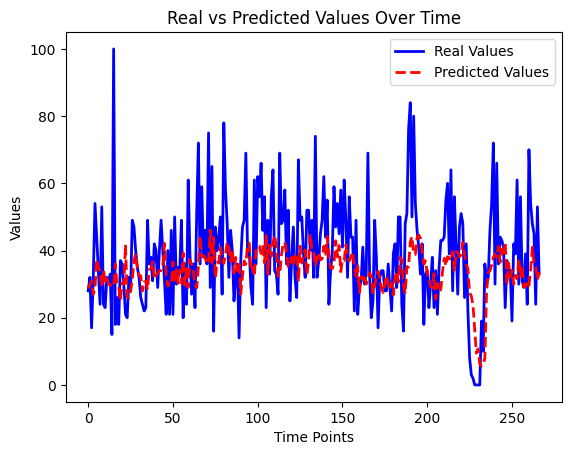

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital10_LastEpoch:
9/9 [==============================] - 1s 9ms/step


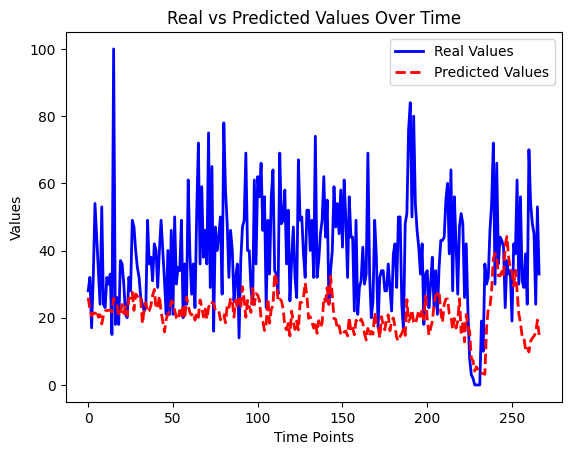

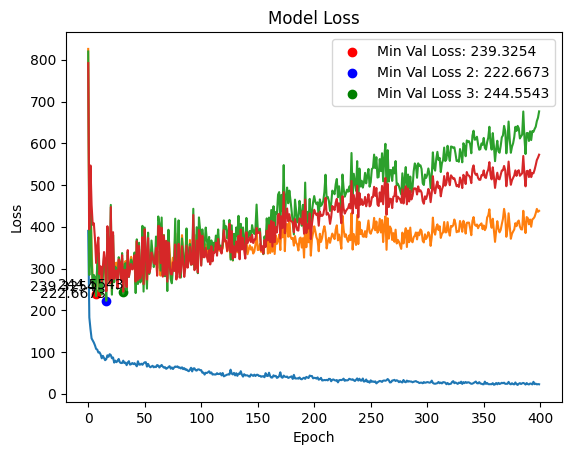

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=11
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 48.2261
loss 1: 31.880107879638672
loss 2: 15.538991928100586
loss 3: 29.343788146972656
Average Loss (Loss2*1.15 and Loss3*1.30): 29.298957729339595
7/7 [==============================] - 13s 419ms/step - loss: 48.2261 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 27.3556
loss 1: 32.234832763671875
loss 2: 12.771328926086426
loss 3: 24.97971534729004
Average Loss (Loss2*1.15 and Loss3*1.30): 26.465163660049438
7/7 [==============================] - 1s 127ms/step - loss: 27.3556 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 23.6192
loss 1: 32.09536361694336
loss 2: 11.891912460327148
loss 3: 22.83719253540039
Average Loss (Loss2*1.15 and Loss3*1.30): 25.153137747446696
7/7 [==============================] - 1s 111ms/step - loss: 23.6192 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 23.3822
loss 1: 28.00445556640625
loss 2: 11.525325775146484
loss 3: 19.865449905395508
Average Loss (Loss2*1.15 and Loss3*1.30): 22.36122169494629
7/7 [==============================] - 1s 110ms/step - loss: 23.3822 - lr:

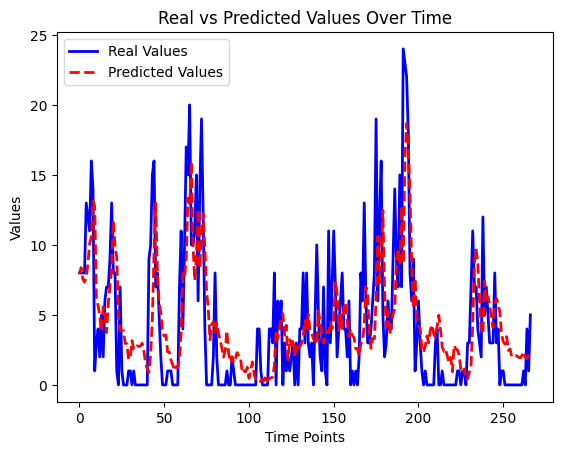

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital11_LastEpoch:
9/9 [==============================] - 2s 10ms/step


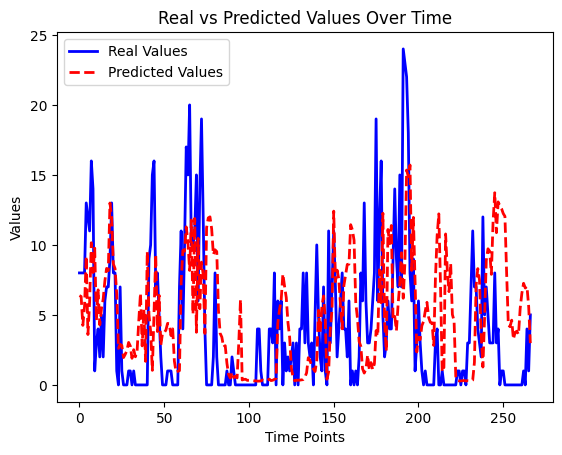

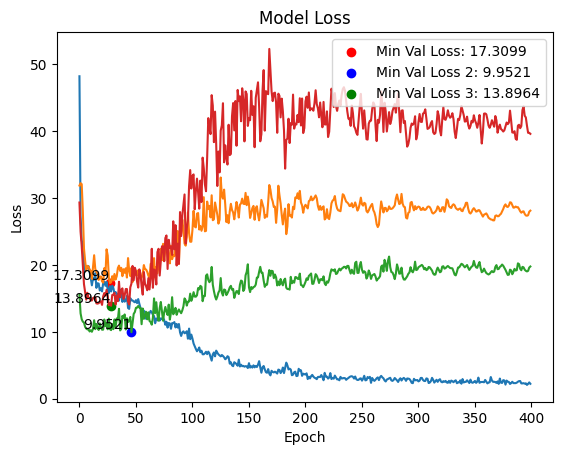

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=12
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 1.8812
loss 1: 0.010785222984850407
loss 2: 17.458982467651367
loss 3: 52.30160903930664
Average Loss (Loss2*1.15 and Loss3*1.30): 29.360235603960856
7/7 [==============================] - 13s 329ms/step - loss: 1.8812 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - ETA: 0s - loss: 1.8016
loss 1: 0.0014280886389315128
loss 2: 17.164648056030273
loss 3: 49.06046676635742
Average Loss (Loss2*1.15 and Loss3*1.30): 27.839793383112802
7/7 [==============================] - 1s 117ms/step - loss: 1.8016 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
7/7 [==============================] - ETA: 0s - loss: 1.5481
loss 1: 0.0007737191626802087
loss 2: 16.11086654663086
loss 3: 43.383628845214844
Average Loss (Loss2*1.15 and Loss3*1.30): 24.975662582189155
7/7 [==============================] - 1s 119ms/step - loss: 1.5481 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
6/7 [========================>.....] - ETA: 0s - loss: 1.3048
loss 1: 0.00026972070918418467
loss 2: 15.139196395874023
loss 3: 38.25126266479492
Average Loss (Loss2*1.15 and Loss3*1.30): 22.378995680065902
7/7 [==============================] - 1s 122ms/step - loss: 1.3059

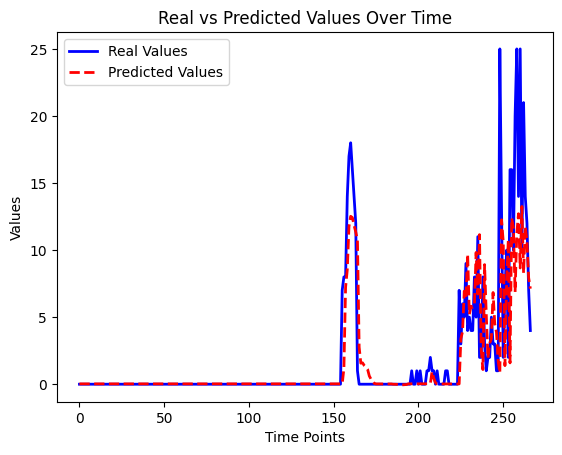

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital12_LastEpoch:
9/9 [==============================] - 2s 11ms/step


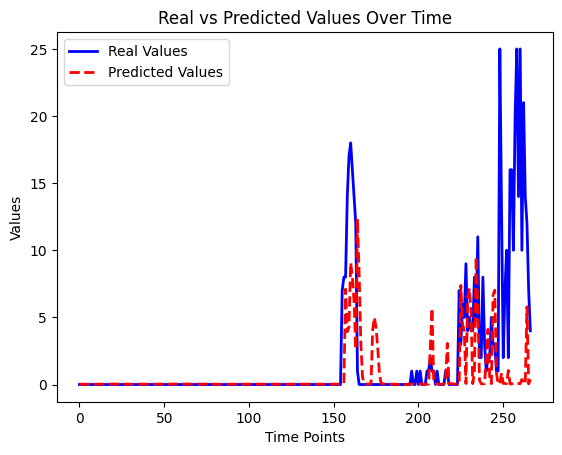

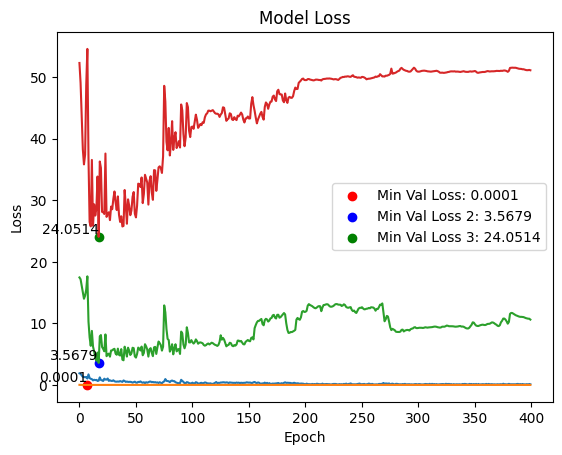

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL WITH SEQ=30 FOR HOSPITAL=13
Train shapes:
(800, 30, 15) (800, 30, 15) (800,) (800,) (800,) (800,)

Test shapes:
(267, 30, 15) (267, 30, 15) (267,) (267,) (267,) (267,)

Validation shapes:
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(88, 30, 15) (88, 30, 15) (88,) (88,) (88,) (88,)
(91, 30, 15) (91, 30, 15) (91,) (91,) (91,) (91,)

Epoch 1: LearningRateScheduler setting learning rate to 0.001.
Epoch 1/400
7/7 [==============================] - ETA: 0s - loss: 48110.5938
loss 1: 44791.546875
loss 2: 76963.1953125
loss 3: 67102.8515625
Average Loss (Loss2*1.15 and Loss3*1.30): 73510.97617187501


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/7 [==============================] - 12s 417ms/step - loss: 48110.5938 - lr: 0.0010

Epoch 2: LearningRateScheduler setting learning rate to 0.001.
Epoch 2/400
7/7 [==============================] - ETA: 0s - loss: 25122.9121
loss 1: 15647.55859375
loss 2: 29283.244140625
loss 3: 22419.896484375
Average Loss (Loss2*1.15 and Loss3*1.30): 26156.384928385418
7/7 [==============================] - 1s 182ms/step - loss: 25122.9121 - lr: 0.0010

Epoch 3: LearningRateScheduler setting learning rate to 0.001.
Epoch 3/400
6/7 [========================>.....] - ETA: 0s - loss: 9931.1611
loss 1: 6077.91064453125
loss 2: 7641.36669921875
loss 3: 3941.983154296875
Average Loss (Loss2*1.15 and Loss3*1.30): 6663.353483072916
7/7 [==============================] - 1s 170ms/step - loss: 9837.9336 - lr: 0.0010

Epoch 4: LearningRateScheduler setting learning rate to 0.001.
Epoch 4/400
7/7 [==============================] - ETA: 0s - loss: 9164.3301
loss 1: 9121.4267578125
loss 2: 16326.1474609375
loss

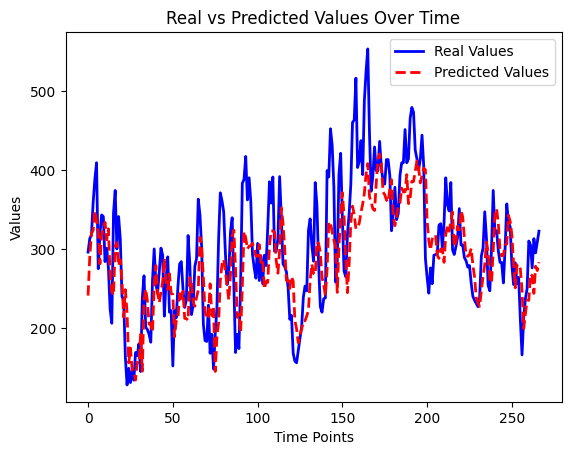

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 1/M1_seq30_Hospital13_LastEpoch:
9/9 [==============================] - 1s 10ms/step


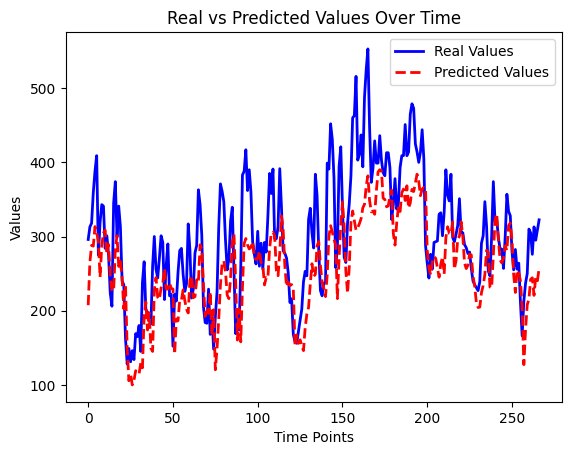

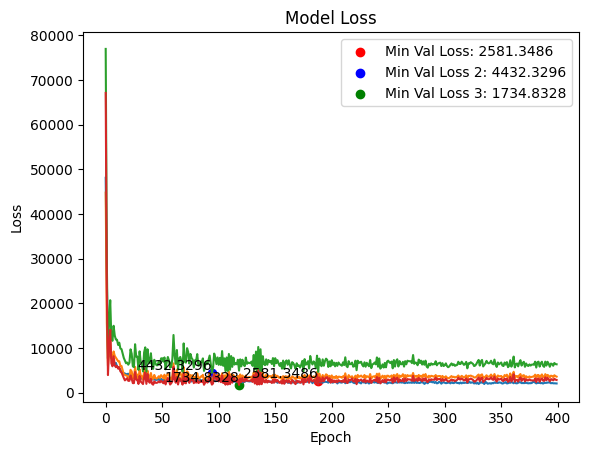

In [ ]:
# Train Model for Model_1 using seq = 30
seq = 30
for i in range (1,14):
  print('↔ ' * 60)
  print(f'TRAINING MODEL WITH SEQ={seq} FOR HOSPITAL={i}')
  hospital = i
  firstLabel = datetime(2020, 1, seq)
  if hospital == 7: firstLabel = datetime(2021, 1, 23)
  lastLabel = datetime(2022, 12, 31)
  generated_DF=generateDataset(firstLabel,lastLabel,hospital,seq)
  generated_labels = generateLabels(firstLabel, lastLabel,hospital)
  m,h,cb=Model_1(generated_DF,generated_labels ,1 ,ModelName = f'/content/drive/MyDrive/Hamedan Models/Model 1/M1_seq{seq}_Hospital{hospital}',trainRatio = 0.75, plotModel=True , Epochs = 400)
  print()
  PlotUsingValidationData(h,cb)

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=1
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 862.3538  
loss 1: 54.06099319458008
loss 2: 194.65090942382812
loss 3: 579.9715576171875
Average Loss (Loss2*1.15 and Loss3*1.30): 343.957521311442


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


9/9 [==============================] - 11s 153ms/step - loss: 809.8595
Epoch 2/400
8/9 [=========================>....] - ETA: 0s - loss: 312.6781
loss 1: 344.03765869140625
loss 2: 246.62030029296875
loss 3: 283.38458251953125
Average Loss (Loss2*1.15 and Loss3*1.30): 332.016987101237
9/9 [==============================] - 0s 43ms/step - loss: 311.0611
Epoch 3/400
8/9 [=========================>....] - ETA: 0s - loss: 287.9988
loss 1: 130.5595245361328
loss 2: 177.12025451660156
loss 3: 413.0577392578125
Average Loss (Loss2*1.15 and Loss3*1.30): 290.4076260884603
9/9 [==============================] - 0s 43ms/step - loss: 286.8100
Epoch 4/400
8/9 [=========================>....] - ETA: 0s - loss: 271.8472
loss 1: 288.15362548828125
loss 2: 221.25408935546875
loss 3: 300.45379638671875
Average Loss (Loss2*1.15 and Loss3*1.30): 311.0619211832682
9/9 [==============================] - 0s 34ms/step - loss: 268.5604
Epoch 5/400
8/9 [=========================>....] - ETA: 0s - loss: 251.756

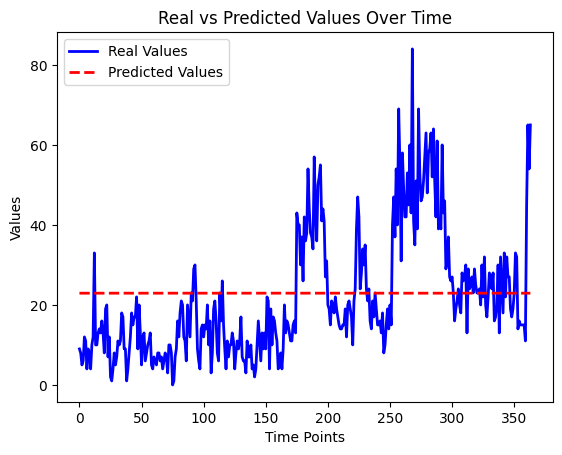

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital1_LastEpoch:
12/12 [==============================] - 1s 4ms/step


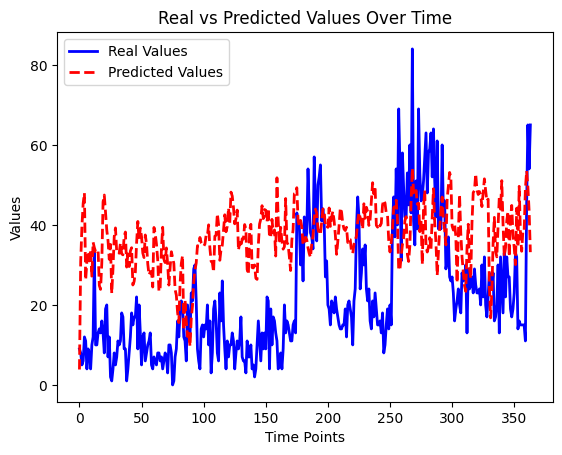

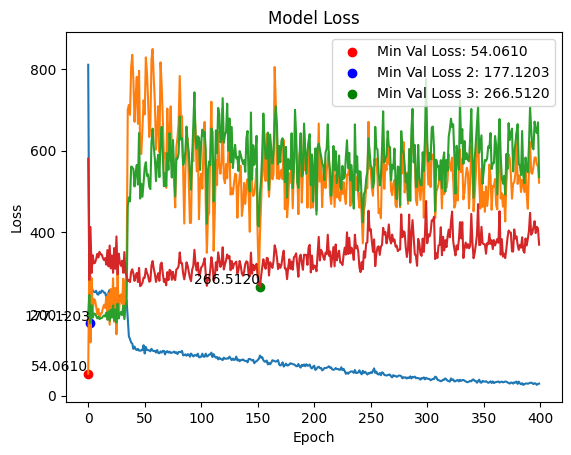

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=2
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
5/9 [===============>..............] - ETA: 0s - loss: 3310.5552 
loss 1: 339.49224853515625
loss 2: 431.5599060058594
loss 3: 1060.119873046875
Average Loss (Loss2*1.15 and Loss3*1.30): 737.9806584676107
9/9 [==============================] - 7s 188ms/step - loss: 3213.0532
Epoch 2/400
6/9 [===================>..........] - ETA: 0s - loss: 1607.5020

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 1488.8167724609375
loss 2: 1144.496337890625
loss 3: 573.0462036132812
Average Loss (Loss2*1.15 and Loss3*1.30): 1183.3158752441407
9/9 [==============================] - 0s 46ms/step - loss: 1476.4088
Epoch 3/400
5/9 [===============>..............] - ETA: 0s - loss: 1212.2583
loss 1: 732.0609741210938
loss 2: 524.9912719726562
loss 3: 316.4580993652344
Average Loss (Loss2*1.15 and Loss3*1.30): 582.3988220214843
9/9 [==============================] - 0s 56ms/step - loss: 1212.9279
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 1125.0967
loss 1: 652.3316040039062
loss 2: 465.1253967285156
loss 3: 308.85980224609375
Average Loss (Loss2*1.15 and Loss3*1.30): 529.5811843872069
9/9 [==============================] - 0s 46ms/step - loss: 1170.5707
Epoch 5/400
7/9 [======================>.......] - ETA: 0s - loss: 1122.9991
loss 1: 952.099609375
loss 2: 697.6478271484375
loss 3: 364.5202331542969
Average Loss (Loss2*1.15 and Loss3*1.30): 742.7569712320964
9/9 [==

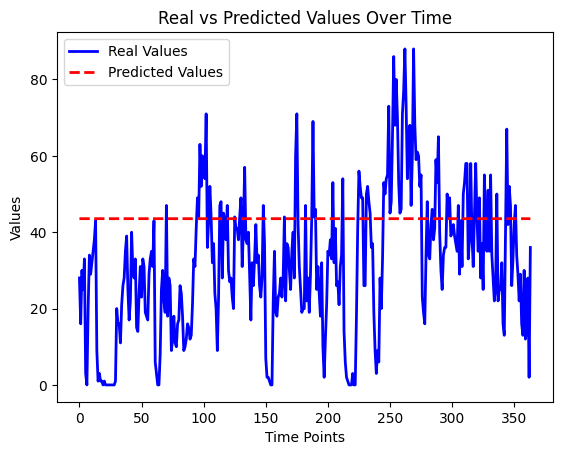

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital2_LastEpoch:
12/12 [==============================] - 1s 5ms/step


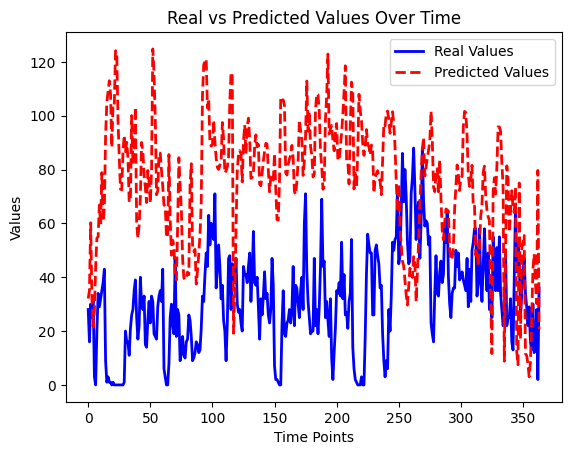

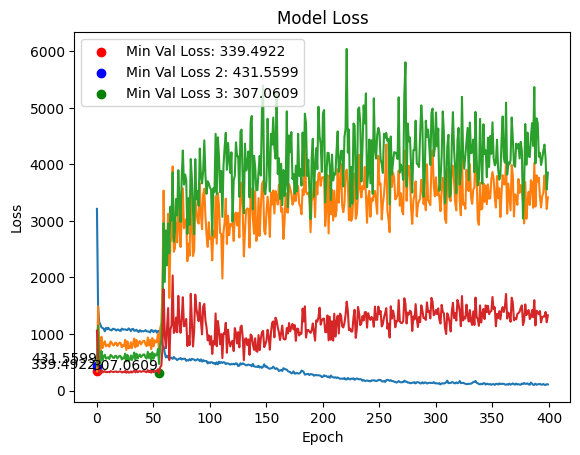

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=3
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
6/9 [===================>..........] - ETA: 0s - loss: 12976.6279 
loss 1: 4780.5625
loss 2: 6560.47802734375
loss 3: 19307.76953125
Average Loss (Loss2*1.15 and Loss3*1.30): 12475.070874023439
9/9 [==============================] - 6s 218ms/step - loss: 12624.6758
Epoch 2/400
5/9 [===============>..............] - ETA: 0s - loss: 8301.8242 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


9/9 [==============================] - ETA: 0s - loss: 6835.6587
loss 1: 4144.60693359375
loss 2: 3071.800537109375
loss 3: 7296.7021484375
Average Loss (Loss2*1.15 and Loss3*1.30): 5720.963448079427
9/9 [==============================] - 1s 61ms/step - loss: 6835.6587
Epoch 3/400
5/9 [===============>..............] - ETA: 0s - loss: 3028.1040
loss 1: 8684.9501953125
loss 2: 5234.16357421875
loss 3: 2598.25439453125
Average Loss (Loss2*1.15 and Loss3*1.30): 6027.323006184895
9/9 [==============================] - 0s 51ms/step - loss: 3427.1663
Epoch 4/400
6/9 [===================>..........] - ETA: 0s - loss: 3342.5603
loss 1: 5009.1728515625
loss 2: 3236.04638671875
loss 3: 5440.73291015625
Average Loss (Loss2*1.15 and Loss3*1.30): 5267.8596598307295
9/9 [==============================] - 1s 63ms/step - loss: 3252.0010
Epoch 5/400
9/9 [==============================] - ETA: 0s - loss: 3066.5176
loss 1: 5031.4794921875
loss 2: 3243.695068359375
loss 3: 5406.10205078125
Average Loss (L

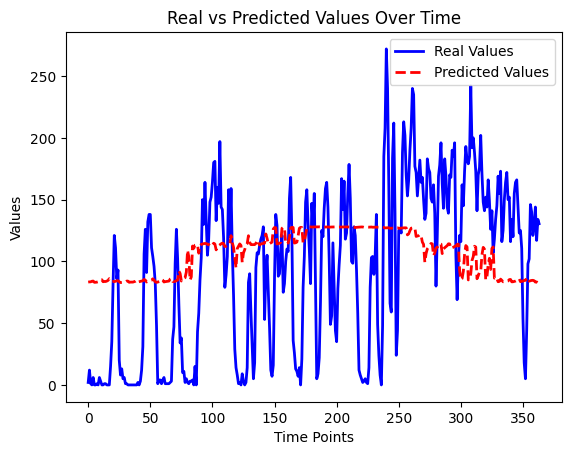

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital3_LastEpoch:
12/12 [==============================] - 1s 6ms/step


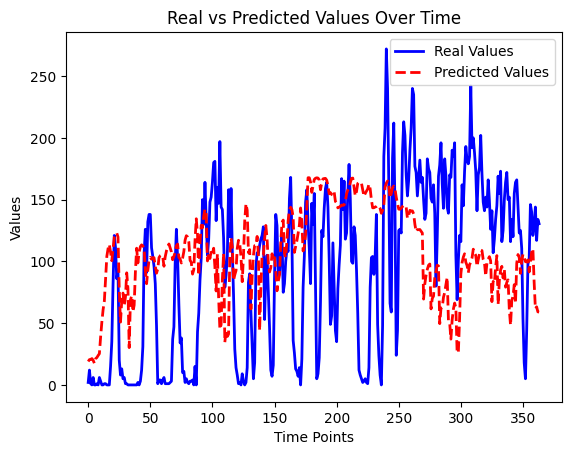

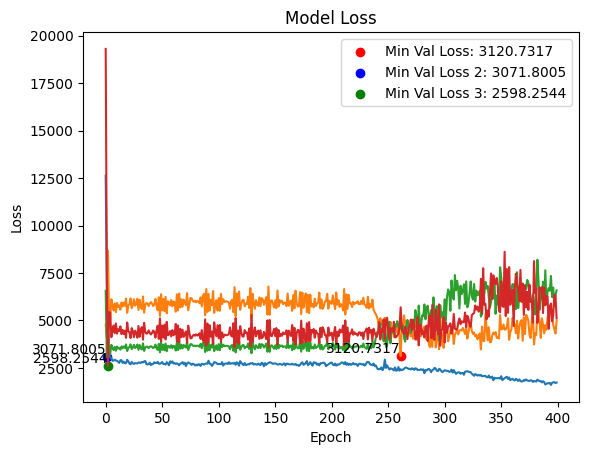

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=4
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
6/9 [===================>..........] - ETA: 0s - loss: 23.9120 
loss 1: 5.305970191955566
loss 2: 21.673179626464844
loss 3: 7.1814446449279785
Average Loss (Loss2*1.15 and Loss3*1.30): 13.188668266932169
9/9 [==============================] - 6s 186ms/step - loss: 22.7958
Epoch 2/400
6/9 [===================>..........] - ETA: 0s - loss: 19.1250

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 4.180480480194092
loss 2: 22.40706443786621
loss 3: 7.523123741149902
Average Loss (Loss2*1.15 and Loss3*1.30): 13.2428884824117
9/9 [==============================] - 0s 49ms/step - loss: 18.4696
Epoch 3/400
6/9 [===================>..........] - ETA: 0s - loss: 18.1399
loss 1: 3.8551712036132812
loss 2: 22.212955474853516
loss 3: 7.585227012634277
Average Loss (Loss2*1.15 and Loss3*1.30): 13.086955038706462
9/9 [==============================] - 0s 60ms/step - loss: 17.9603
Epoch 4/400
8/9 [=========================>....] - ETA: 0s - loss: 17.5193
loss 1: 3.5957143306732178
loss 2: 22.32068634033203
loss 3: 7.938833236694336
Average Loss (Loss2*1.15 and Loss3*1.30): 13.19499560991923
9/9 [==============================] - 0s 54ms/step - loss: 17.6773
Epoch 5/400
5/9 [===============>..............] - ETA: 0s - loss: 16.1364
loss 1: 3.5891213417053223
loss 2: 24.452205657958984
loss 3: 8.735654830932617
Average Loss (Loss2*1.15 and Loss3*1.30): 14.355169709523517
9/9 [=======

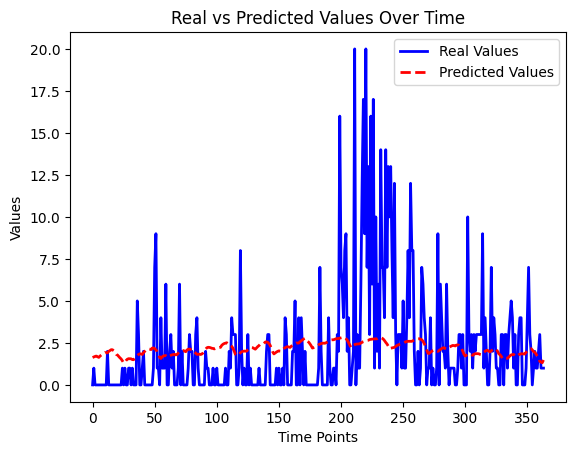

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital4_LastEpoch:
12/12 [==============================] - 1s 4ms/step


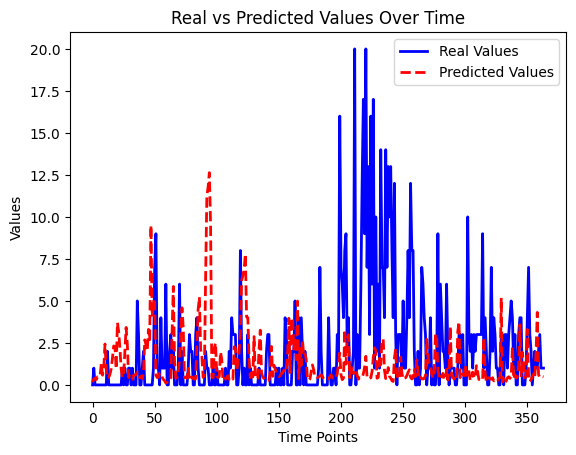

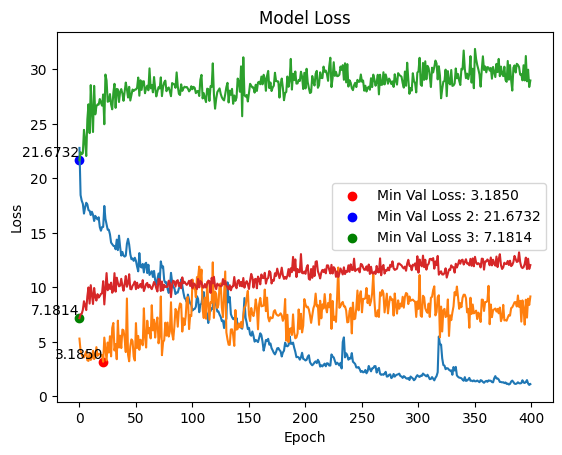

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=5
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
6/9 [===================>..........] - ETA: 0s - loss: 591.9042 
loss 1: 654.0316772460938
loss 2: 1307.268798828125
loss 3: 1209.0865478515625
Average Loss (Loss2*1.15 and Loss3*1.30): 1243.0677693684895
9/9 [==============================] - 6s 135ms/step - loss: 543.8226
Epoch 2/400
6/9 [===================>..........] - ETA: 0s - loss: 238.5247

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 171.79283142089844
loss 2: 532.6260375976562
loss 3: 702.5924682617188
Average Loss (Loss2*1.15 and Loss3*1.30): 565.8943277994791
9/9 [==============================] - 0s 56ms/step - loss: 228.6492
Epoch 3/400
5/9 [===============>..............] - ETA: 0s - loss: 203.8212
loss 1: 299.01580810546875
loss 2: 794.6749267578125
loss 3: 846.3522338867188
Average Loss (Loss2*1.15 and Loss3*1.30): 771.0499593098958
9/9 [==============================] - 0s 49ms/step - loss: 194.4844
Epoch 4/400
9/9 [==============================] - ETA: 0s - loss: 189.6109
loss 1: 228.8533172607422
loss 2: 663.0203247070312
loss 3: 768.7762451171875
Average Loss (Loss2*1.15 and Loss3*1.30): 663.578603108724
9/9 [==============================] - 0s 56ms/step - loss: 189.6109
Epoch 5/400
5/9 [===============>..............] - ETA: 0s - loss: 180.5475
loss 1: 261.4804382324219
loss 2: 726.4778442382812
loss 3: 805.1329345703125
Average Loss (Loss2*1.15 and Loss3*1.30): 714.5342580159505
9/9 [======

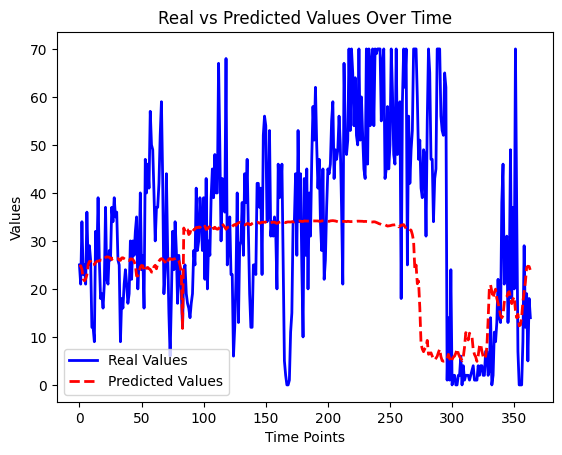

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital5_LastEpoch:
12/12 [==============================] - 1s 4ms/step


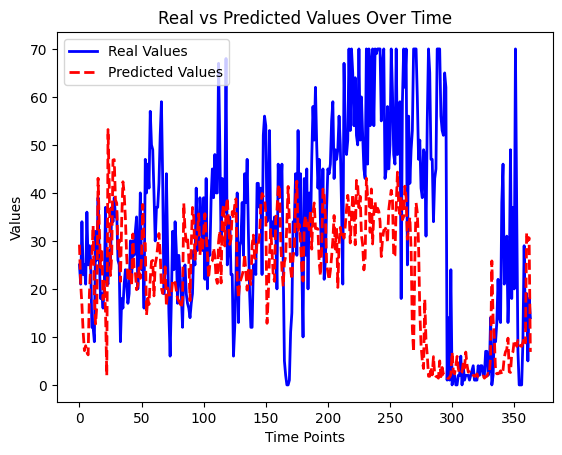

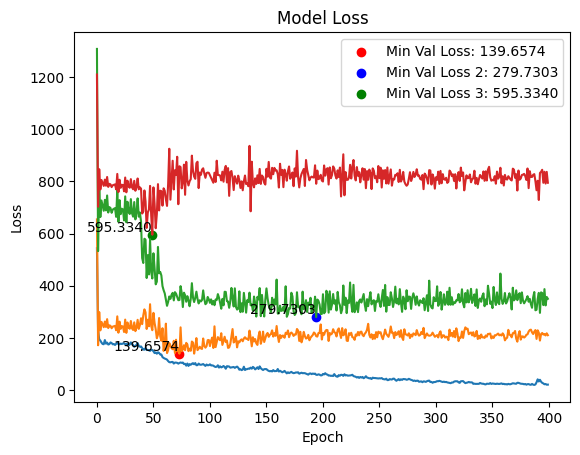

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=6
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
5/9 [===============>..............] - ETA: 0s - loss: 118.3025 
loss 1: 29.78037452697754
loss 2: 40.691162109375
loss 3: 42.11077117919922
Average Loss (Loss2*1.15 and Loss3*1.30): 43.77307116190593
9/9 [==============================] - 5s 135ms/step - loss: 102.0427
Epoch 2/400
6/9 [===================>..........] - ETA: 0s - loss: 43.0365

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 15.015410423278809
loss 2: 28.354280471801758
loss 3: 25.04660415649414
Average Loss (Loss2*1.15 and Loss3*1.30): 26.727806123097736
9/9 [==============================] - 1s 67ms/step - loss: 40.8135
Epoch 3/400
5/9 [===============>..............] - ETA: 0s - loss: 37.7740
loss 1: 41.58211135864258
loss 2: 47.327903747558594
loss 3: 55.63685989379883
Average Loss (Loss2*1.15 and Loss3*1.30): 56.112372843424474
9/9 [==============================] - 0s 47ms/step - loss: 37.9825
Epoch 4/400
5/9 [===============>..............] - ETA: 0s - loss: 35.1475
loss 1: 22.66182518005371
loss 2: 32.79764938354492
loss 3: 34.346649169921875
Average Loss (Loss2*1.15 and Loss3*1.30): 35.0099219640096
9/9 [==============================] - 0s 47ms/step - loss: 35.8822
Epoch 5/400
5/9 [===============>..............] - ETA: 0s - loss: 35.5921
loss 1: 36.069522857666016
loss 2: 42.75358963012695
loss 3: 49.56132507324219
Average Loss (Loss2*1.15 and Loss3*1.30): 49.88862450917562
9/9 [=======

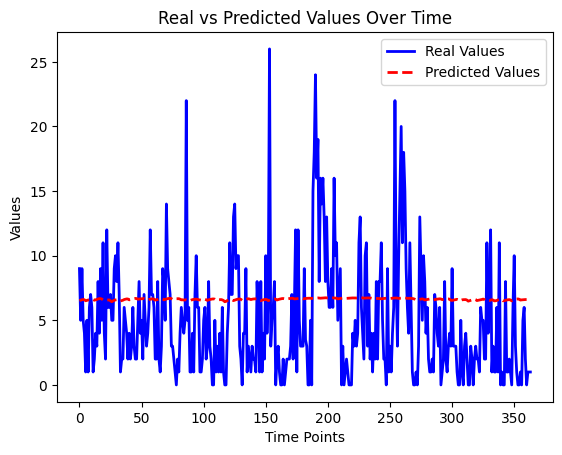

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital6_LastEpoch:
12/12 [==============================] - 1s 4ms/step


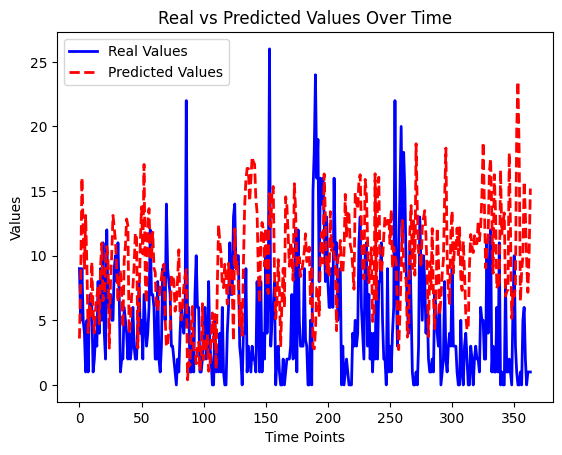

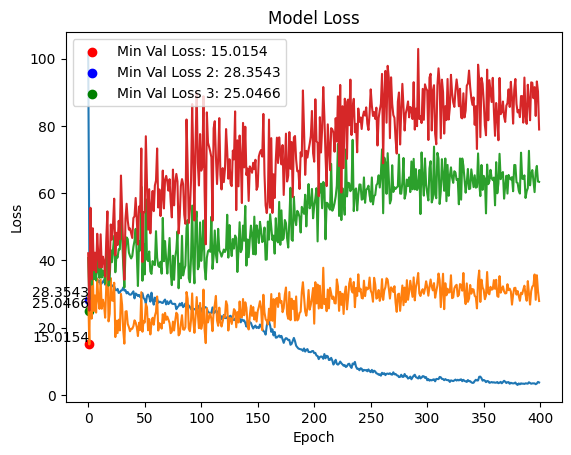

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=7
Train shapes:
(549, 7, 14) (549,)

Test shapes:
(183, 7, 14) (183,)

Validation shapes:
(60, 7, 14) (60,)
(60, 7, 14) (60,)
(63, 7, 14) (63,)
Epoch 1/400
1/5 [=====>........................] - ETA: 16s - loss: 68.9973
loss 1: 97.07286834716797
loss 2: 17.508899688720703
loss 3: 5.928891181945801
Average Loss (Loss2*1.15 and Loss3*1.30): 41.638553841908774
5/5 [==============================] - 5s 256ms/step - loss: 66.5560
Epoch 2/400
1/5 [=====>........................] - ETA: 0s - loss: 65.4950

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 49.85420227050781
loss 2: 33.99258804321289
loss 3: 26.55841827392578
Average Loss (Loss2*1.15 and Loss3*1.30): 41.15720742543538
5/5 [==============================] - 0s 84ms/step - loss: 44.4209
Epoch 3/400
1/5 [=====>........................] - ETA: 0s - loss: 42.0750
loss 1: 61.827735900878906
loss 2: 15.657357215881348
loss 3: 7.486240863800049
Average Loss (Loss2*1.15 and Loss3*1.30): 29.85526994069417
5/5 [==============================] - 0s 81ms/step - loss: 38.7413
Epoch 4/400
1/5 [=====>........................] - ETA: 0s - loss: 38.9081
loss 1: 61.72256088256836
loss 2: 15.757421493530273
loss 3: 7.506989002227783
Average Loss (Loss2*1.15 and Loss3*1.30): 29.867560434341428
5/5 [==============================] - 0s 63ms/step - loss: 35.1906
Epoch 5/400
1/5 [=====>........................] - ETA: 0s - loss: 25.6723
loss 1: 53.36500549316406
loss 2: 22.39944076538086
loss 3: 14.33349895477295
Average Loss (Loss2*1.15 and Loss3*1.30): 32.58597033818563
5/5 [=========

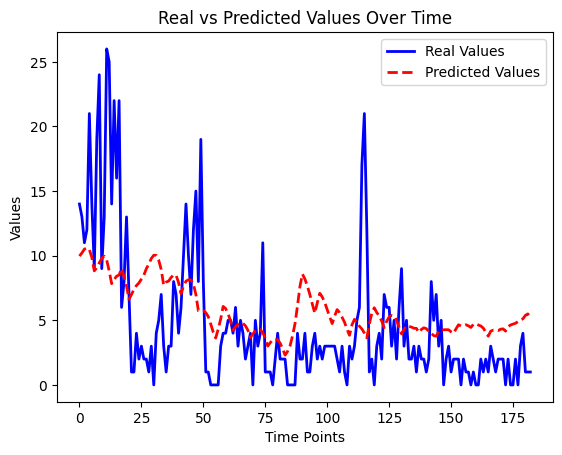

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital7_LastEpoch:
6/6 [==============================] - 1s 5ms/step


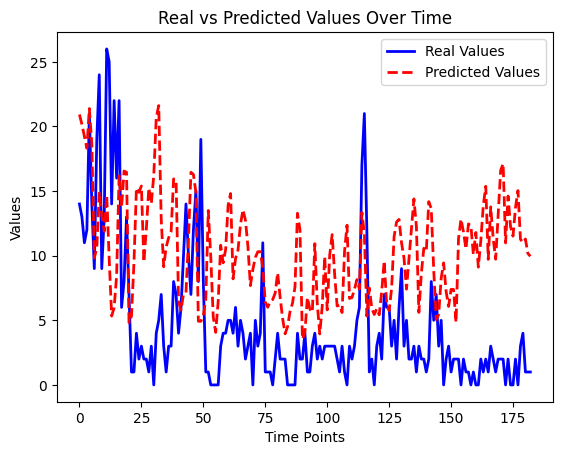

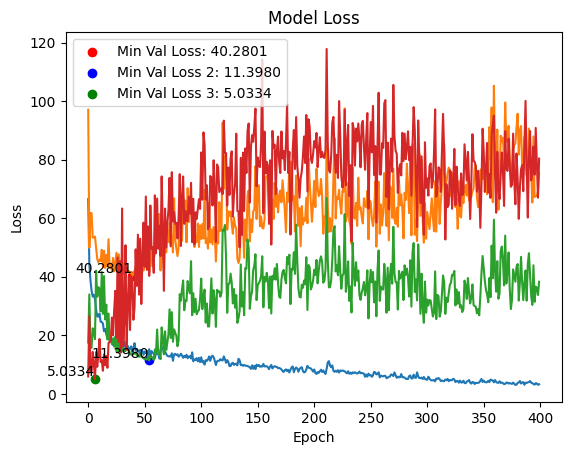

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=8
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
6/9 [===================>..........] - ETA: 0s - loss: 309.1634 
loss 1: 58.16585922241211
loss 2: 54.12845993041992
loss 3: 41.222713470458984
Average Loss (Loss2*1.15 and Loss3*1.30): 58.001038551330566
9/9 [==============================] - 8s 140ms/step - loss: 298.8393
Epoch 2/400
6/9 [===================>..........] - ETA: 0s - loss: 226.3085

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 65.36166381835938
loss 2: 22.985942840576172
loss 3: 21.193069458007812
Average Loss (Loss2*1.15 and Loss3*1.30): 39.782162793477376
9/9 [==============================] - 0s 52ms/step - loss: 249.6421
Epoch 3/400
7/9 [======================>.......] - ETA: 0s - loss: 249.3994
loss 1: 50.17115783691406
loss 2: 28.893468856811523
loss 3: 22.840442657470703
Average Loss (Loss2*1.15 and Loss3*1.30): 37.6970741589864
9/9 [==============================] - 0s 47ms/step - loss: 246.9277
Epoch 4/400
6/9 [===================>..........] - ETA: 0s - loss: 270.0714
loss 1: 61.72751998901367
loss 2: 30.001392364501953
loss 3: 33.34921646118164
Average Loss (Loss2*1.15 and Loss3*1.30): 46.52770086924235
9/9 [==============================] - 0s 38ms/step - loss: 242.0351
Epoch 5/400
7/9 [======================>.......] - ETA: 0s - loss: 244.2082
loss 1: 46.33917236328125
loss 2: 42.3018798828125
loss 3: 37.940696716308594
Average Loss (Loss2*1.15 and Loss3*1.30): 48.103079986572276
9/9 [=

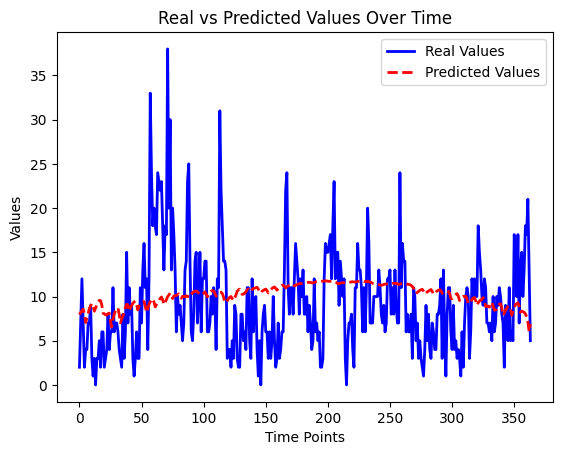

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital8_LastEpoch:
12/12 [==============================] - 1s 4ms/step


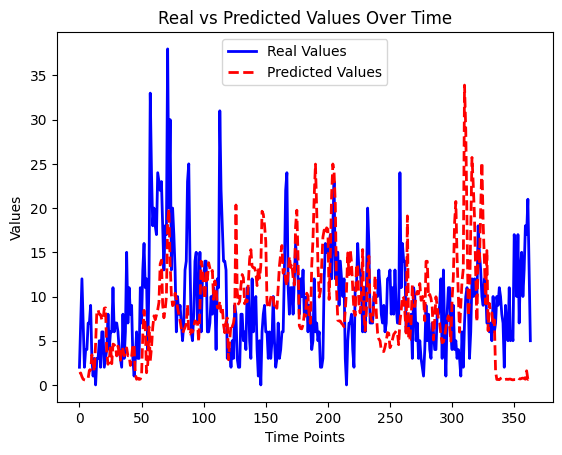

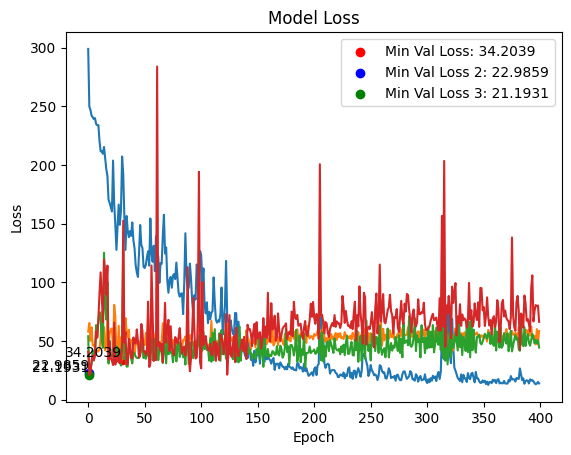

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=9
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 242.8197 
loss 1: 122.65213012695312
loss 2: 217.34889221191406
loss 3: 215.6090545654297
Average Loss (Loss2*1.15 and Loss3*1.30): 217.6317090352376
9/9 [==============================] - 6s 131ms/step - loss: 221.7366
Epoch 2/400
7/9 [======================>.......] - ETA: 0s - loss: 65.4355

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 131.6385955810547
loss 2: 139.10894775390625
loss 3: 128.7299346923828
Average Loss (Loss2*1.15 and Loss3*1.30): 152.98760019938152
9/9 [==============================] - 0s 49ms/step - loss: 65.9451
Epoch 3/400
6/9 [===================>..........] - ETA: 0s - loss: 57.0173
loss 1: 125.91261291503906
loss 2: 152.4332733154297
loss 3: 142.46360778808594
Average Loss (Loss2*1.15 and Loss3*1.30): 162.1378557840983
9/9 [==============================] - 0s 39ms/step - loss: 57.6663
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 52.8281
loss 1: 138.34576416015625
loss 2: 128.3037567138672
loss 3: 117.39665985107422
Average Loss (Loss2*1.15 and Loss3*1.30): 146.17024739583334
9/9 [==============================] - 0s 46ms/step - loss: 52.7513
Epoch 5/400
6/9 [===================>..........] - ETA: 0s - loss: 52.4354
loss 1: 126.40593719482422
loss 2: 151.01251220703125
loss 3: 140.96432495117188
Average Loss (Loss2*1.15 and Loss3*1.30): 161.10798288981118
9/9 [==

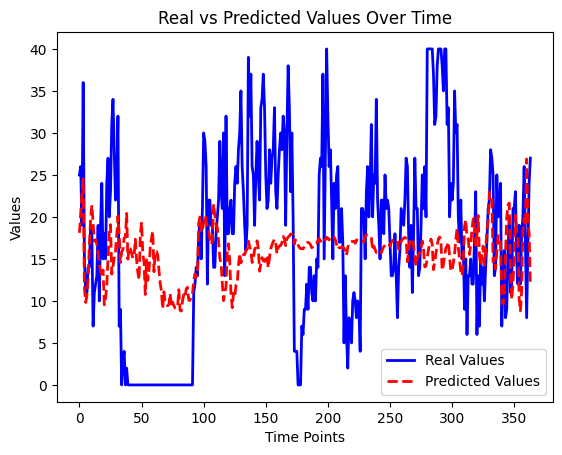

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital9_LastEpoch:
12/12 [==============================] - 1s 4ms/step


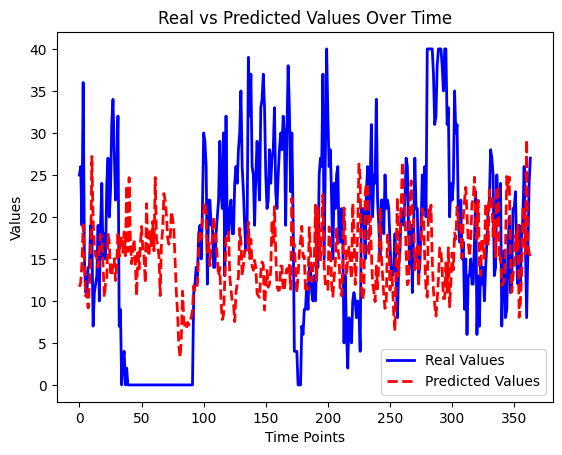

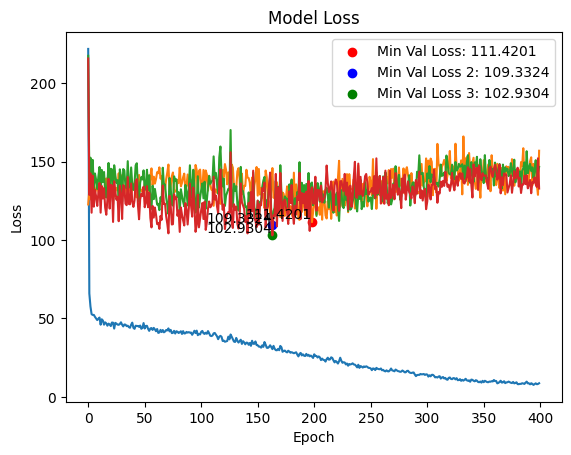

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=10
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
5/9 [===============>..............] - ETA: 0s - loss: 994.0953  
loss 1: 598.016357421875
loss 2: 1397.38818359375
loss 3: 1273.9459228515625
Average Loss (Loss2*1.15 and Loss3*1.30): 1287.047489420573
9/9 [==============================] - 6s 185ms/step - loss: 921.7668
Epoch 2/400
5/9 [===============>..............] - ETA: 0s - loss: 490.4627

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 135.3090362548828
loss 2: 261.2759704589844
loss 3: 294.7562255859375
Average Loss (Loss2*1.15 and Loss3*1.30): 272.9864985148112
9/9 [==============================] - 1s 73ms/step - loss: 425.0209
Epoch 3/400
9/9 [==============================] - ETA: 0s - loss: 361.1390
loss 1: 146.21022033691406
loss 2: 556.208984375
loss 3: 514.293701171875
Average Loss (Loss2*1.15 and Loss3*1.30): 484.8107879638672
9/9 [==============================] - 1s 61ms/step - loss: 361.1390
Epoch 4/400
5/9 [===============>..............] - ETA: 0s - loss: 334.3395
loss 1: 142.55126953125
loss 2: 544.2413330078125
loss 3: 504.5203857421875
Average Loss (Loss2*1.15 and Loss3*1.30): 474.76843465169276
9/9 [==============================] - 0s 51ms/step - loss: 332.2593
Epoch 5/400
6/9 [===================>..........] - ETA: 0s - loss: 320.3936
loss 1: 113.2051773071289
loss 2: 405.4679260253906
loss 3: 394.72430419921875
Average Loss (Loss2*1.15 and Loss3*1.30): 364.2116292317708
9/9 [===========

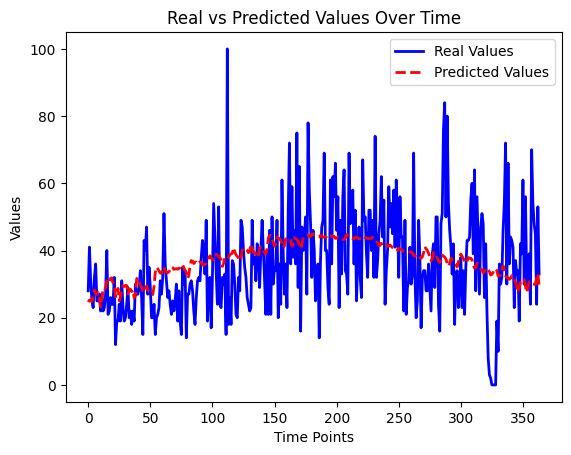

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital10_LastEpoch:
12/12 [==============================] - 1s 4ms/step


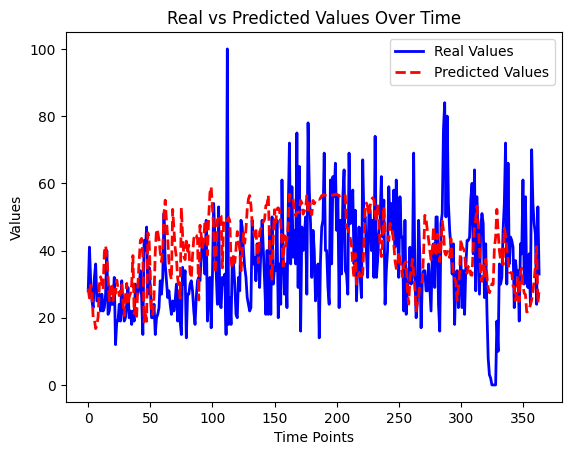

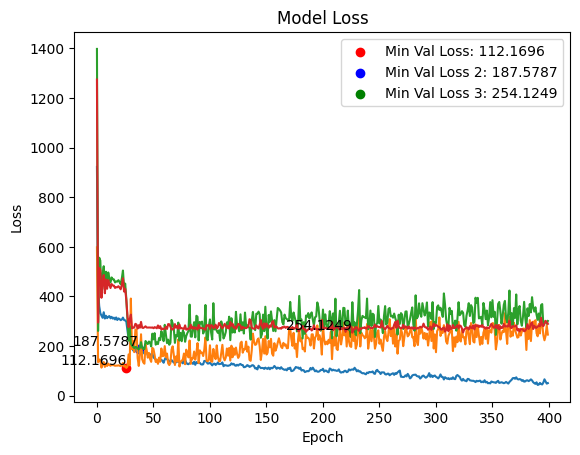

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=11
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
6/9 [===================>..........] - ETA: 0s - loss: 74.3941 
loss 1: 45.88193130493164
loss 2: 31.236671447753906
loss 3: 29.07128143310547
Average Loss (Loss2*1.15 and Loss3*1.30): 39.86558977762858
9/9 [==============================] - 5s 127ms/step - loss: 67.6847
Epoch 2/400
5/9 [===============>..............] - ETA: 0s - loss: 43.4202

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 50.071022033691406
loss 2: 24.855070114135742
loss 3: 26.4305477142334
Average Loss (Loss2*1.15 and Loss3*1.30): 37.671354897816975
9/9 [==============================] - 0s 50ms/step - loss: 39.9050
Epoch 3/400
6/9 [===================>..........] - ETA: 0s - loss: 37.1837
loss 1: 46.0460205078125
loss 2: 31.775829315185547
loss 3: 30.594221115112305
Average Loss (Loss2*1.15 and Loss3*1.30): 40.786903889973956
9/9 [==============================] - 0s 40ms/step - loss: 38.9876
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 35.5034
loss 1: 46.01642608642578
loss 2: 32.00569152832031
loss 3: 30.86857795715332
Average Loss (Loss2*1.15 and Loss3*1.30): 40.98404089609782
9/9 [==============================] - 0s 38ms/step - loss: 36.6572
Epoch 5/400
6/9 [===================>..........] - ETA: 0s - loss: 36.2308
loss 1: 46.02680969238281
loss 2: 31.902637481689453
loss 3: 30.972761154174805
Average Loss (Loss2*1.15 and Loss3*1.30): 40.99314409891765
9/9 [=======

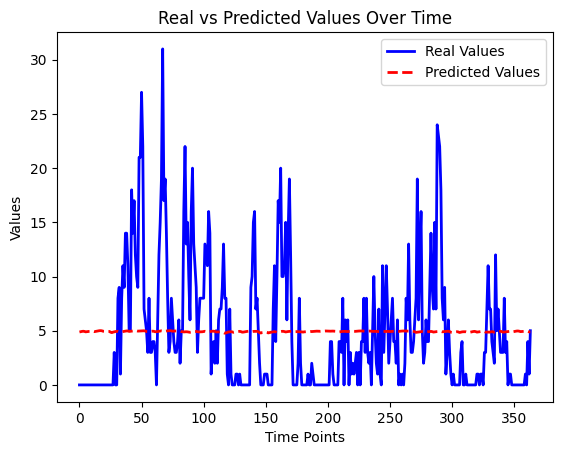

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital11_LastEpoch:
12/12 [==============================] - 1s 5ms/step


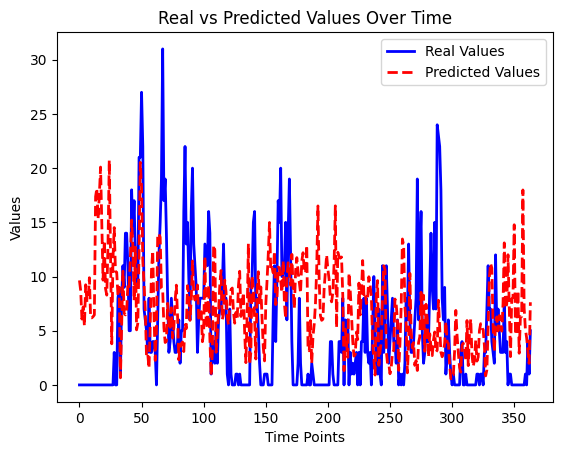

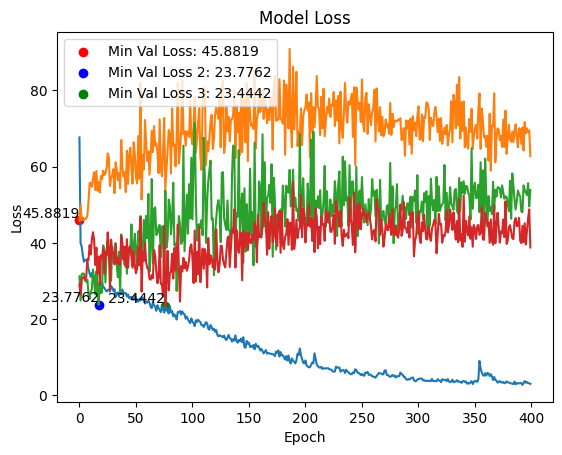

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=12
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
5/9 [===============>..............] - ETA: 0s - loss: 3.4724 
loss 1: 0.5604129433631897
loss 2: 0.17098720371723175
loss 3: 50.697181701660156
Average Loss (Loss2*1.15 and Loss3*1.30): 22.22112814659874
9/9 [==============================] - 7s 163ms/step - loss: 3.3609
Epoch 2/400
6/9 [===================>..........] - ETA: 0s - loss: 4.2341

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 0.645692765712738
loss 2: 1.669121265411377
loss 3: 48.83699035644531
Average Loss (Loss2*1.15 and Loss3*1.30): 22.017756561438244
9/9 [==============================] - 0s 53ms/step - loss: 3.2857
Epoch 3/400
6/9 [===================>..........] - ETA: 0s - loss: 3.6391
loss 1: 0.614074170589447
loss 2: 2.547795057296753
loss 3: 47.72902297973633
Average Loss (Loss2*1.15 and Loss3*1.30): 21.863922786712646
9/9 [==============================] - 0s 51ms/step - loss: 3.0405
Epoch 4/400
6/9 [===================>..........] - ETA: 0s - loss: 3.3716
loss 1: 0.6366236805915833
loss 2: 6.918779373168945
loss 3: 47.10546875
Average Loss (Loss2*1.15 and Loss3*1.30): 23.276776444911956
9/9 [==============================] - 0s 40ms/step - loss: 2.7400
Epoch 5/400
5/9 [===============>..............] - ETA: 0s - loss: 2.3498
loss 1: 0.605807363986969
loss 2: 14.668807983398438
loss 3: 46.80918502807617
Average Loss (Loss2*1.15 and Loss3*1.30): 26.1089590271314
9/9 [=====================

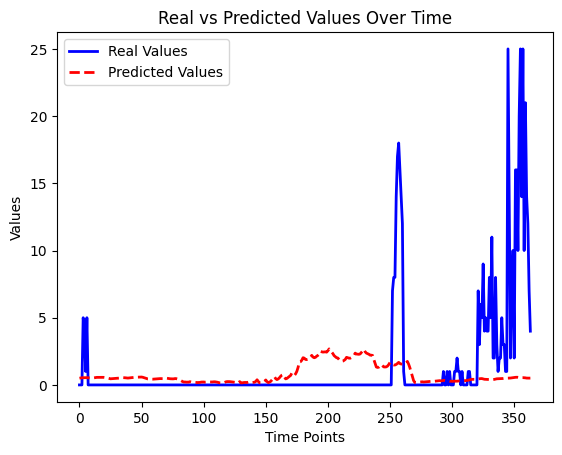

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital12_LastEpoch:
12/12 [==============================] - 1s 4ms/step


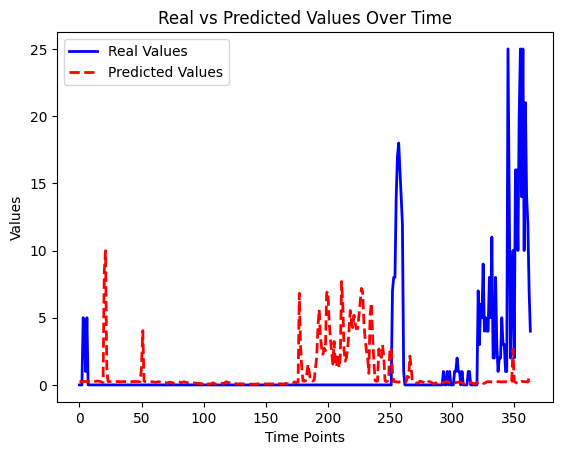

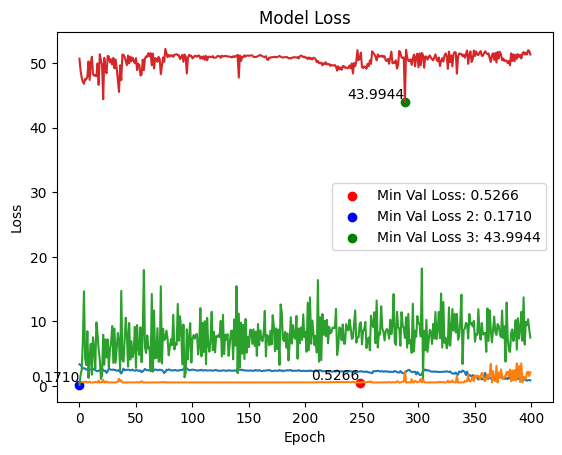

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=7 FOR HOSPITAL=13
Train shapes:
(1091, 7, 14) (1091,)

Test shapes:
(364, 7, 14) (364,)

Validation shapes:
(120, 7, 14) (120,)
(120, 7, 14) (120,)
(124, 7, 14) (124,)
Epoch 1/400
9/9 [==============================] - ETA: 0s - loss: 81508.9531
loss 1: 36646.16796875
loss 2: 65742.8515625
loss 3: 112958.8359375
Average Loss (Loss2*1.15 and Loss3*1.30): 86365.64466145834
9/9 [==============================] - 7s 182ms/step - loss: 81508.9531
Epoch 2/400
7/9 [======================>.......] - ETA: 0s - loss: 69809.6641

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 23866.30078125
loss 2: 46987.3984375
loss 3: 87174.3203125
Average Loss (Loss2*1.15 and Loss3*1.30): 63742.808463541674
9/9 [==============================] - 0s 57ms/step - loss: 67676.3438
Epoch 3/400
7/9 [======================>.......] - ETA: 0s - loss: 45109.6914
loss 1: 8201.7421875
loss 2: 17414.17578125
loss 3: 42529.22265625
Average Loss (Loss2*1.15 and Loss3*1.30): 27838.6779296875
9/9 [==============================] - 0s 50ms/step - loss: 42545.8516
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 15815.4912
loss 1: 21686.322265625
loss 2: 7288.236328125
loss 3: 6822.7509765625
Average Loss (Loss2*1.15 and Loss3*1.30): 12979.1234375
9/9 [==============================] - 0s 50ms/step - loss: 15104.8438
Epoch 5/400
7/9 [======================>.......] - ETA: 0s - loss: 14853.7451
loss 1: 18415.03515625
loss 2: 6136.64208984375
loss 3: 7967.763671875
Average Loss (Loss2*1.15 and Loss3*1.30): 11943.422111002605
9/9 [==============================] - 

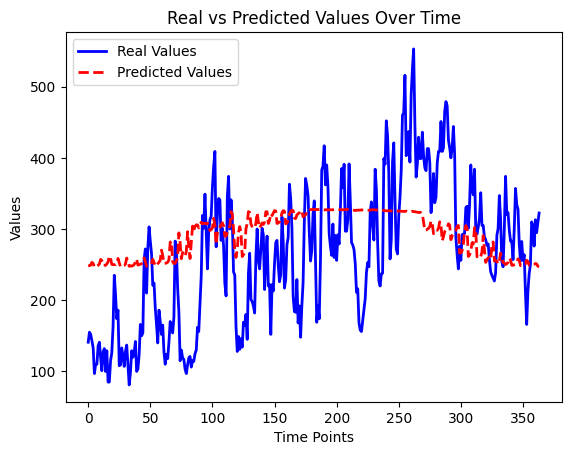

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq7_Hospital13_LastEpoch:
12/12 [==============================] - 1s 4ms/step


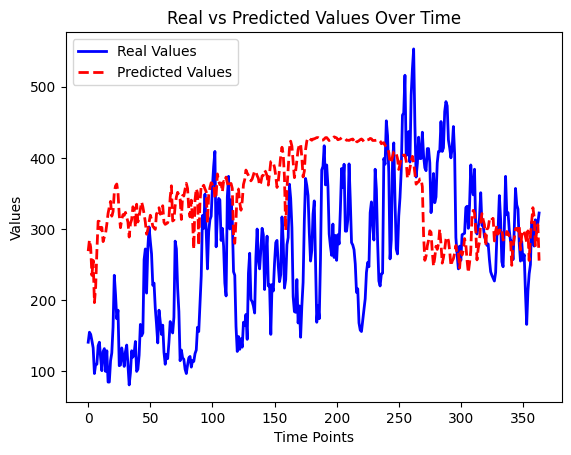

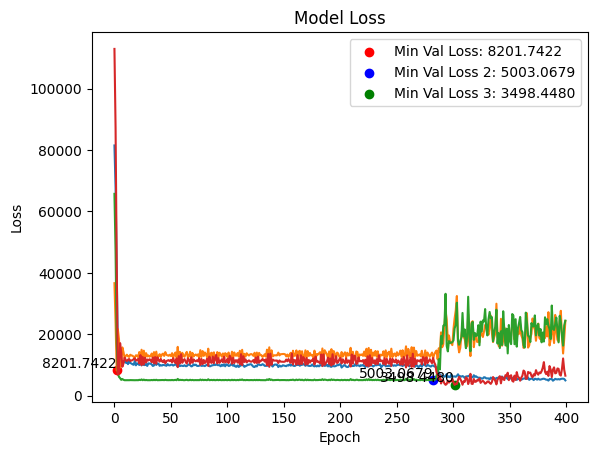

In [ ]:
# Train Model for Model_4 using seq = 7
seq = 7
for i in range (1,14):
  print('↔ ' * 60)
  print(f'TRAINING MODEL_4 WITH SEQ={seq} FOR HOSPITAL={i}')
  hospital = i
  firstLabel = datetime(2019, 1, seq)
  if hospital == 7: firstLabel = datetime(2020, 12, 23+seq)
  lastLabel = datetime(2022, 12, 31)
  generated_DF=generateDataset_WithoutDrugFeature(firstLabel,lastLabel,hospital,seq)
  generated_labels = generateLabels(firstLabel, lastLabel,hospital)

  m,h,cb=Model_4(generated_DF,generated_labels ,1 ,ModelName = f'/content/drive/MyDrive/Hamedan Models/Model 4/M4_seq{seq}_Hospital{hospital}',trainRatio = 0.75, plotModel=True , Epochs = 400)
  print()
  PlotUsingValidationData(h,cb)
  del generated_DF,generated_labels,m,h,cb

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=1
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 773.3719
loss 1: 53.66339874267578
loss 2: 208.8406219482422
loss 3: 592.971435546875
Average Loss (Loss2*1.15 and Loss3*1.30): 354.8976600646973
9/9 [==============================] - 9s 209ms/step - loss: 728.7939
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 324.6286

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 307.3338
loss 1: 417.90582275390625
loss 2: 280.3936767578125
loss 3: 270.4855041503906
Average Loss (Loss2*1.15 and Loss3*1.30): 363.9965688069662
9/9 [==============================] - 0s 57ms/step - loss: 302.8616
Epoch 3/400
8/9 [=========================>....] - ETA: 0s - loss: 266.8237
loss 1: 151.8365020751953
loss 2: 178.44891357421875
loss 3: 389.4660339355469
Average Loss (Loss2*1.15 and Loss3*1.30): 287.78619893391925
9/9 [==============================] - 1s 161ms/step - loss: 267.9906
Epoch 4/400
6/9 [===================>..........] - ETA: 0s - loss: 283.7954
loss 1: 211.66473388671875
loss 2: 191.44509887695312
loss 3: 339.4198913574219
Average Loss (Loss2*1.15 and Loss3*1.30): 291.0241521199544
9/9 [==============================] - 1s 69ms/step - loss: 275.2379
Epoch 5/400
7/9 [======================>.......] - ETA: 0s - loss: 246.3504
loss 1: 244.88833618164062
loss 2: 202.22799682617188
loss 3: 319.99359130859375


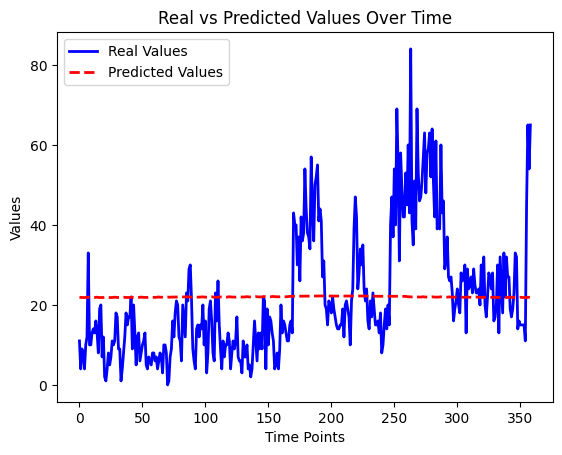

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital1_LastEpoch:
12/12 [==============================] - 1s 5ms/step


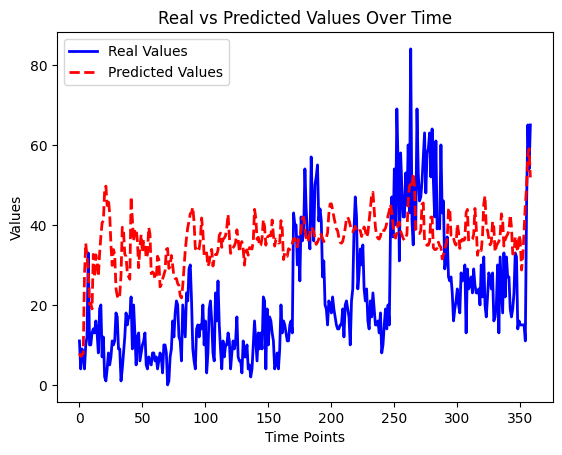

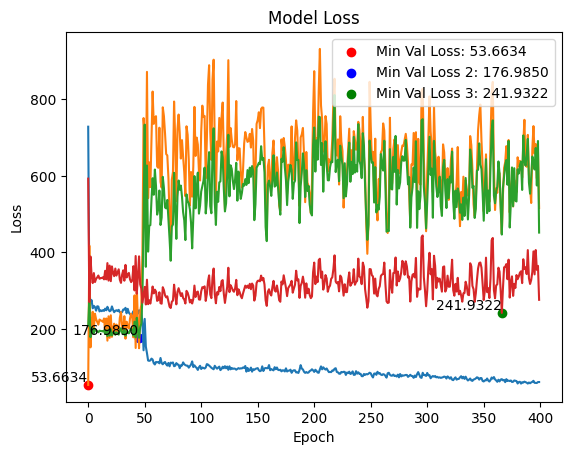

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=2
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 2958.5952
loss 1: 340.48345947265625
loss 2: 445.6682434082031
loss 3: 1063.3941650390625
Average Loss (Loss2*1.15 and Loss3*1.30): 745.138117980957
9/9 [==============================] - 7s 144ms/step - loss: 2894.1094
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 1865.0098

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 1615.1399
loss 1: 811.5075073242188
loss 2: 597.0530395507812
loss 3: 320.1455078125
Average Loss (Loss2*1.15 and Loss3*1.30): 638.102554321289
9/9 [==============================] - 0s 58ms/step - loss: 1521.5498
Epoch 3/400
9/9 [==============================] - ETA: 0s - loss: 1155.3707
loss 1: 971.62939453125
loss 2: 725.07958984375
loss 3: 358.41534423828125
Average Loss (Loss2*1.15 and Loss3*1.30): 757.1369567871094
9/9 [==============================] - 0s 48ms/step - loss: 1155.3707
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 1011.9345
loss 1: 590.7487182617188
loss 2: 429.6463623046875
loss 3: 302.08612060546875
Average Loss (Loss2*1.15 and Loss3*1.30): 492.5179972330729
9/9 [==============================] - 1s 61ms/step - loss: 1036.8029
Epoch 5/400
8/9 [=========================>....] - ETA: 0s - loss: 1087.4603
loss 1: 684.5188598632812
loss 2: 499.0417175292969
loss 3: 303.2686767578125
Average 

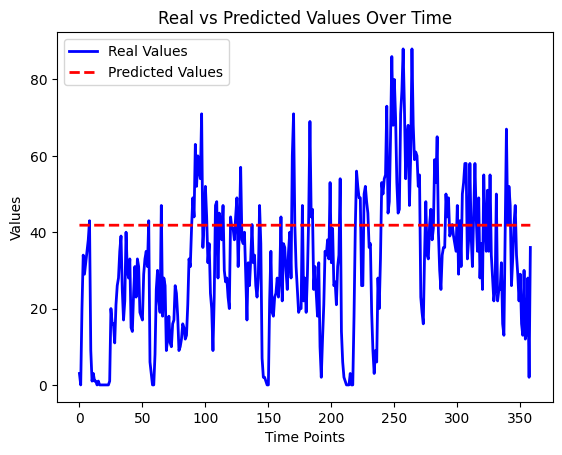

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital2_LastEpoch:
12/12 [==============================] - 1s 5ms/step


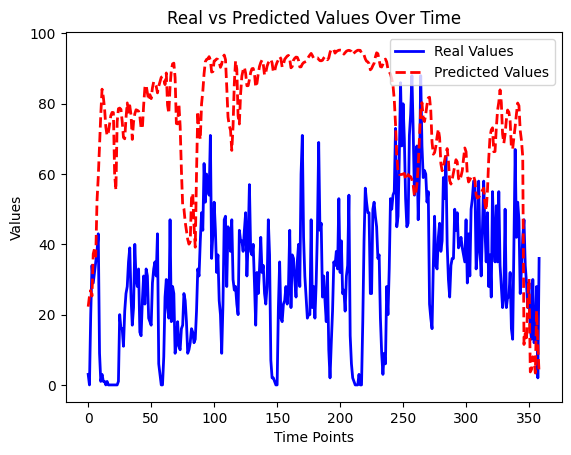

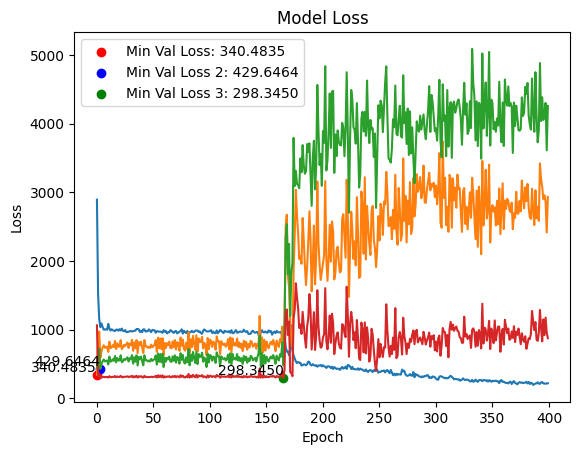

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=3
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 12982.3076
loss 1: 5383.998046875
loss 2: 8170.2705078125
loss 3: 20690.1953125
Average Loss (Loss2*1.15 and Loss3*1.30): 13892.354345703125
9/9 [==============================] - 6s 220ms/step - loss: 12630.4131
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 10458.5137

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 9676.0684 
loss 1: 3744.484375
loss 2: 4858.3623046875
loss 3: 13300.6845703125
Average Loss (Loss2*1.15 and Loss3*1.30): 8874.163655598959
9/9 [==============================] - 1s 65ms/step - loss: 9297.9199
Epoch 3/400
7/9 [======================>.......] - ETA: 0s - loss: 4965.0874
loss 1: 6010.69384765625
loss 2: 3747.8134765625
loss 3: 3958.61474609375
Average Loss (Loss2*1.15 and Loss3*1.30): 5155.626171874999
9/9 [==============================] - 1s 66ms/step - loss: 4643.6099
Epoch 4/400
8/9 [=========================>....] - ETA: 0s - loss: 3518.0227
loss 1: 7236.98974609375
loss 2: 4354.18212890625
loss 3: 3053.8076171875
Average Loss (Loss2*1.15 and Loss3*1.30): 5404.749698893229
9/9 [==============================] - 0s 45ms/step - loss: 3517.2373
Epoch 5/400
9/9 [==============================] - ETA: 0s - loss: 3140.8145
loss 1: 4788.53173828125
loss 2: 3334.564208984375
loss 3: 5517.2275390625
Average Loss (Loss2*1

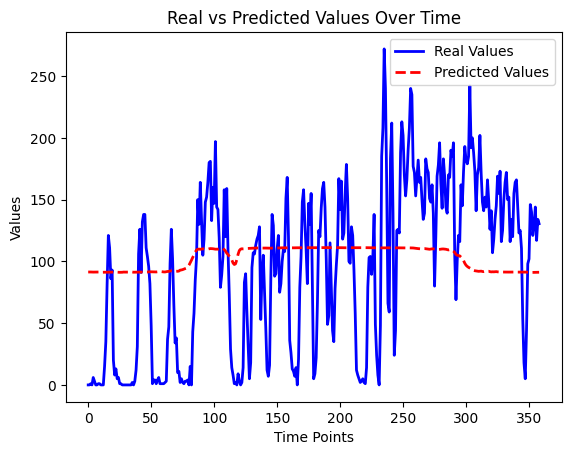

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital3_LastEpoch:
12/12 [==============================] - 1s 6ms/step


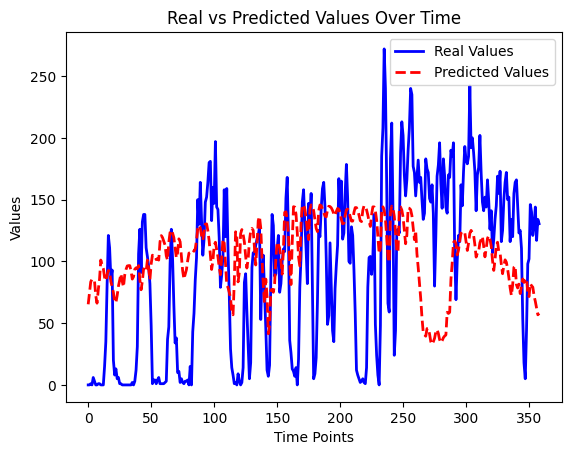

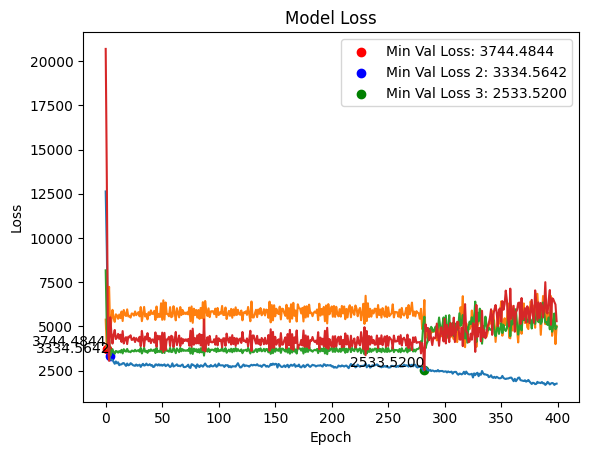

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=4
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 22.6250
loss 1: 4.355141639709473
loss 2: 24.572128295898438
loss 3: 6.718989372253418
Average Loss (Loss2*1.15 and Loss3*1.30): 13.782591787974036
9/9 [==============================] - 7s 163ms/step - loss: 22.1190
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 18.1756

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 18.5581
loss 1: 4.401439189910889
loss 2: 23.351247787475586
loss 3: 6.415116310119629
Average Loss (Loss2*1.15 and Loss3*1.30): 13.198341782887775
9/9 [==============================] - 0s 55ms/step - loss: 19.1241
Epoch 3/400
8/9 [=========================>....] - ETA: 0s - loss: 18.2140
loss 1: 3.373933792114258
loss 2: 30.67623519897461
loss 3: 11.14406681060791
Average Loss (Loss2*1.15 and Loss3*1.30): 17.712963708241777
9/9 [==============================] - 0s 43ms/step - loss: 17.8679
Epoch 4/400
8/9 [=========================>....] - ETA: 0s - loss: 18.5622
loss 1: 3.0027782917022705
loss 2: 28.59206199645996
loss 3: 9.18806266784668
Average Loss (Loss2*1.15 and Loss3*1.30): 15.94271035194397
9/9 [==============================] - 0s 44ms/step - loss: 18.5691
Epoch 5/400
8/9 [=========================>....] - ETA: 0s - loss: 17.7999
loss 1: 3.0096139907836914
loss 2: 28.068740844726562
loss 3: 8.722691535949707
Average Los

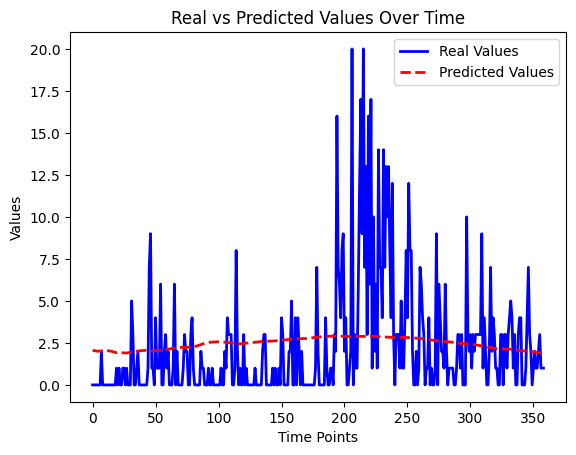

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital4_LastEpoch:
12/12 [==============================] - 1s 7ms/step


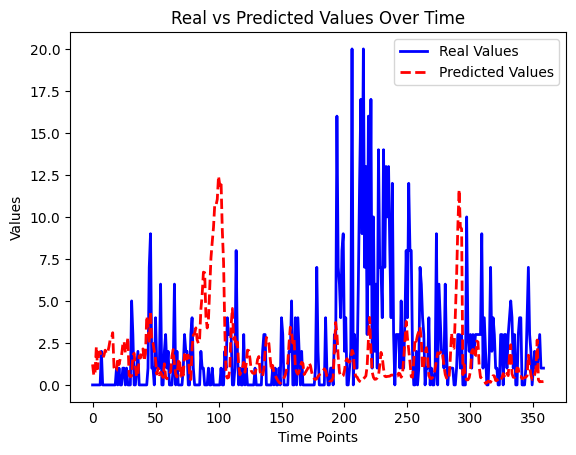

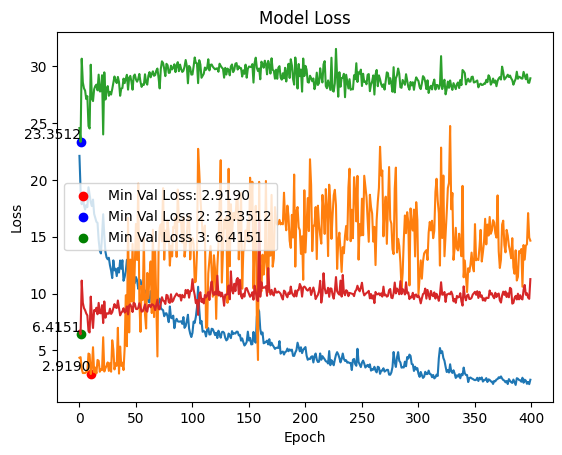

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=5
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 434.0253
loss 1: 248.885986328125
loss 2: 723.9036254882812
loss 3: 771.62646484375
Average Loss (Loss2*1.15 and Loss3*1.30): 694.8298533121744
9/9 [==============================] - 8s 252ms/step - loss: 403.2385
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 199.5923

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 201.7719
loss 1: 273.9771728515625
loss 2: 772.0316772460938
loss 3: 798.306640625
Average Loss (Loss2*1.15 and Loss3*1.30): 733.20407816569
9/9 [==============================] - 0s 58ms/step - loss: 202.1307
Epoch 3/400
7/9 [======================>.......] - ETA: 0s - loss: 187.7407
loss 1: 295.9459228515625
loss 2: 812.3848266601562
loss 3: 821.5330810546875
Average Loss (Loss2*1.15 and Loss3*1.30): 766.060492960612
9/9 [==============================] - 0s 50ms/step - loss: 183.3096
Epoch 4/400
9/9 [==============================] - ETA: 0s - loss: 180.1498
loss 1: 227.0857391357422
loss 2: 679.844482421875
loss 3: 748.2607421875
Average Loss (Loss2*1.15 and Loss3*1.30): 660.5486195882162
9/9 [==============================] - 1s 71ms/step - loss: 180.1498
Epoch 5/400
8/9 [=========================>....] - ETA: 0s - loss: 176.9677
loss 1: 295.740478515625
loss 2: 811.9693603515625
loss 3: 821.2974853515625
Average Loss (Loss2*1

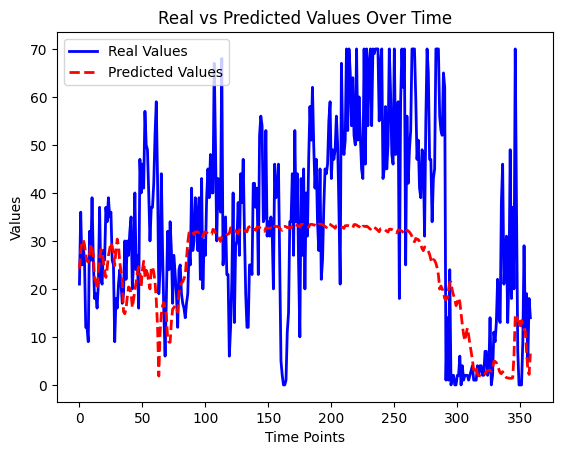

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital5_LastEpoch:
12/12 [==============================] - 1s 5ms/step


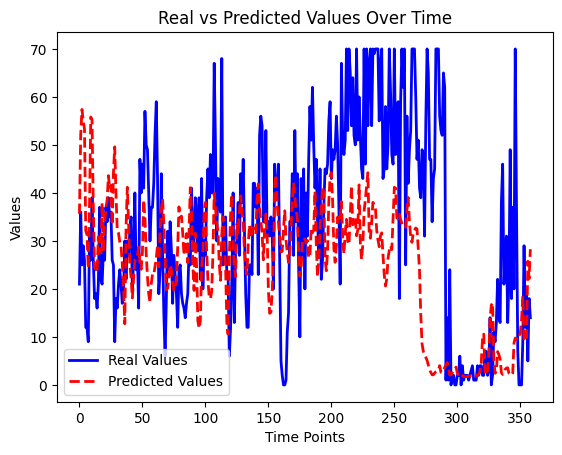

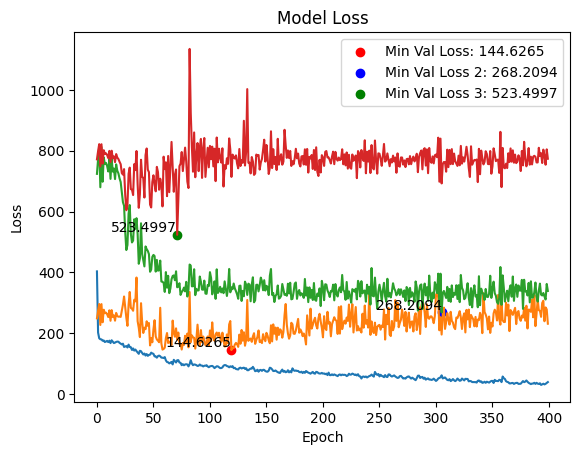

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=6
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 90.3762 
loss 1: 57.83937454223633
loss 2: 61.133949279785156
loss 3: 73.08495330810547
Average Loss (Loss2*1.15 and Loss3*1.30): 74.38461850484212
9/9 [==============================] - 7s 210ms/step - loss: 82.3738
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 40.9284

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 40.1103
loss 1: 20.93464469909668
loss 2: 32.065765380859375
loss 3: 32.12167739868164
Average Loss (Loss2*1.15 and Loss3*1.30): 33.18948516845703
9/9 [==============================] - 1s 73ms/step - loss: 39.7635
Epoch 3/400
7/9 [======================>.......] - ETA: 0s - loss: 36.1329
loss 1: 35.401893615722656
loss 2: 42.713172912597656
loss 3: 48.57172393798828
Average Loss (Loss2*1.15 and Loss3*1.30): 49.221761194864904
9/9 [==============================] - 1s 61ms/step - loss: 36.0281
Epoch 4/400
9/9 [==============================] - ETA: 0s - loss: 36.1254
loss 1: 27.820531845092773
loss 2: 36.90489959716797
loss 3: 40.06861877441406
Average Loss (Loss2*1.15 and Loss3*1.30): 40.78345692952474
9/9 [==============================] - 1s 62ms/step - loss: 36.1254
Epoch 5/400
7/9 [======================>.......] - ETA: 0s - loss: 34.8006
loss 1: 31.748781204223633
loss 2: 39.865169525146484
loss 3: 44.497894287109375
Average 

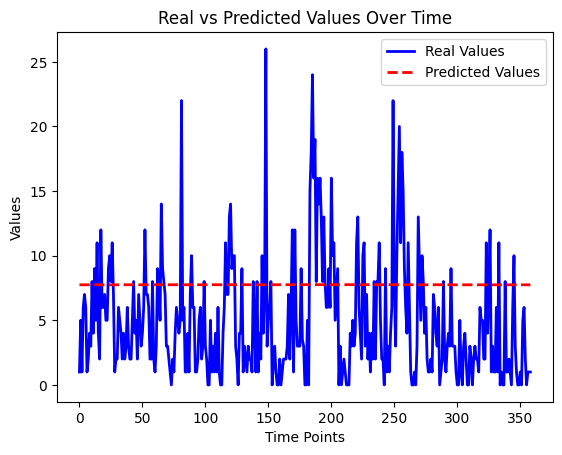

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital6_LastEpoch:
12/12 [==============================] - 1s 6ms/step


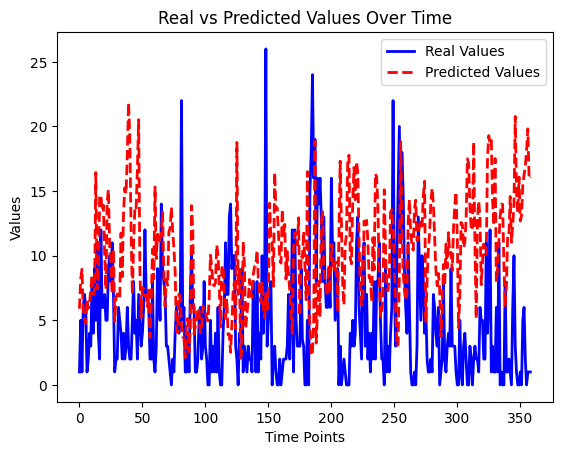

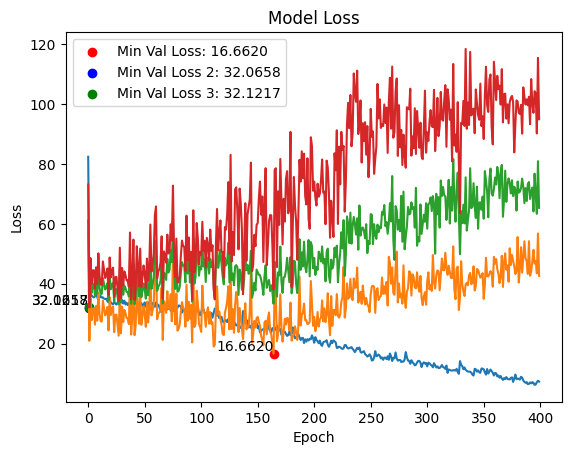

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=7
Train shapes:
(531, 28, 14) (531,)

Test shapes:
(177, 28, 14) (177,)

Validation shapes:
(58, 28, 14) (58,)
(58, 28, 14) (58,)
(61, 28, 14) (61,)
Epoch 1/400
4/5 [=======================>......] - ETA: 0s - loss: 65.9526 
loss 1: 51.660316467285156
loss 2: 19.315122604370117
loss 3: 13.660828590393066
Average Loss (Loss2*1.15 and Loss3*1.30): 30.54392820994059
5/5 [==============================] - 7s 258ms/step - loss: 64.6655
Epoch 2/400
4/5 [=======================>......] - ETA: 0s - loss: 38.2437

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(



loss 1: 50.53652572631836
loss 2: 20.724267959594727
loss 3: 15.80268669128418
Average Loss (Loss2*1.15 and Loss3*1.30): 31.637642192840577
5/5 [==============================] - 0s 76ms/step - loss: 38.8209
Epoch 3/400
4/5 [=======================>......] - ETA: 0s - loss: 38.2200
loss 1: 52.62578201293945
loss 2: 18.231128692626953
loss 3: 12.4533052444458
Average Loss (Loss2*1.15 and Loss3*1.30): 29.926958942413325
5/5 [==============================] - 0s 92ms/step - loss: 37.8224
Epoch 4/400
4/5 [=======================>......] - ETA: 0s - loss: 35.5100
loss 1: 49.90082931518555
loss 2: 21.80010223388672
loss 3: 17.155637741088867
Average Loss (Loss2*1.15 and Loss3*1.30): 32.42442531585693
5/5 [==============================] - 0s 71ms/step - loss: 36.5707
Epoch 5/400
4/5 [=======================>......] - ETA: 0s - loss: 37.7660
loss 1: 50.00463104248047
loss 2: 21.609947204589844
loss 3: 16.925565719604492
Average Loss (Loss2*1.15 and Loss3*1.30): 32.286435254414876
5/5 [======

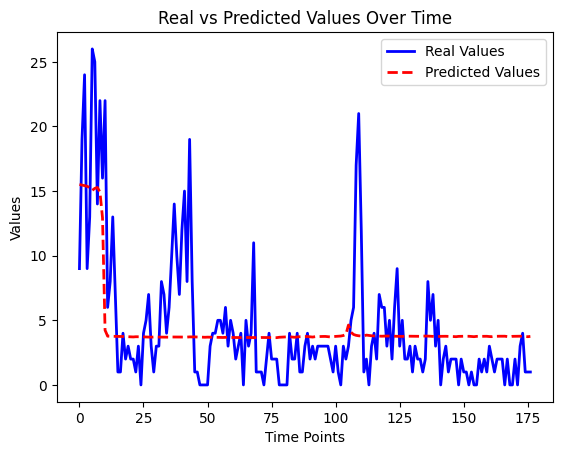

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital7_LastEpoch:
6/6 [==============================] - 1s 9ms/step


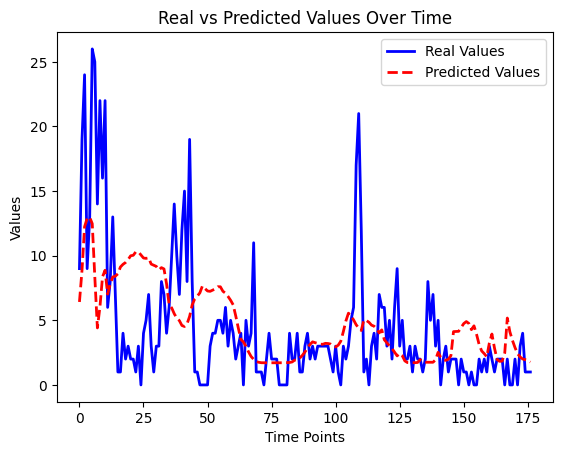

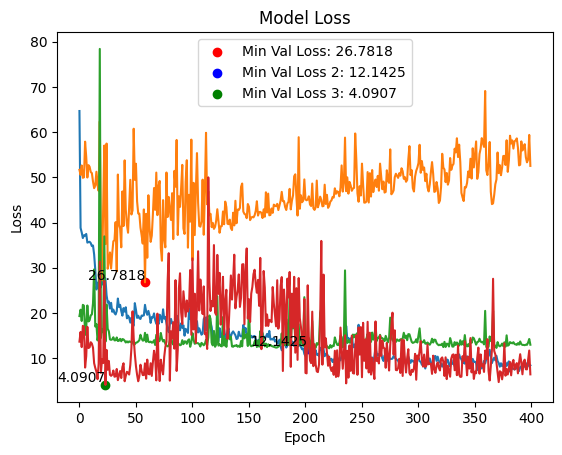

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=8
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 326.4828
loss 1: 54.648719787597656
loss 2: 28.189271926879883
loss 3: 23.85286521911621
Average Loss (Loss2*1.15 and Loss3*1.30): 39.35836909612019
9/9 [==============================] - 8s 306ms/step - loss: 300.5934
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 264.3978

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 278.8857
loss 1: 68.38066101074219
loss 2: 27.01388168334961
loss 3: 21.546615600585938
Average Loss (Loss2*1.15 and Loss3*1.30): 42.485741742451985
9/9 [==============================] - 0s 55ms/step - loss: 257.7216
Epoch 3/400
7/9 [======================>.......] - ETA: 0s - loss: 265.4073
loss 1: 55.76765441894531
loss 2: 23.875049591064453
loss 3: 19.128314971923828
Average Loss (Loss2*1.15 and Loss3*1.30): 36.030256970723464
9/9 [==============================] - 0s 59ms/step - loss: 258.6203
Epoch 4/400
8/9 [=========================>....] - ETA: 0s - loss: 241.0237
loss 1: 57.72038269042969
loss 2: 23.382326126098633
loss 3: 18.458580017089844
Average Loss (Loss2*1.15 and Loss3*1.30): 36.20207058588664
9/9 [==============================] - 0s 50ms/step - loss: 254.4466
Epoch 5/400
8/9 [=========================>....] - ETA: 0s - loss: 258.9343
loss 1: 55.08902359008789
loss 2: 24.505706787109375
loss 3: 19.857072830200195


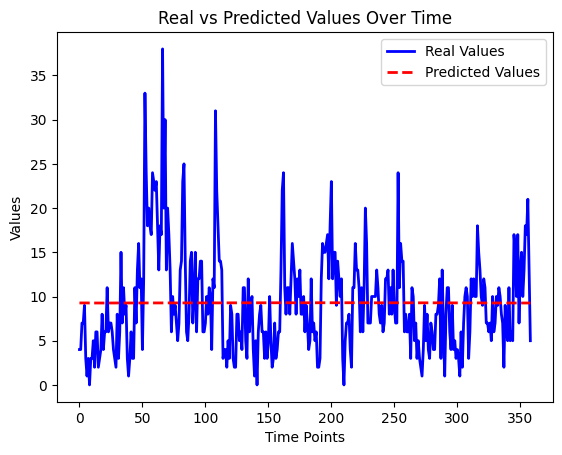

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital8_LastEpoch:
12/12 [==============================] - 1s 6ms/step


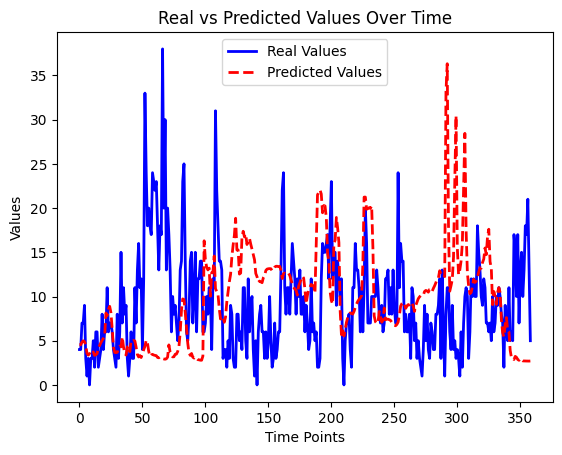

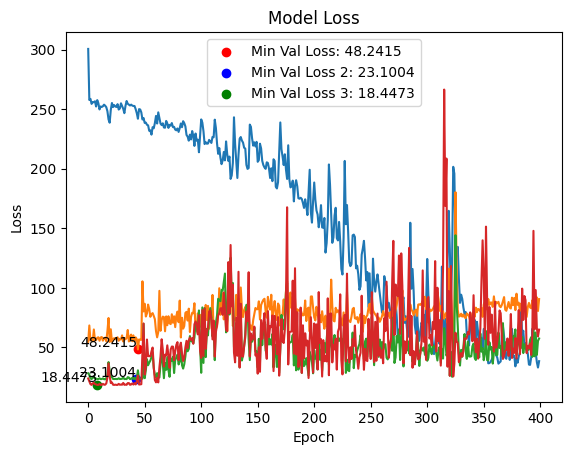

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=9
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 240.5378
loss 1: 124.57786560058594
loss 2: 295.1522216796875
loss 3: 286.88372802734375
Average Loss (Loss2*1.15 and Loss3*1.30): 278.9839223225911
9/9 [==============================] - 7s 209ms/step - loss: 227.3619
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 99.9701 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 85.5256
loss 1: 179.71157836914062
loss 2: 100.61601257324219
loss 3: 86.88790130615234
Average Loss (Loss2*1.15 and Loss3*1.30): 136.12475484212237
9/9 [==============================] - 1s 79ms/step - loss: 83.6394
Epoch 3/400
8/9 [=========================>....] - ETA: 0s - loss: 60.1634
loss 1: 116.71173095703125
loss 2: 171.442138671875
loss 3: 160.5584716796875
Average Loss (Loss2*1.15 and Loss3*1.30): 174.1987345377604
9/9 [==============================] - 1s 82ms/step - loss: 60.2336
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 60.1262
loss 1: 129.44900512695312
loss 2: 138.7384796142578
loss 3: 126.8890151977539
Average Loss (Loss2*1.15 and Loss3*1.30): 151.3179921468099
9/9 [==============================] - 1s 63ms/step - loss: 59.6230
Epoch 5/400
8/9 [=========================>....] - ETA: 0s - loss: 54.4892
loss 1: 133.7574462890625
loss 2: 132.3106689453125
loss 3: 120.23410034179688
Average Los

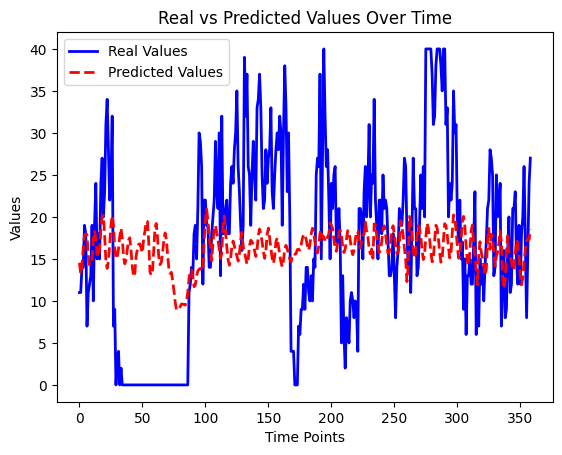

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital9_LastEpoch:
12/12 [==============================] - 1s 5ms/step


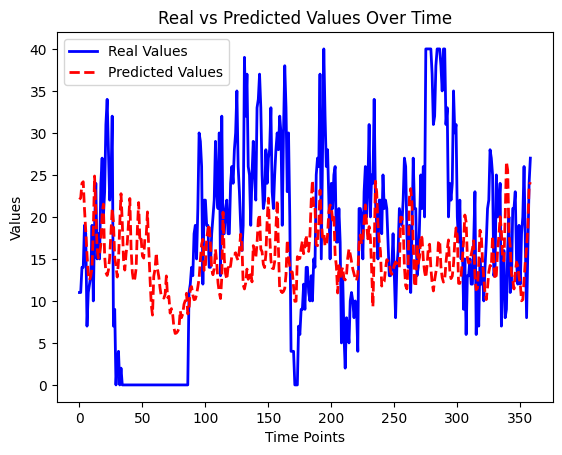

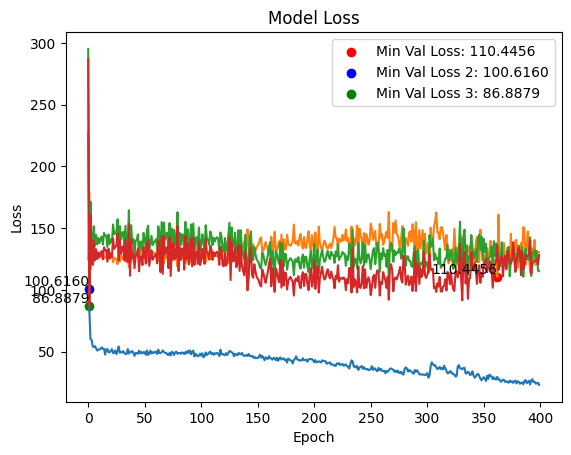

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=10
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
9/9 [==============================] - ETA: 0s - loss: 822.8519
loss 1: 370.29461669921875
loss 2: 1067.0762939453125
loss 3: 941.9105224609375
Average Loss (Loss2*1.15 and Loss3*1.30): 940.6386779785156
9/9 [==============================] - 7s 213ms/step - loss: 822.8519
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 417.2676

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 375.2531
loss 1: 121.74552917480469
loss 2: 299.9007568359375
loss 3: 318.62060546875
Average Loss (Loss2*1.15 and Loss3*1.30): 293.61272888183595
9/9 [==============================] - 1s 66ms/step - loss: 385.4363
Epoch 3/400
7/9 [======================>.......] - ETA: 0s - loss: 345.7244
loss 1: 162.04641723632812
loss 2: 615.8309326171875
loss 3: 558.0687866210938
Average Loss (Loss2*1.15 and Loss3*1.30): 531.9138041178386
9/9 [==============================] - 0s 49ms/step - loss: 337.1569
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 342.4218
loss 1: 138.0792694091797
loss 2: 538.7250366210938
loss 3: 495.7092590332031
Average Loss (Loss2*1.15 and Loss3*1.30): 467.3450327555338
9/9 [==============================] - 0s 48ms/step - loss: 343.7166
Epoch 5/400
7/9 [======================>.......] - ETA: 0s - loss: 343.0784
loss 1: 121.34532928466797
loss 2: 466.66131591796875
loss 3: 438.99859619140625
Avera

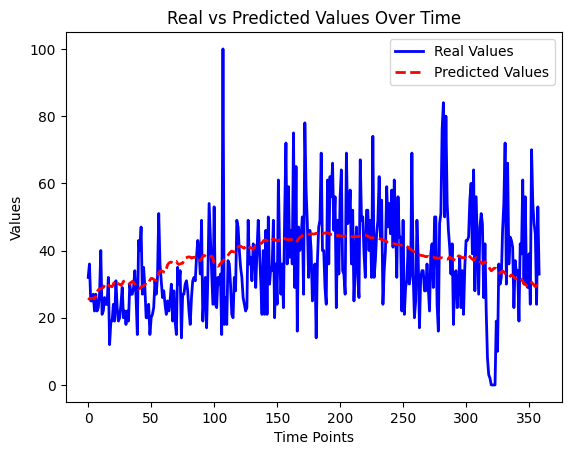

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital10_LastEpoch:
12/12 [==============================] - 1s 7ms/step


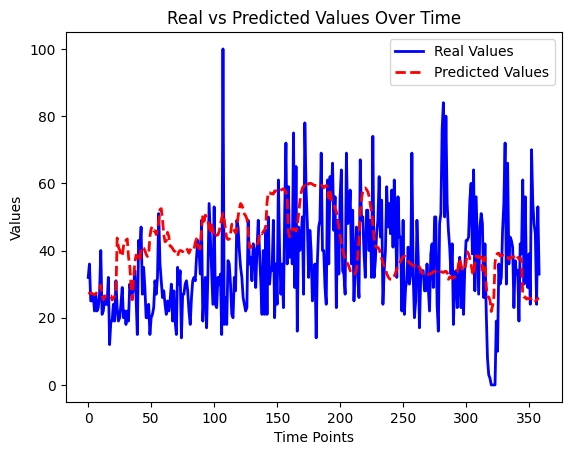

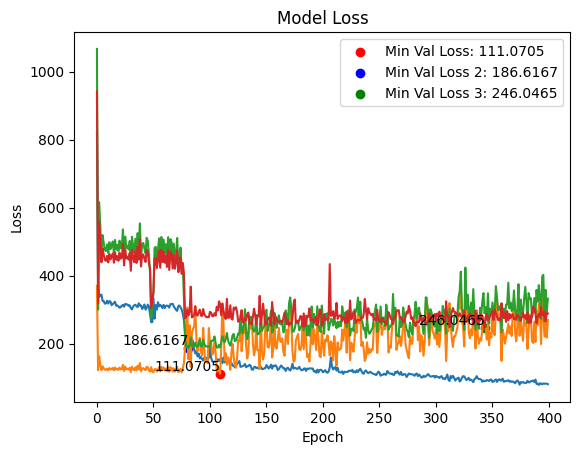

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=11
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
9/9 [==============================] - ETA: 0s - loss: 50.2242
loss 1: 45.124717712402344
loss 2: 37.4937858581543
loss 3: 34.47453308105469
Average Loss (Loss2*1.15 and Loss3*1.30): 44.35315481821696
9/9 [==============================] - 7s 160ms/step - loss: 50.2242
Epoch 2/400
4/9 [============>.................] - ETA: 0s - loss: 35.9776

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


7/9 [======================>.......] - ETA: 0s - loss: 35.8046
loss 1: 47.2148551940918
loss 2: 28.41669464111328
loss 3: 28.251632690429688
Average Loss (Loss2*1.15 and Loss3*1.30): 38.873725509643556
9/9 [==============================] - 1s 63ms/step - loss: 34.3781
Epoch 3/400
9/9 [==============================] - ETA: 0s - loss: 33.6198
loss 1: 46.36166000366211
loss 2: 30.13035774230957
loss 3: 29.333515167236328
Average Loss (Loss2*1.15 and Loss3*1.30): 39.71504704157511
9/9 [==============================] - 0s 44ms/step - loss: 33.6198
Epoch 4/400
9/9 [==============================] - ETA: 0s - loss: 34.1824
loss 1: 46.439781188964844
loss 2: 29.941730499267578
loss 3: 29.21099281311035
Average Loss (Loss2*1.15 and Loss3*1.30): 39.61568730672201
9/9 [==============================] - 0s 49ms/step - loss: 34.1824
Epoch 5/400
9/9 [==============================] - ETA: 0s - loss: 33.5920
loss 1: 47.970123291015625
loss 2: 27.28969383239746
loss 3: 27.62109375
Average Loss (Los

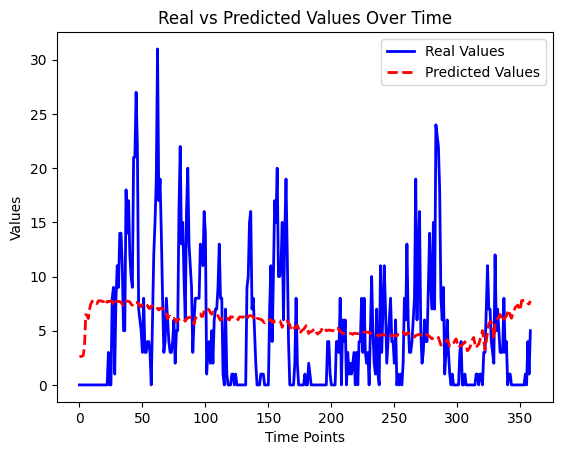

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital11_LastEpoch:
12/12 [==============================] - 1s 5ms/step


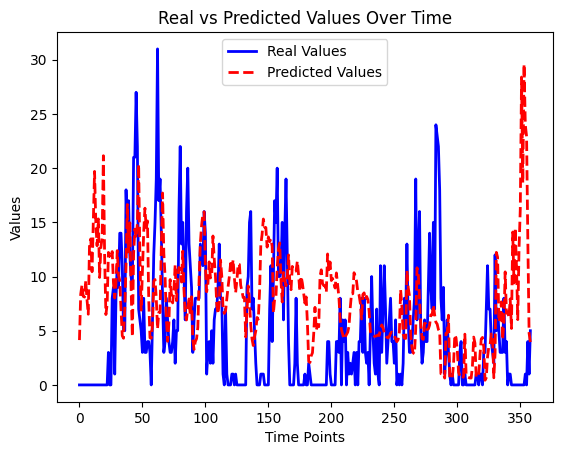

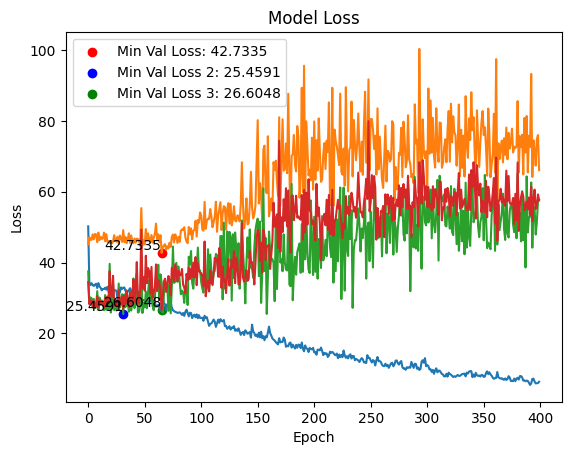

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=12
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
9/9 [==============================] - ETA: 0s - loss: 3.4064
loss 1: 0.7510343790054321
loss 2: 1.8901081085205078
loss 3: 47.70207214355469
Average Loss (Loss2*1.15 and Loss3*1.30): 21.64578416347504
9/9 [==============================] - 5s 146ms/step - loss: 3.4064
Epoch 2/400
5/9 [===============>..............] - ETA: 0s - loss: 2.7365

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


9/9 [==============================] - ETA: 0s - loss: 3.0776
loss 1: 0.2734529674053192
loss 2: 1.648908019065857
loss 3: 49.9270133972168
Average Loss (Loss2*1.15 and Loss3*1.30): 22.358271535237634
9/9 [==============================] - 0s 50ms/step - loss: 3.0776
Epoch 3/400
9/9 [==============================] - ETA: 0s - loss: 2.7062
loss 1: 0.2501390874385834
loss 2: 6.35211181640625
loss 3: 50.08848571777344
Average Loss (Loss2*1.15 and Loss3*1.30): 24.223366369803745
9/9 [==============================] - 0s 45ms/step - loss: 2.7062
Epoch 4/400
9/9 [==============================] - ETA: 0s - loss: 3.1814
loss 1: 0.23042523860931396
loss 2: 0.007878159172832966
loss 3: 52.11326599121094
Average Loss (Loss2*1.15 and Loss3*1.30): 22.662243636744098
9/9 [==============================] - 0s 45ms/step - loss: 3.1814
Epoch 5/400
9/9 [==============================] - ETA: 0s - loss: 3.4758
loss 1: 0.3491223156452179
loss 2: 0.17790217697620392
loss 3: 50.223915100097656
Average Los

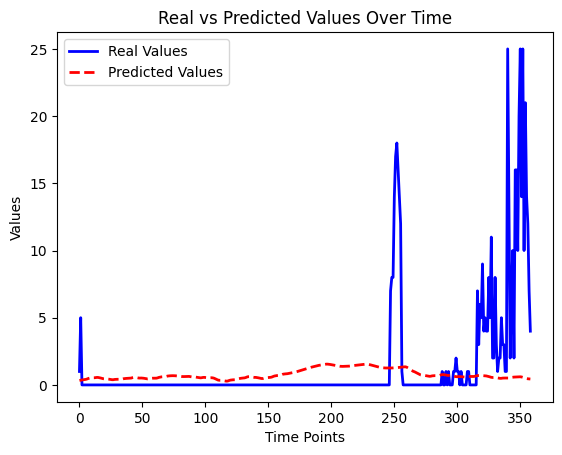

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital12_LastEpoch:
12/12 [==============================] - 1s 7ms/step


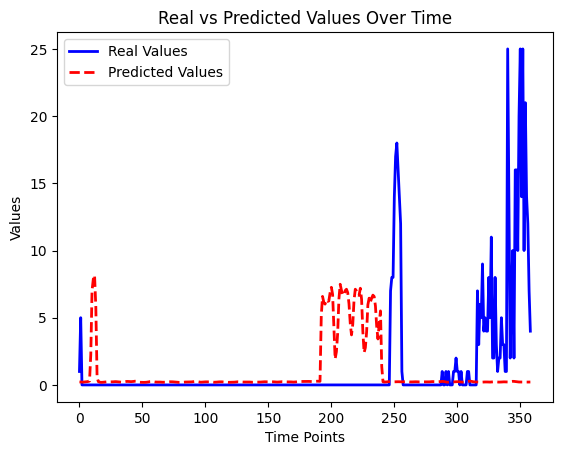

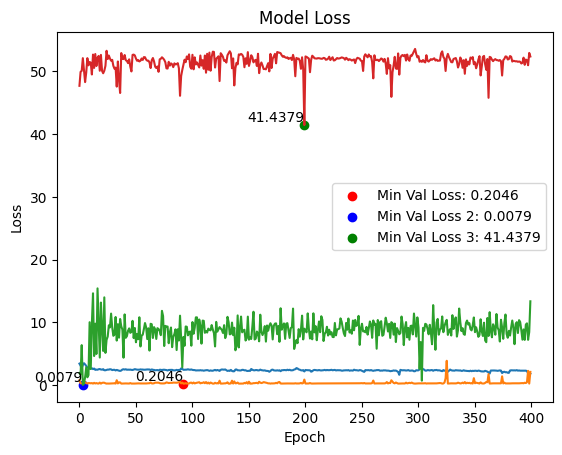

↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ ↔ 
TRAINING MODEL_4 WITH SEQ=28 FOR HOSPITAL=13
Train shapes:
(1075, 28, 14) (1075,)

Test shapes:
(359, 28, 14) (359,)

Validation shapes:
(118, 28, 14) (118,)
(118, 28, 14) (118,)
(123, 28, 14) (123,)
Epoch 1/400
7/9 [======================>.......] - ETA: 0s - loss: 80836.2891
loss 1: 37135.34765625
loss 2: 68712.9140625
loss 3: 112777.578125
Average Loss (Loss2*1.15 and Loss3*1.30): 87588.68346354167
9/9 [==============================] - 7s 141ms/step - loss: 79295.0312
Epoch 2/400
5/9 [===============>..............] - ETA: 0s - loss: 70699.8750

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


8/9 [=========================>....] - ETA: 0s - loss: 67987.5312
loss 1: 25624.744140625
loss 2: 51370.62890625
loss 3: 89883.9296875
Average Loss (Loss2*1.15 and Loss3*1.30): 67183.35865885417
9/9 [==============================] - 1s 61ms/step - loss: 67811.0938
Epoch 3/400
8/9 [=========================>....] - ETA: 0s - loss: 46164.5156
loss 1: 10017.41796875
loss 2: 22984.56640625
loss 3: 49337.08984375
Average Loss (Loss2*1.15 and Loss3*1.30): 33529.29537760417
9/9 [==============================] - 1s 62ms/step - loss: 45829.3359
Epoch 4/400
7/9 [======================>.......] - ETA: 0s - loss: 18766.3066
loss 1: 16343.423828125
loss 2: 5337.255859375
loss 3: 8876.2802734375
Average Loss (Loss2*1.15 and Loss3*1.30): 11340.144140625
9/9 [==============================] - 1s 65ms/step - loss: 17282.2441
Epoch 5/400
8/9 [=========================>....] - ETA: 0s - loss: 13970.0918
loss 1: 19688.71875
loss 2: 6174.85986328125
loss 3: 7327.51513671875
Average Loss (Loss2*1.15 and L

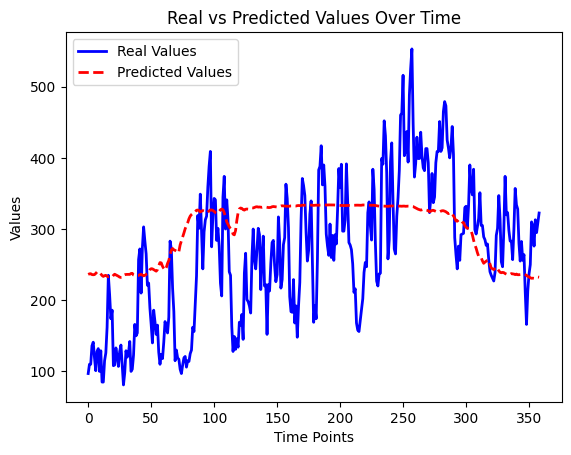

Testing model Using /content/drive/MyDrive/Hamedan Models/Model 4/M4_seq28_Hospital13_LastEpoch:
12/12 [==============================] - 1s 6ms/step


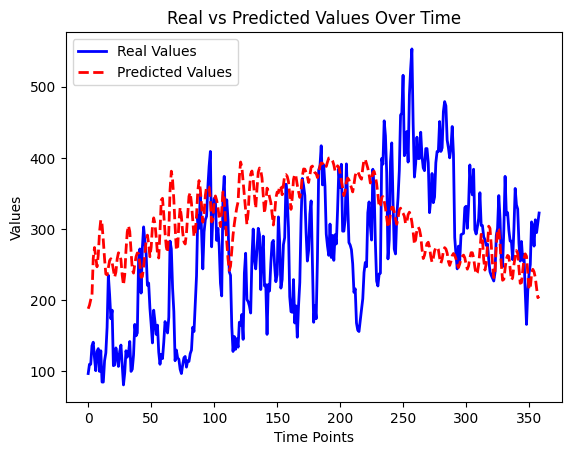

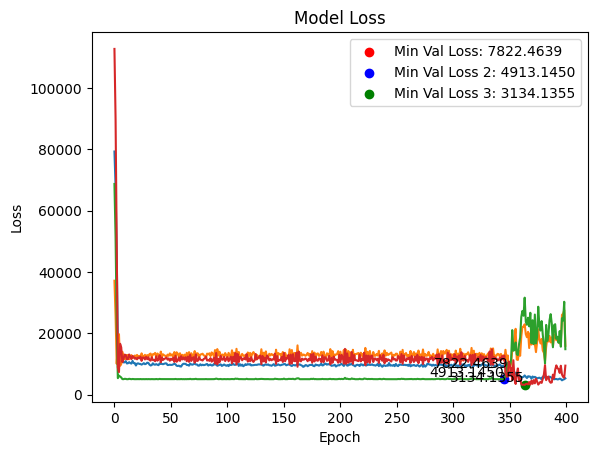

In [ ]:
# Train Model for Model_4 using seq = 28
seq = 28
for i in range (1,14):
  print('↔ ' * 60)
  print(f'TRAINING MODEL_4 WITH SEQ={seq} FOR HOSPITAL={i}')
  hospital = i
  firstLabel = datetime(2019, 1, seq)
  if hospital == 7: firstLabel = datetime(2021, 1, 23)
  lastLabel = datetime(2022, 12, 31)
  generated_DF=generateDataset_WithoutDrugFeature(firstLabel,lastLabel,hospital,seq)
  generated_labels = generateLabels(firstLabel, lastLabel,hospital)

  m,h,cb=Model_4(generated_DF,generated_labels ,1 ,ModelName = f'/content/drive/MyDrive/Hamedan Models/Model 4/M4_seq{seq}_Hospital{hospital}',trainRatio = 0.75, plotModel=True , Epochs = 400)
  print()
  PlotUsingValidationData(h,cb)
  del generated_DF,generated_labels,m,h,cb